# Semantic Segmentation Exercises

Based on exercise from DLCV 2019 by ASM Shihavuddin and Ricardo Cruz

The data used for this exercise stems from the ISBI cell tracking challenge http://celltrackingchallenge.net/. The data loader below assumes that you are working on the HPC machines with the data located at  

/dtu/datasets1/02516/phc_data

If this is not the case, you will have to adapt the data loader accordingly.

These are microscopy images taken over time of different cells that move around in the image plane; the images you will be working with have been processed to contain only a single cell each.

Have a look at the phc_data folder. It is structured like this:

    images/
        img_00000.jpg
        img_00001.jpg
            ...
    labels
        label_00000.png
        label_00001.png 
            ...
            
We provide you with a class similar to the Hotdog_NotHotdog data loader that will allow you to load the dataset from  /dtu/datasets1/02514/

First, we load some needed libraries

In [26]:
import os
import numpy as np
import glob
import PIL.Image as Image

# pip install torchsummary
import torch
import torch.nn as nn
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torchvision import models
from torchsummary import summary
import torch.optim as optim
import torch.nn.functional as F
from time import time

import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split


Next, the data loader

In [27]:
def load_dataset(train_x, train_y, split=0.2,):
    split_size = int(split * len(train_x))

    train_x, valid_x = train_test_split(train_x, test_size=split_size, random_state=42)
    train_y, valid_y = train_test_split(train_y, test_size=split_size, random_state=42)

    train_x, test_x = train_test_split(train_x, test_size=split_size, random_state=42)
    train_y, test_y = train_test_split(train_y, test_size=split_size, random_state=42)

    return (train_x, train_y), (valid_x, valid_y), (test_x, test_y)

In [28]:
images_path = os.path.join('/Users/szymon/Documents/Projects/nothotdog/DRIVE/training/images/')
masks_path = os.path.join('/Users/szymon/Documents/Projects/nothotdog/DRIVE/training/1st_manual/')
images = []
for img in os.listdir(images_path):
    images.append(images_path + img)

masks = []

for msk in os.listdir(masks_path):
    masks.append(masks_path + msk)
    
images = sorted(images)
masks = sorted(masks)
 

In [29]:
from matplotlib import cm
import cv2


class PhC(torch.utils.data.Dataset):
    def __init__(self, transform, images, masks):
        'Initialization'
        self.transform = transform
       
        self.image_paths = sorted(images)
        self.label_paths = sorted(masks)
        
    def __len__(self):
        'Returns the total number of samples'
        return len(self.image_paths)

    def __getitem__(self, idx):
        'Generates one sample of data'
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]
        
        image = Image.open(image_path)
        label = Image.open(label_path)
        gray = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2GRAY)
        thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11,3)
        Y = self.transform(label)
        X = self.transform(Image.fromarray(thresh))
        return X, Y

In principle, the images could have different sizes. Let's resize them all to $128\times128$ pixels, using the torchvision Resize. 

In [30]:
size = 256
train_transform = transforms.Compose([transforms.Resize((size, size)), 
                                    transforms.ToTensor()])
test_transform = transforms.Compose([transforms.Resize((size, size)), 
                                    transforms.ToTensor()])
(train_x, train_y), (valid_x, valid_y), (test_x, test_y) = load_dataset(images, masks)
batch_size = 6
trainset = PhC(train_transform, train_x, train_y)
train_loader = DataLoader(trainset, batch_size=batch_size, shuffle=True)
testset = PhC(test_transform, test_x, test_y)
test_loader = DataLoader(testset, batch_size=batch_size, shuffle=False)
validset = PhC(train_transform, valid_x, valid_y)
valid_loader = DataLoader(validset, batch_size=batch_size, shuffle=False)

In [31]:
print('Loaded %d training images' % len(trainset))
print('Loaded %d test images' % len(testset))
print('Loaded %d valid images' % len(validset))


Loaded 12 training images
Loaded 4 test images
Loaded 4 valid images


Let's look at some images from the dataset!

torch.Size([6, 1, 256, 256])
tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]])


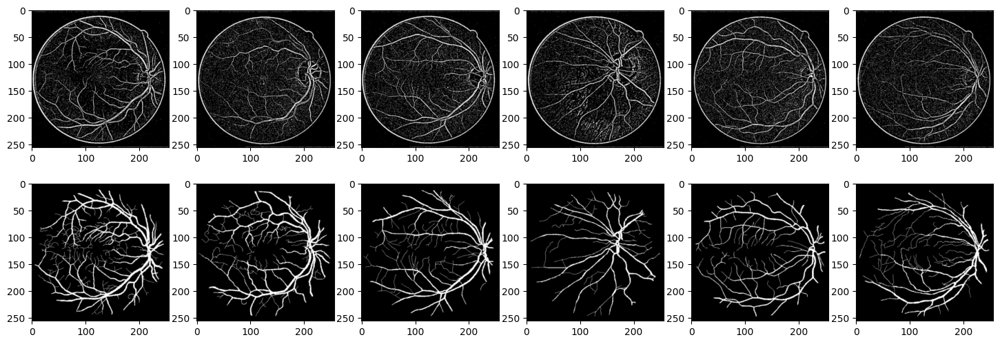

In [7]:
plt.rcParams['figure.figsize'] = [18, 6]

images, labels = next(iter(train_loader))

print(images.shape)
print(labels[0])

for i in range(6):
    plt.subplot(2, 6, i+1)
    plt.imshow(np.swapaxes(np.swapaxes(images[i], 0, 2), 0, 1), cmap='gray')

    plt.subplot(2, 6, i+7)
    plt.imshow(labels[i].squeeze(), cmap='gray')
plt.show()

## Device

Check if GPU is available.

In [8]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cpu


First, we consider a simple encoder decoder network for image registration

## Loss

Now, as important as building the architecture is defining **the optimizer** and **the loss function.**

The **loss function** is what we are trying to minimize. Many can be used. A popular one for binary segmentation is *binary cross-entropy* which is given by

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

where $y$ is the desired output and $\hat y$ is the output of the model. $\sigma$ is the [*logistic* function](https://en.wikipedia.org/wiki/Sigmoid_function) (also called *sigmoid*), which converts a real number $\mathbb R$ into a probability $[0,1]$.

However, this loss suffers from numerical stability problems. Most importantly, $\lim_{x\rightarrow0}\log(x)=\infty$ which leads to optimization unstability. This loss [can be simplified](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits) into the following loss, which is equivalent and is not as prone to numerical unstability:

$$\mathcal L_{BCE} = \hat y - y\hat y + \log\left(1+\exp(-\hat y)\right).$$

In [9]:
def bce_loss(y_real, y_pred):
    return torch.mean(y_pred - y_real*y_pred + torch.log(1 + torch.exp(-y_pred)))

Can you still see situations in which this loss might be unstable? How would you change it?

## Training

We will define the training cycle in a function so we can re-use it.

In [10]:
def train(model, opt, loss_fn, epochs, train_loader, test_loader):
    X_test, Y_test = next(iter(test_loader))

    for epoch in range(epochs):
        tic = time()
        print('* Epoch %d/%d' % (epoch+1, epochs))

        avg_loss = 0
        model.train()  # train mode
        for X_batch, Y_batch in train_loader:
            X_batch = X_batch.to(device)
            Y_batch = Y_batch.to(device)

            # set parameter gradients to zero
            opt.zero_grad()

            # forward
            Y_pred = model(X_batch)
            # Y_pred[Y_pred>=0.5] = 1
            # Y_pred[Y_pred<0.5] = 0

            loss = loss_fn(Y_batch, Y_pred)  # forward-pass
            loss.backward()  # backward-pass
            opt.step()  # update weights

            # calculate metrics to show the user
            avg_loss += loss.item() / len(train_loader)
        toc = time()
        print(' - loss: %f' % avg_loss)

        # show intermediate results
        model.eval()  # testing mode
        Y_hat = F.sigmoid(model(X_test.to(device))).detach().cpu()
        # clear_output(wait=True)
        for k in range(4):
            plt.subplot(3, 4, k+1)
            plt.imshow(np.rollaxis(X_test[k].numpy(), 0, 3), cmap='gray')
            plt.title('Real')
            plt.axis('off')

            plt.subplot(3, 4, k+5)
            # Y_hat[k, 0][Y_hat[k, 0]>=0.5] = 1
            # Y_hat[k, 0][Y_hat[k, 0]<0.5] = 0
            plt.imshow(Y_hat[k, 0], cmap='gray')
            plt.title('Output')
            plt.axis('off')
            print(Y_hat[k, 0])

            plt.subplot(3, 4, k+9)
            plt.imshow(Y_test[k, 0], cmap='gray')
            plt.title('Mask')
            plt.axis('off')
        plt.suptitle('%d / %d - loss: %f' % (epoch+1, epochs, avg_loss))
        plt.show()

## Predict

After the model is trained, you can use this function to predict segmentations for new data:

In [11]:
def predict(model, data):
    model.eval()  # testing mode
    Y_pred = [F.sigmoid(model(X_batch.to(device))) for X_batch, _ in data]
    return np.array(Y_pred)

## Lights. Camera. Action.

Let us instanciate the model and train it.

-----------------------------------------------------------------------------------------

# Other losses

<div style="border-left: solid 6px #d6d6d6; padding: 10px; background-color: #eaeaea">
<b><i>Exercise:</i></b> Implement the following losses:
<ol>
    <li>Probabilistic Dice coefficient</li>
    <li>Focal loss</li>
</ol>
</div>

**1. Dice coefficient:** Given two masks $X$ and $Y$, a common metric to measure the distance between these two masks is given by:

$$D(X,Y)=\frac{2|X\cap Y|}{|X|+|Y|}$$

This function is not differentiable and the loss function <b>must</b> always be differentiable for gradient descent to work. But we can approximate it using:

$$\mathcal L_D(X,Y) = 1-\frac{mean(2X\cdot Y + 1)}{mean(X+Y) + 1},$$
where $X\cdot Y$ is element-wise product of your image of pixel-wise confidences

Implement this loss:

In [12]:
def dice_loss(y_real, y_pred):
    y_pred = F.sigmoid(y_pred)
    return 1-((torch.mean(torch.mul(2*y_pred,y_real)+1))/(torch.mean(y_real+y_pred)+1))

Run it:

**2. Focal loss:** First, remember how binary crossentropy looks like:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

The problem with this loss is that it tends to benefit the **majority** class (usually the background) relative to the **minority** class (usually the foreground). Therefore, usually people apply weights to each class:

$$\mathcal L_{wBCE}(y, \hat y) = -\sum_i \alpha_i\left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Traditionally, the weight $\alpha_i$ is defined as the inverse frequency of the class of that pixel $i$, so that observations of the minority class weight more relative to the majority class.

Another recent addition has been the **focal loss** which weights each pixel by the confidence we have in the prediction of that pixel.

$$\mathcal L_{focal}(y, \hat y) = -\sum_i \left[\left(1-\sigma(\hat y_i)\right)^\gamma y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

A good value for $\gamma$ is generally 2.

* Lin, Tsung-Yi, et al. "[Focal loss for dense object detection.](https://arxiv.org/pdf/1708.02002.pdf)" Proceedings of the IEEE international conference on computer vision. 2017.

------------------------------------------------------------------------------------------------------

Implement focal loss:

In [13]:
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # encoder (downsampling)
        self.enc_conv0 = nn.Conv2d(1, 64, 3, padding=1)
        self.pool0 = nn.MaxPool2d(2, 2)  # 128 -> 64
        self.enc_conv1 = nn.Conv2d(64, 64, 3, padding=1)
        self.pool1 = nn.MaxPool2d(2, 2)  # 64 -> 32
        self.enc_conv2 = nn.Conv2d(64, 64, 3, padding=1)
        self.pool2 = nn.MaxPool2d(2, 2)  # 32 -> 16
        self.enc_conv3 = nn.Conv2d(64, 64, 3, padding=1)
        self.pool3 = nn.MaxPool2d(2, 2)  # 16 -> 8

        # bottleneck
        self.bottleneck_conv = nn.Conv2d(64, 64, 3, padding=1)

        # decoder (upsampling)
        self.upsample0 = nn.Upsample(32)  # 8 -> 16
        self.dec_conv0 = nn.Conv2d(128, 64, 3, padding=1)
        self.upsample1 = nn.Upsample(64)  # 16 -> 32
        self.dec_conv1 = nn.Conv2d(128, 64, 3, padding=1)
        self.upsample2 = nn.Upsample(128)  # 32 -> 64
        self.dec_conv2 = nn.Conv2d(128, 64, 3, padding=1)
        self.upsample3 = nn.Upsample(256)  # 64 -> 128
        self.dec_conv3 = nn.Conv2d(128, 1, 3, padding=1)
    

    def forward(self, x):
        # encoder
        s0 = F.relu(self.enc_conv0(x))
        e0 = self.pool0(s0)
        s1 = F.relu(self.enc_conv1(e0))
        e1 = self.pool1(s1)
        s2 = F.relu(self.enc_conv2(e1))
        e2 = self.pool2(s2)
        s3 = F.relu(self.enc_conv3(e2))
        e3 = self.pool3(s3)

        # bottleneck
        b = F.relu(self.bottleneck_conv(e3))

        # decoder
        tens = torch.concat((self.upsample0(b), s3), 1) 
        d0 = F.relu(self.dec_conv0(tens))
        tens = torch.concat((self.upsample1(d0), s2), 1)
        d1 = F.relu(self.dec_conv1(tens))
        tens = torch.concat((self.upsample2(d1), s1), 1)
        d2 = F.relu(self.dec_conv2(tens))
        tens = torch.concat((self.upsample3(d2), s0), 1)
        d3 = self.dec_conv3(tens)  # no activation
        return d3

In [14]:
def cross_entropy_loss_function(Y, P):
    epsilon = 1e-10
    loss = -torch.mean(torch.sum(Y * torch.log(P + epsilon), axis=1))
    return loss

In [15]:
model = UNet().to(device)
summary(model, (1, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]             640
         MaxPool2d-2         [-1, 64, 128, 128]               0
            Conv2d-3         [-1, 64, 128, 128]          36,928
         MaxPool2d-4           [-1, 64, 64, 64]               0
            Conv2d-5           [-1, 64, 64, 64]          36,928
         MaxPool2d-6           [-1, 64, 32, 32]               0
            Conv2d-7           [-1, 64, 32, 32]          36,928
         MaxPool2d-8           [-1, 64, 16, 16]               0
            Conv2d-9           [-1, 64, 16, 16]          36,928
         Upsample-10           [-1, 64, 32, 32]               0
           Conv2d-11           [-1, 64, 32, 32]          73,792
         Upsample-12           [-1, 64, 64, 64]               0
           Conv2d-13           [-1, 64, 64, 64]          73,792
         Upsample-14         [-1, 64, 1

This summary is no longer useful to see the model, since the model is no longer sequential. Therefore, we will use the package `torchviz` to draw a diagram of the model you implemented:

In [16]:
# from torchviz import make_dot
# make_dot(model(torch.randn(20, 3, 256, 256).cuda()), params=dict(model.named_parameters()))

In [17]:
def softmax(values):
 
    # Computing element wise exponential value
    exp_values = torch.exp(values)
 
    # Computing sum of these values
    exp_values_sum = torch.sum(exp_values)
 
    # Returing the softmax output.
    return exp_values/exp_values_sum

In [18]:
def cross_entropy(y_pred, y_true):
 
    # computing softmax values for predicted values
    y_pred = softmax(y_pred)
    loss = 0
     
    # Doing cross entropy Loss
    for i in range(len(y_pred)):
 
        # Here, the loss is computed using the
        # above mathematical formulation.
        loss = loss + (-1 * y_true[i]*torch.log(y_pred[i]))
 
    return loss

* Epoch 1/100
 - loss: 0.670923
tensor([[0.4784, 0.4618, 0.4585,  ..., 0.4572, 0.4600, 0.4773],
        [0.4707, 0.4501, 0.4460,  ..., 0.4461, 0.4492, 0.4755],
        [0.4692, 0.4468, 0.4417,  ..., 0.4401, 0.4420, 0.4702],
        ...,
        [0.4717, 0.4543, 0.4516,  ..., 0.4436, 0.4503, 0.4761],
        [0.4738, 0.4586, 0.4566,  ..., 0.4513, 0.4538, 0.4764],
        [0.4854, 0.4783, 0.4768,  ..., 0.4732, 0.4754, 0.4775]])
tensor([[0.4779, 0.4612, 0.4581,  ..., 0.4576, 0.4606, 0.4775],
        [0.4689, 0.4526, 0.4477,  ..., 0.4485, 0.4508, 0.4754],
        [0.4665, 0.4472, 0.4403,  ..., 0.4442, 0.4457, 0.4741],
        ...,
        [0.4717, 0.4543, 0.4516,  ..., 0.4458, 0.4505, 0.4760],
        [0.4738, 0.4586, 0.4566,  ..., 0.4510, 0.4525, 0.4758],
        [0.4854, 0.4783, 0.4768,  ..., 0.4713, 0.4743, 0.4772]])
tensor([[0.4779, 0.4613, 0.4582,  ..., 0.4572, 0.4600, 0.4773],
        [0.4688, 0.4525, 0.4477,  ..., 0.4460, 0.4492, 0.4754],
        [0.4664, 0.4472, 0.4391,  ..., 0.440

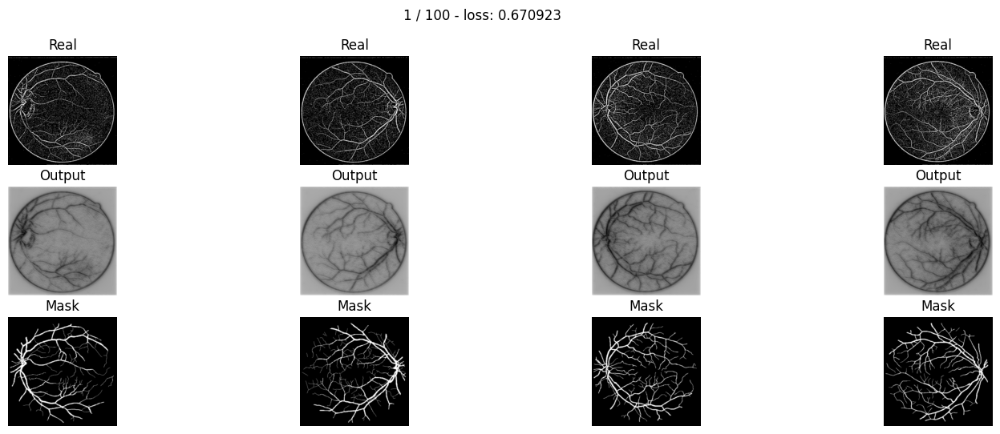

* Epoch 2/100
 - loss: 0.482451
tensor([[0.4347, 0.3831, 0.3652,  ..., 0.3653, 0.3812, 0.4324],
        [0.3981, 0.3202, 0.2961,  ..., 0.2984, 0.3200, 0.4025],
        [0.3845, 0.2977, 0.2690,  ..., 0.2713, 0.2954, 0.3865],
        ...,
        [0.3961, 0.3219, 0.2991,  ..., 0.2862, 0.3130, 0.3999],
        [0.4090, 0.3443, 0.3262,  ..., 0.3154, 0.3348, 0.4105],
        [0.4481, 0.4117, 0.3998,  ..., 0.3916, 0.4049, 0.4385]])
tensor([[0.4336, 0.3818, 0.3642,  ..., 0.3668, 0.3832, 0.4337],
        [0.3952, 0.3212, 0.2969,  ..., 0.3027, 0.3242, 0.4047],
        [0.3805, 0.2966, 0.2670,  ..., 0.2764, 0.3014, 0.3929],
        ...,
        [0.3961, 0.3220, 0.2993,  ..., 0.2899, 0.3150, 0.4008],
        [0.4091, 0.3444, 0.3263,  ..., 0.3167, 0.3352, 0.4109],
        [0.4481, 0.4118, 0.3999,  ..., 0.3908, 0.4048, 0.4388]])
tensor([[0.4334, 0.3816, 0.3640,  ..., 0.3648, 0.3808, 0.4322],
        [0.3949, 0.3208, 0.2965,  ..., 0.2976, 0.3194, 0.4021],
        [0.3801, 0.2960, 0.2653,  ..., 0.270

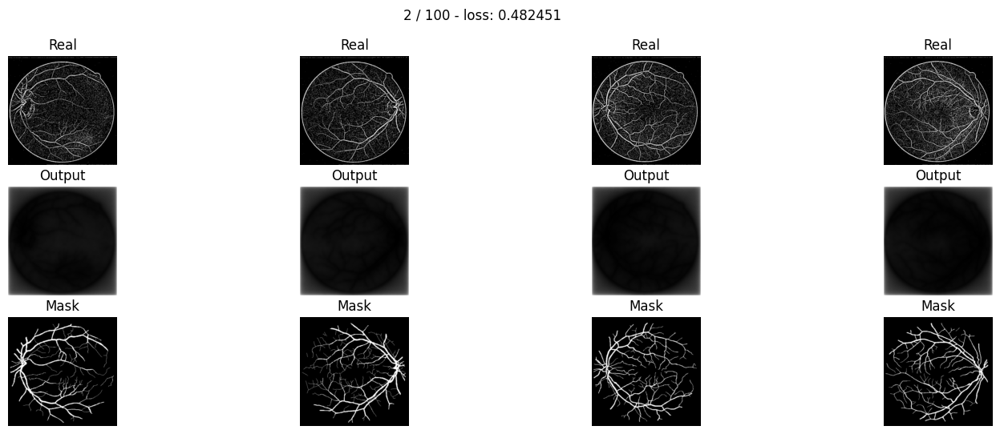

* Epoch 3/100
 - loss: 0.405837
tensor([[0.4277, 0.3749, 0.3593,  ..., 0.3595, 0.3734, 0.4262],
        [0.3895, 0.3112, 0.2903,  ..., 0.2920, 0.3107, 0.3941],
        [0.3780, 0.2921, 0.2674,  ..., 0.2686, 0.2889, 0.3796],
        ...,
        [0.3896, 0.3152, 0.2962,  ..., 0.2823, 0.3052, 0.3918],
        [0.4013, 0.3353, 0.3201,  ..., 0.3092, 0.3255, 0.4018],
        [0.4420, 0.4038, 0.3934,  ..., 0.3853, 0.3967, 0.4321]])
tensor([[0.4265, 0.3733, 0.3580,  ..., 0.3603, 0.3747, 0.4273],
        [0.3861, 0.3115, 0.2904,  ..., 0.2954, 0.3140, 0.3960],
        [0.3734, 0.2901, 0.2643,  ..., 0.2719, 0.2934, 0.3853],
        ...,
        [0.3897, 0.3153, 0.2963,  ..., 0.2860, 0.3075, 0.3930],
        [0.4013, 0.3354, 0.3202,  ..., 0.3107, 0.3261, 0.4024],
        [0.4420, 0.4038, 0.3935,  ..., 0.3848, 0.3967, 0.4324]])
tensor([[0.4263, 0.3730, 0.3577,  ..., 0.3591, 0.3731, 0.4261],
        [0.3858, 0.3109, 0.2898,  ..., 0.2915, 0.3103, 0.3939],
        [0.3729, 0.2894, 0.2624,  ..., 0.268

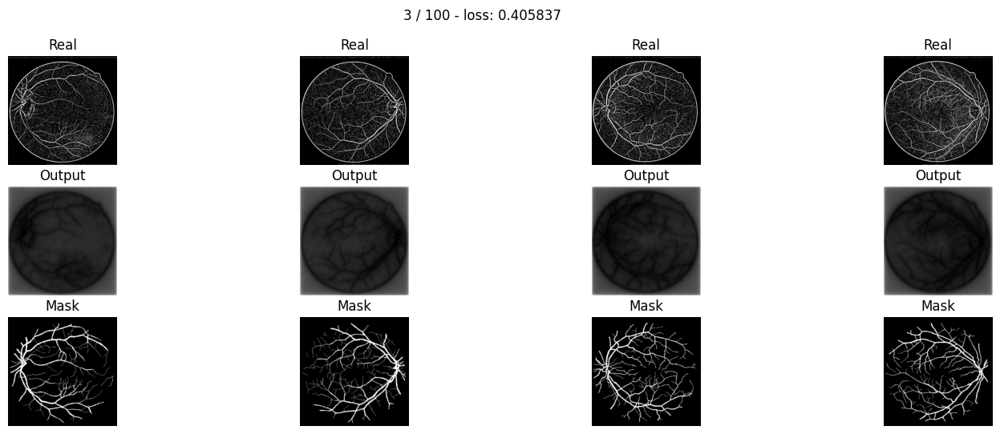

* Epoch 4/100
 - loss: 0.345071
tensor([[0.4281, 0.3783, 0.3659,  ..., 0.3653, 0.3763, 0.4266],
        [0.3916, 0.3188, 0.3021,  ..., 0.3029, 0.3177, 0.3963],
        [0.3830, 0.3045, 0.2850,  ..., 0.2848, 0.3003, 0.3843],
        ...,
        [0.3928, 0.3233, 0.3086,  ..., 0.2949, 0.3130, 0.3939],
        [0.4021, 0.3399, 0.3280,  ..., 0.3186, 0.3309, 0.4024],
        [0.4410, 0.4044, 0.3961,  ..., 0.3900, 0.3990, 0.4320]])
tensor([[0.4268, 0.3767, 0.3645,  ..., 0.3652, 0.3767, 0.4271],
        [0.3882, 0.3190, 0.3021,  ..., 0.3046, 0.3194, 0.3972],
        [0.3785, 0.3023, 0.2812,  ..., 0.2853, 0.3023, 0.3887],
        ...,
        [0.3928, 0.3234, 0.3087,  ..., 0.2981, 0.3150, 0.3950],
        [0.4021, 0.3399, 0.3281,  ..., 0.3199, 0.3313, 0.4028],
        [0.4411, 0.4044, 0.3961,  ..., 0.3895, 0.3989, 0.4323]])
tensor([[0.4266, 0.3763, 0.3641,  ..., 0.3651, 0.3761, 0.4265],
        [0.3878, 0.3183, 0.3013,  ..., 0.3026, 0.3175, 0.3962],
        [0.3781, 0.3015, 0.2790,  ..., 0.284

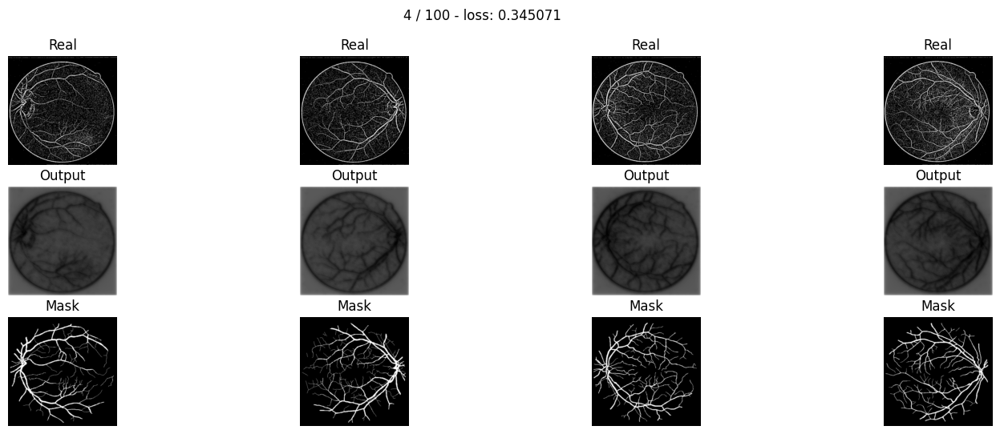

* Epoch 5/100
 - loss: 0.344753
tensor([[0.4152, 0.3580, 0.3440,  ..., 0.3428, 0.3556, 0.4136],
        [0.3718, 0.2890, 0.2707,  ..., 0.2707, 0.2875, 0.3766],
        [0.3619, 0.2735, 0.2523,  ..., 0.2515, 0.2690, 0.3634],
        ...,
        [0.3721, 0.2915, 0.2746,  ..., 0.2609, 0.2806, 0.3729],
        [0.3834, 0.3106, 0.2967,  ..., 0.2876, 0.3018, 0.3838],
        [0.4291, 0.3852, 0.3753,  ..., 0.3703, 0.3811, 0.4211]])
tensor([[0.4136, 0.3560, 0.3422,  ..., 0.3416, 0.3550, 0.4136],
        [0.3682, 0.2887, 0.2701,  ..., 0.2703, 0.2874, 0.3767],
        [0.3573, 0.2708, 0.2478,  ..., 0.2489, 0.2684, 0.3665],
        ...,
        [0.3721, 0.2916, 0.2746,  ..., 0.2642, 0.2831, 0.3743],
        [0.3834, 0.3106, 0.2967,  ..., 0.2895, 0.3027, 0.3846],
        [0.4291, 0.3852, 0.3753,  ..., 0.3705, 0.3813, 0.4215]])
tensor([[0.4133, 0.3555, 0.3415,  ..., 0.3425, 0.3554, 0.4135],
        [0.3676, 0.2877, 0.2688,  ..., 0.2704, 0.2872, 0.3765],
        [0.3566, 0.2696, 0.2452,  ..., 0.251

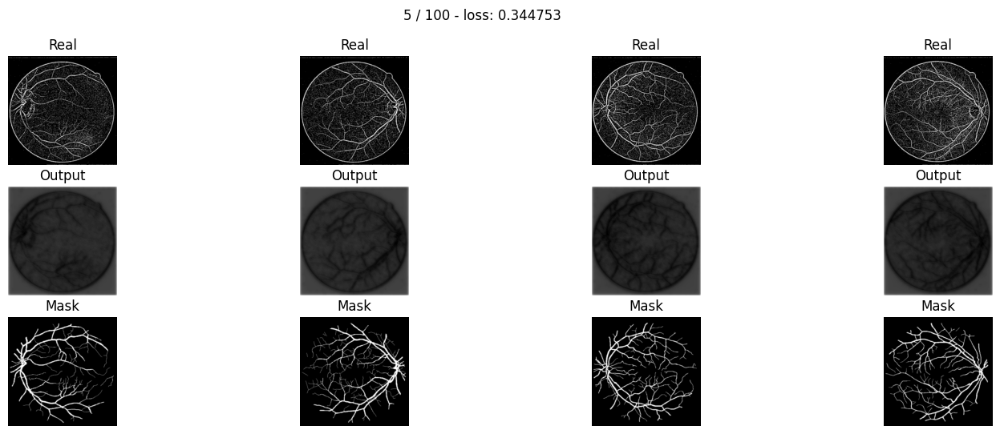

* Epoch 6/100
 - loss: 0.322256
tensor([[0.3936, 0.3233, 0.3049,  ..., 0.3034, 0.3205, 0.3920],
        [0.3382, 0.2387, 0.2163,  ..., 0.2159, 0.2368, 0.3428],
        [0.3245, 0.2194, 0.1943,  ..., 0.1933, 0.2150, 0.3263],
        ...,
        [0.3358, 0.2369, 0.2153,  ..., 0.2022, 0.2259, 0.3364],
        [0.3515, 0.2612, 0.2427,  ..., 0.2338, 0.2526, 0.3523],
        [0.4099, 0.3534, 0.3397,  ..., 0.3345, 0.3492, 0.4022]])
tensor([[0.3916, 0.3207, 0.3026,  ..., 0.3006, 0.3185, 0.3911],
        [0.3339, 0.2376, 0.2149,  ..., 0.2130, 0.2344, 0.3415],
        [0.3195, 0.2162, 0.1894,  ..., 0.1877, 0.2115, 0.3274],
        ...,
        [0.3359, 0.2369, 0.2154,  ..., 0.2060, 0.2291, 0.3386],
        [0.3515, 0.2612, 0.2428,  ..., 0.2367, 0.2545, 0.3537],
        [0.4099, 0.3534, 0.3397,  ..., 0.3358, 0.3502, 0.4030]])
tensor([[0.3910, 0.3197, 0.3013,  ..., 0.3030, 0.3202, 0.3918],
        [0.3330, 0.2360, 0.2130,  ..., 0.2155, 0.2364, 0.3426],
        [0.3184, 0.2144, 0.1863,  ..., 0.192

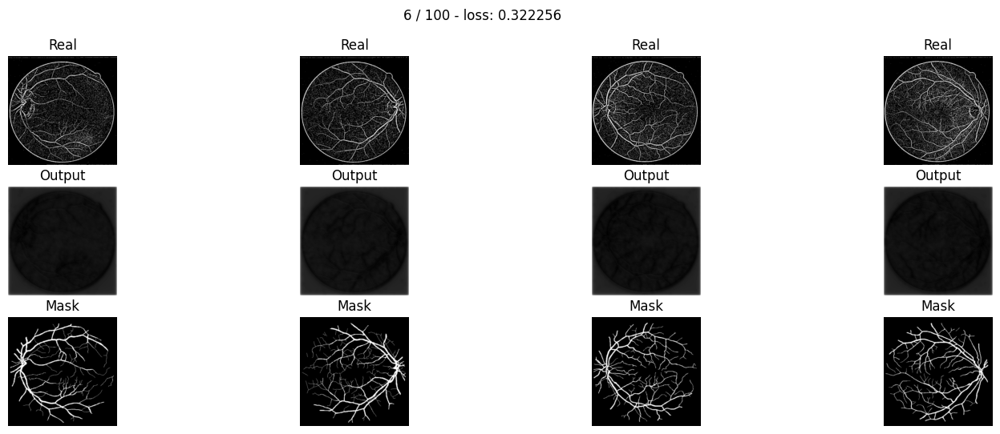

* Epoch 7/100
 - loss: 0.311601
tensor([[0.3791, 0.3011, 0.2807,  ..., 0.2795, 0.2986, 0.3777],
        [0.3165, 0.2094, 0.1859,  ..., 0.1860, 0.2078, 0.3215],
        [0.3011, 0.1890, 0.1634,  ..., 0.1631, 0.1855, 0.3036],
        ...,
        [0.3112, 0.2034, 0.1804,  ..., 0.1697, 0.1940, 0.3125],
        [0.3294, 0.2297, 0.2094,  ..., 0.2028, 0.2230, 0.3314],
        [0.3960, 0.3310, 0.3150,  ..., 0.3117, 0.3286, 0.3895]])
tensor([[0.3767, 0.2982, 0.2781,  ..., 0.2751, 0.2950, 0.3759],
        [0.3120, 0.2078, 0.1840,  ..., 0.1807, 0.2031, 0.3185],
        [0.2960, 0.1857, 0.1583,  ..., 0.1547, 0.1791, 0.3025],
        ...,
        [0.3112, 0.2035, 0.1805,  ..., 0.1734, 0.1975, 0.3151],
        [0.3294, 0.2297, 0.2095,  ..., 0.2062, 0.2255, 0.3333],
        [0.3960, 0.3310, 0.3150,  ..., 0.3139, 0.3301, 0.3906]])
tensor([[0.3759, 0.2968, 0.2764,  ..., 0.2791, 0.2983, 0.3776],
        [0.3108, 0.2058, 0.1817,  ..., 0.1855, 0.2074, 0.3213],
        [0.2946, 0.1835, 0.1549,  ..., 0.162

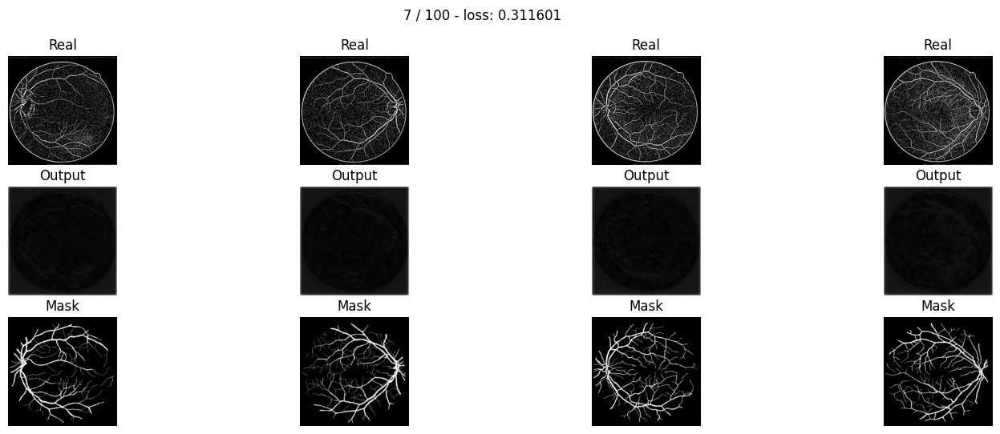

* Epoch 8/100
 - loss: 0.301812
tensor([[0.3768, 0.2993, 0.2799,  ..., 0.2797, 0.2976, 0.3763],
        [0.3147, 0.2090, 0.1866,  ..., 0.1880, 0.2086, 0.3207],
        [0.3004, 0.1903, 0.1659,  ..., 0.1671, 0.1881, 0.3042],
        ...,
        [0.3077, 0.2001, 0.1779,  ..., 0.1697, 0.1928, 0.3100],
        [0.3256, 0.2256, 0.2060,  ..., 0.2027, 0.2219, 0.3292],
        [0.3928, 0.3270, 0.3113,  ..., 0.3116, 0.3280, 0.3882]])
tensor([[0.3744, 0.2963, 0.2771,  ..., 0.2735, 0.2924, 0.3734],
        [0.3104, 0.2073, 0.1845,  ..., 0.1800, 0.2013, 0.3159],
        [0.2956, 0.1869, 0.1602,  ..., 0.1551, 0.1783, 0.3007],
        ...,
        [0.3077, 0.2002, 0.1779,  ..., 0.1732, 0.1961, 0.3126],
        [0.3256, 0.2257, 0.2060,  ..., 0.2062, 0.2244, 0.3311],
        [0.3928, 0.3270, 0.3114,  ..., 0.3143, 0.3295, 0.3894]])
tensor([[0.3736, 0.2947, 0.2751,  ..., 0.2794, 0.2974, 0.3761],
        [0.3090, 0.2050, 0.1817,  ..., 0.1877, 0.2083, 0.3206],
        [0.2941, 0.1844, 0.1563,  ..., 0.166

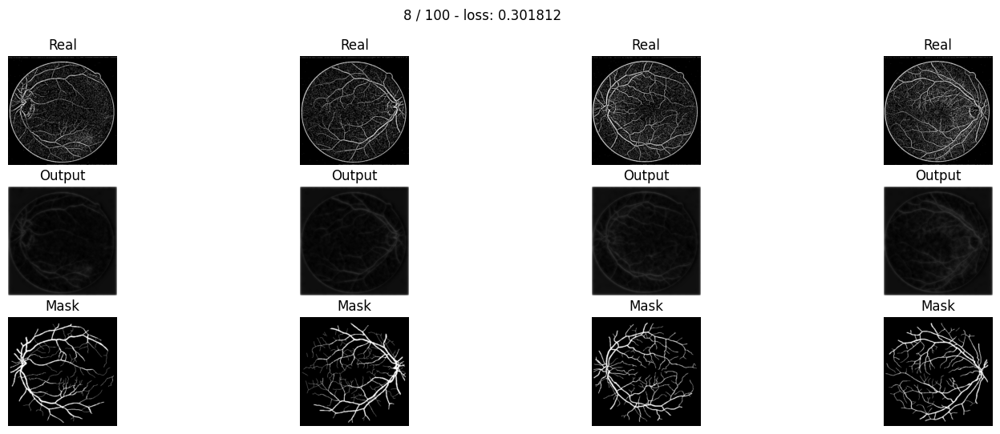

* Epoch 9/100
 - loss: 0.284568
tensor([[0.3746, 0.2973, 0.2784,  ..., 0.2793, 0.2965, 0.3748],
        [0.3127, 0.2079, 0.1864,  ..., 0.1890, 0.2086, 0.3196],
        [0.2992, 0.1904, 0.1671,  ..., 0.1696, 0.1897, 0.3041],
        ...,
        [0.3035, 0.1958, 0.1740,  ..., 0.1687, 0.1908, 0.3071],
        [0.3214, 0.2209, 0.2016,  ..., 0.2020, 0.2205, 0.3269],
        [0.3893, 0.3225, 0.3071,  ..., 0.3116, 0.3276, 0.3873]])
tensor([[0.3722, 0.2942, 0.2755,  ..., 0.2713, 0.2895, 0.3707],
        [0.3085, 0.2061, 0.1839,  ..., 0.1781, 0.1984, 0.3126],
        [0.2948, 0.1872, 0.1609,  ..., 0.1537, 0.1762, 0.2980],
        ...,
        [0.3036, 0.1958, 0.1740,  ..., 0.1719, 0.1940, 0.3097],
        [0.3214, 0.2209, 0.2016,  ..., 0.2057, 0.2230, 0.3289],
        [0.3893, 0.3225, 0.3071,  ..., 0.3147, 0.3292, 0.3885]])
tensor([[0.3712, 0.2923, 0.2732,  ..., 0.2790, 0.2964, 0.3747],
        [0.3070, 0.2036, 0.1808,  ..., 0.1887, 0.2083, 0.3194],
        [0.2931, 0.1843, 0.1565,  ..., 0.169

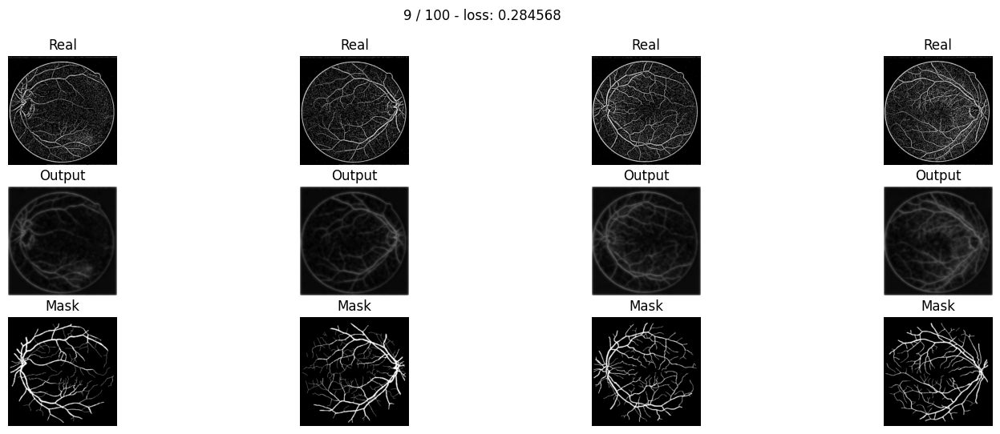

* Epoch 10/100
 - loss: 0.273810
tensor([[0.3684, 0.2884, 0.2691,  ..., 0.2709, 0.2885, 0.3690],
        [0.3041, 0.1973, 0.1757,  ..., 0.1793, 0.1988, 0.3115],
        [0.2903, 0.1802, 0.1571,  ..., 0.1607, 0.1806, 0.2961],
        ...,
        [0.2918, 0.1814, 0.1593,  ..., 0.1570, 0.1788, 0.2967],
        [0.3106, 0.2068, 0.1870,  ..., 0.1910, 0.2097, 0.3184],
        [0.3821, 0.3116, 0.2954,  ..., 0.3040, 0.3206, 0.3827]])
tensor([[0.3658, 0.2851, 0.2660,  ..., 0.2607, 0.2794, 0.3636],
        [0.2998, 0.1953, 0.1729,  ..., 0.1655, 0.1858, 0.3021],
        [0.2861, 0.1768, 0.1505,  ..., 0.1413, 0.1635, 0.2870],
        ...,
        [0.2918, 0.1814, 0.1594,  ..., 0.1600, 0.1819, 0.2994],
        [0.3106, 0.2069, 0.1870,  ..., 0.1950, 0.2124, 0.3204],
        [0.3821, 0.3116, 0.2954,  ..., 0.3076, 0.3225, 0.3839]])
tensor([[0.3646, 0.2830, 0.2633,  ..., 0.2707, 0.2883, 0.3689],
        [0.2981, 0.1924, 0.1694,  ..., 0.1790, 0.1986, 0.3113],
        [0.2842, 0.1737, 0.1457,  ..., 0.16

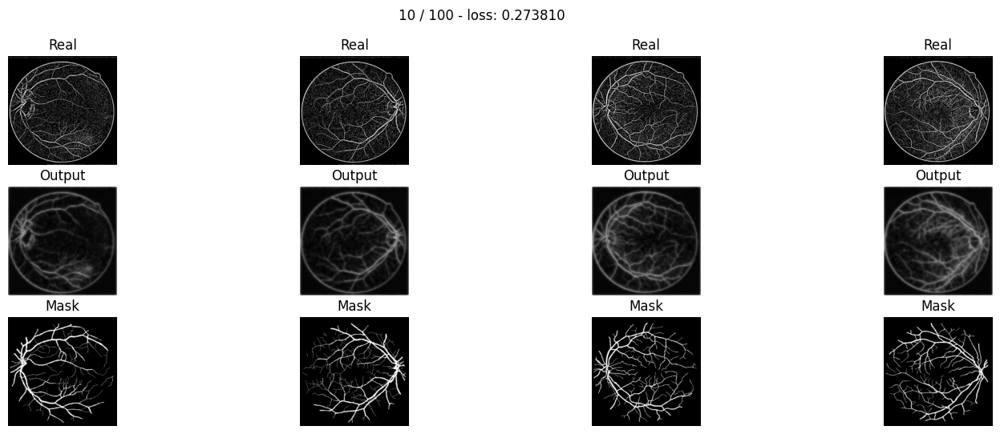

* Epoch 11/100
 - loss: 0.261474
tensor([[0.3555, 0.2693, 0.2483,  ..., 0.2509, 0.2701, 0.3566],
        [0.2853, 0.1735, 0.1513,  ..., 0.1555, 0.1756, 0.2930],
        [0.2697, 0.1557, 0.1324,  ..., 0.1366, 0.1570, 0.2763],
        ...,
        [0.2689, 0.1537, 0.1311,  ..., 0.1311, 0.1530, 0.2751],
        [0.2900, 0.1800, 0.1590,  ..., 0.1656, 0.1853, 0.2998],
        [0.3686, 0.2907, 0.2724,  ..., 0.2844, 0.3031, 0.3719]])
tensor([[0.3526, 0.2656, 0.2447,  ..., 0.2382, 0.2585, 0.3493],
        [0.2808, 0.1712, 0.1480,  ..., 0.1393, 0.1600, 0.2809],
        [0.2656, 0.1522, 0.1256,  ..., 0.1153, 0.1373, 0.2639],
        ...,
        [0.2689, 0.1537, 0.1311,  ..., 0.1342, 0.1563, 0.2781],
        [0.2900, 0.1800, 0.1590,  ..., 0.1700, 0.1884, 0.3023],
        [0.3686, 0.2907, 0.2724,  ..., 0.2891, 0.3056, 0.3735]])
tensor([[0.3512, 0.2631, 0.2415,  ..., 0.2506, 0.2699, 0.3565],
        [0.2787, 0.1679, 0.1440,  ..., 0.1552, 0.1754, 0.2929],
        [0.2632, 0.1486, 0.1206,  ..., 0.13

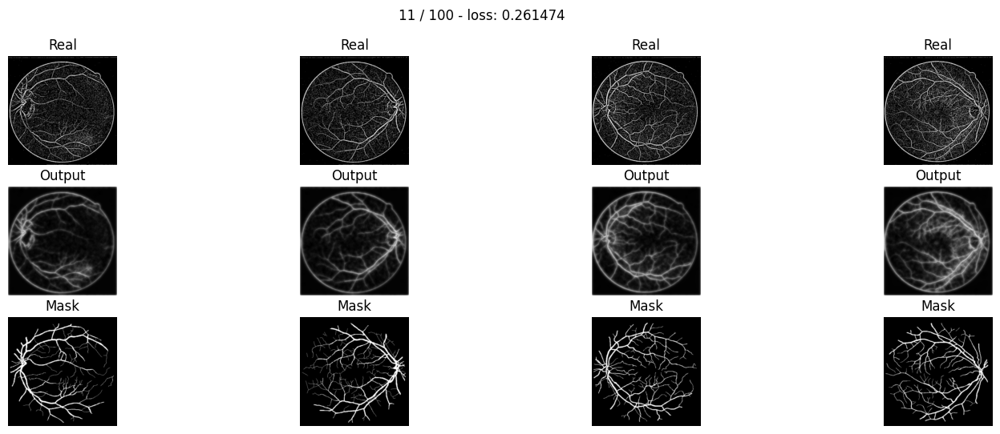

* Epoch 12/100
 - loss: 0.248518
tensor([[0.3392, 0.2456, 0.2223,  ..., 0.2258, 0.2470, 0.3407],
        [0.2617, 0.1454, 0.1227,  ..., 0.1274, 0.1480, 0.2696],
        [0.2438, 0.1270, 0.1040,  ..., 0.1087, 0.1290, 0.2512],
        ...,
        [0.2404, 0.1223, 0.1000,  ..., 0.1021, 0.1235, 0.2481],
        [0.2643, 0.1489, 0.1272,  ..., 0.1357, 0.1562, 0.2763],
        [0.3513, 0.2646, 0.2438,  ..., 0.2593, 0.2805, 0.3579]])
tensor([[0.3359, 0.2414, 0.2183,  ..., 0.2104, 0.2327, 0.3312],
        [0.2569, 0.1427, 0.1192,  ..., 0.1098, 0.1303, 0.2544],
        [0.2396, 0.1234, 0.0975,  ..., 0.0868, 0.1078, 0.2350],
        ...,
        [0.2404, 0.1224, 0.1000,  ..., 0.1051, 0.1268, 0.2515],
        [0.2643, 0.1489, 0.1272,  ..., 0.1404, 0.1598, 0.2792],
        [0.3513, 0.2646, 0.2438,  ..., 0.2651, 0.2837, 0.3599]])
tensor([[0.3342, 0.2383, 0.2144,  ..., 0.2255, 0.2468, 0.3406],
        [0.2543, 0.1390, 0.1149,  ..., 0.1271, 0.1478, 0.2694],
        [0.2367, 0.1195, 0.0925,  ..., 0.10

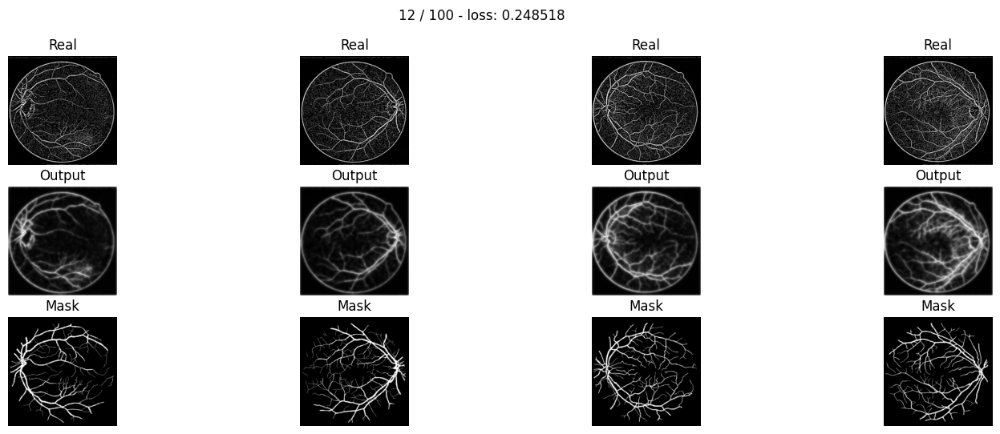

* Epoch 13/100
 - loss: 0.237869
tensor([[0.3256, 0.2263, 0.2016,  ..., 0.2059, 0.2283, 0.3273],
        [0.2423, 0.1244, 0.1021,  ..., 0.1070, 0.1274, 0.2503],
        [0.2230, 0.1062, 0.0842,  ..., 0.0891, 0.1089, 0.2309],
        ...,
        [0.2162, 0.0986, 0.0773,  ..., 0.0812, 0.1014, 0.2255],
        [0.2421, 0.1244, 0.1028,  ..., 0.1133, 0.1339, 0.2564],
        [0.3359, 0.2421, 0.2195,  ..., 0.2389, 0.2621, 0.3461]])
tensor([[0.3220, 0.2219, 0.1973,  ..., 0.1877, 0.2110, 0.3151],
        [0.2374, 0.1215, 0.0984,  ..., 0.0881, 0.1077, 0.2317],
        [0.2188, 0.1027, 0.0781,  ..., 0.0670, 0.0862, 0.2108],
        ...,
        [0.2163, 0.0986, 0.0773,  ..., 0.0840, 0.1047, 0.2291],
        [0.2421, 0.1244, 0.1028,  ..., 0.1181, 0.1376, 0.2598],
        [0.3359, 0.2421, 0.2195,  ..., 0.2456, 0.2659, 0.3483]])
tensor([[0.3198, 0.2181, 0.1927,  ..., 0.2057, 0.2281, 0.3271],
        [0.2343, 0.1174, 0.0939,  ..., 0.1068, 0.1272, 0.2502],
        [0.2155, 0.0985, 0.0731,  ..., 0.08

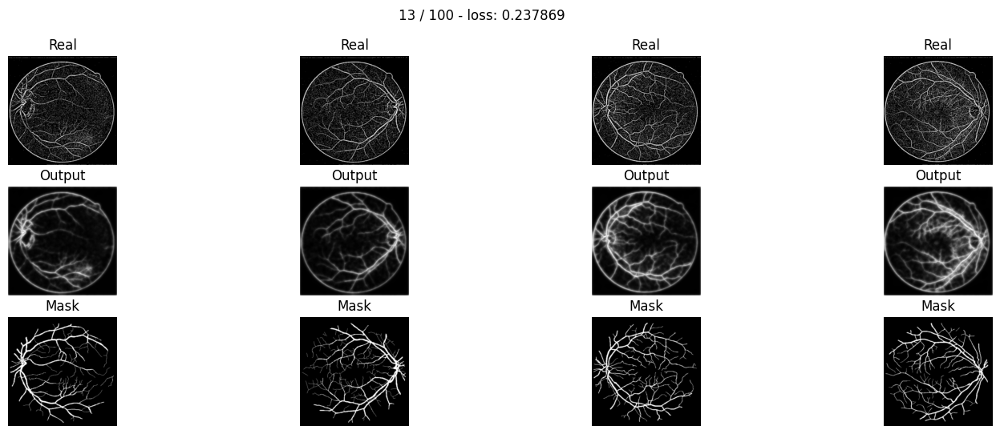

* Epoch 14/100
 - loss: 0.228926
tensor([[0.3166, 0.2141, 0.1888,  ..., 0.1939, 0.2168, 0.3184],
        [0.2300, 0.1120, 0.0902,  ..., 0.0957, 0.1155, 0.2381],
        [0.2101, 0.0945, 0.0734,  ..., 0.0788, 0.0978, 0.2184],
        ...,
        [0.1990, 0.0832, 0.0632,  ..., 0.0689, 0.0880, 0.2100],
        [0.2260, 0.1080, 0.0869,  ..., 0.0999, 0.1202, 0.2431],
        [0.3243, 0.2257, 0.2020,  ..., 0.2264, 0.2507, 0.3385]])
tensor([[0.3128, 0.2095, 0.1842,  ..., 0.1724, 0.1960, 0.3032],
        [0.2251, 0.1091, 0.0865,  ..., 0.0749, 0.0934, 0.2155],
        [0.2063, 0.0911, 0.0675,  ..., 0.0553, 0.0730, 0.1939],
        ...,
        [0.1990, 0.0833, 0.0632,  ..., 0.0715, 0.0910, 0.2137],
        [0.2260, 0.1080, 0.0869,  ..., 0.1047, 0.1240, 0.2466],
        [0.3243, 0.2257, 0.2020,  ..., 0.2338, 0.2549, 0.3409]])
tensor([[0.3103, 0.2052, 0.1789,  ..., 0.1936, 0.2165, 0.3182],
        [0.2216, 0.1046, 0.0816,  ..., 0.0954, 0.1153, 0.2379],
        [0.2023, 0.0866, 0.0623,  ..., 0.07

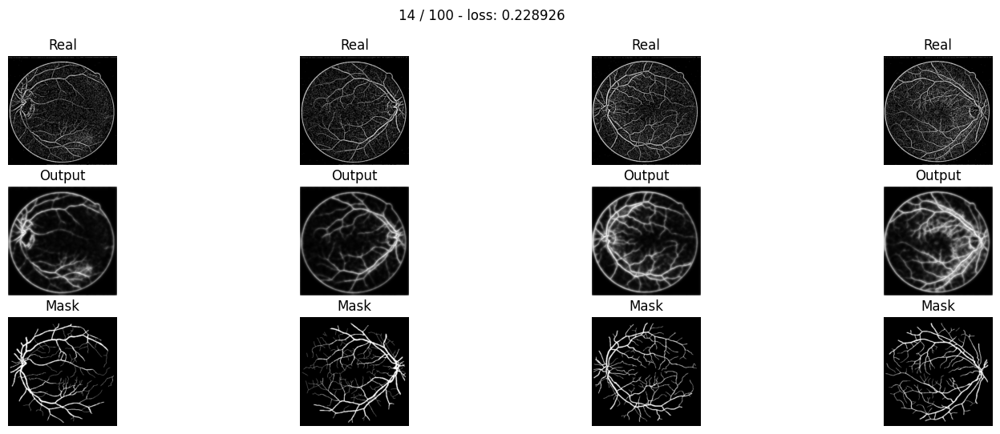

* Epoch 15/100
 - loss: 0.220826
tensor([[0.3092, 0.2043, 0.1784,  ..., 0.1848, 0.2078, 0.3112],
        [0.2201, 0.1026, 0.0813,  ..., 0.0876, 0.1069, 0.2285],
        [0.1999, 0.0858, 0.0655,  ..., 0.0717, 0.0900, 0.2090],
        ...,
        [0.1840, 0.0710, 0.0523,  ..., 0.0599, 0.0779, 0.1972],
        [0.2119, 0.0946, 0.0742,  ..., 0.0899, 0.1098, 0.2323],
        [0.3138, 0.2113, 0.1867,  ..., 0.2168, 0.2421, 0.3326]])
tensor([[0.3054, 0.1996, 0.1737,  ..., 0.1599, 0.1834, 0.2927],
        [0.2154, 0.0997, 0.0776,  ..., 0.0648, 0.0822, 0.2016],
        [0.1965, 0.0825, 0.0597,  ..., 0.0468, 0.0630, 0.1797],
        ...,
        [0.1840, 0.0710, 0.0523,  ..., 0.0622, 0.0807, 0.2009],
        [0.2119, 0.0946, 0.0742,  ..., 0.0947, 0.1135, 0.2358],
        [0.3138, 0.2113, 0.1867,  ..., 0.2248, 0.2465, 0.3351]])
tensor([[0.3024, 0.1946, 0.1677,  ..., 0.1845, 0.2076, 0.3110],
        [0.2113, 0.0948, 0.0723,  ..., 0.0873, 0.1067, 0.2283],
        [0.1920, 0.0776, 0.0543,  ..., 0.07

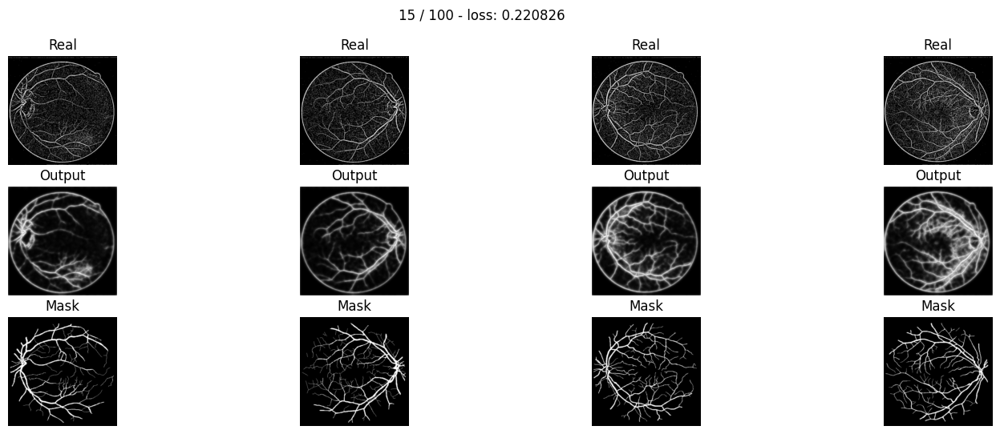

* Epoch 16/100
 - loss: 0.215982
tensor([[0.2983, 0.1900, 0.1634,  ..., 0.1711, 0.1947, 0.3008],
        [0.2056, 0.0894, 0.0690,  ..., 0.0759, 0.0946, 0.2147],
        [0.1848, 0.0734, 0.0544,  ..., 0.0611, 0.0785, 0.1949],
        ...,
        [0.1648, 0.0568, 0.0400,  ..., 0.0485, 0.0650, 0.1802],
        [0.1935, 0.0785, 0.0594,  ..., 0.0765, 0.0957, 0.2172],
        [0.2999, 0.1927, 0.1671,  ..., 0.2020, 0.2286, 0.3233]])
tensor([[0.2943, 0.1851, 0.1585,  ..., 0.1432, 0.1668, 0.2787],
        [0.2009, 0.0865, 0.0654,  ..., 0.0525, 0.0684, 0.1836],
        [0.1815, 0.0703, 0.0490,  ..., 0.0365, 0.0508, 0.1611],
        ...,
        [0.1648, 0.0568, 0.0400,  ..., 0.0505, 0.0675, 0.1838],
        [0.1935, 0.0785, 0.0594,  ..., 0.0810, 0.0993, 0.2208],
        [0.2999, 0.1927, 0.1671,  ..., 0.2106, 0.2333, 0.3260]])
tensor([[0.2909, 0.1795, 0.1518,  ..., 0.1708, 0.1944, 0.3006],
        [0.1963, 0.0813, 0.0600,  ..., 0.0757, 0.0943, 0.2145],
        [0.1765, 0.0652, 0.0438,  ..., 0.06

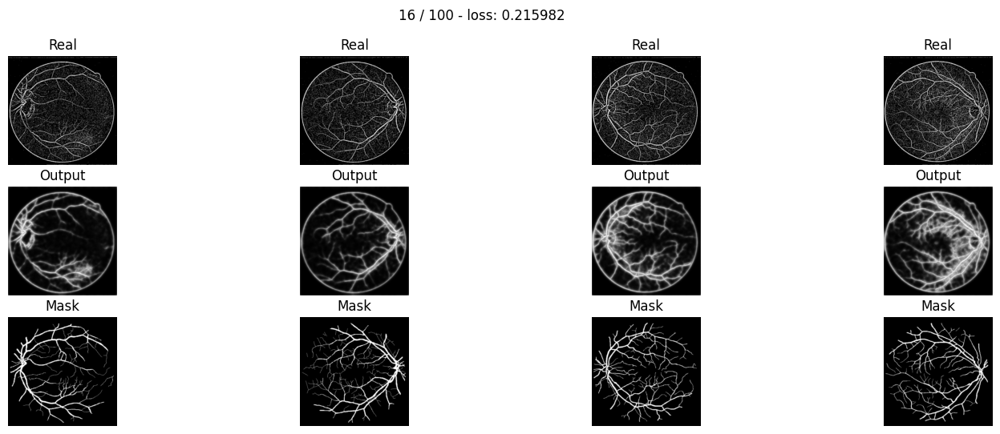

* Epoch 17/100
 - loss: 0.212764
tensor([[0.2836, 0.1714, 0.1441,  ..., 0.1532, 0.1773, 0.2868],
        [0.1865, 0.0734, 0.0545,  ..., 0.0617, 0.0792, 0.1964],
        [0.1648, 0.0584, 0.0415,  ..., 0.0482, 0.0642, 0.1761],
        ...,
        [0.1421, 0.0421, 0.0280,  ..., 0.0360, 0.0505, 0.1589],
        [0.1714, 0.0613, 0.0442,  ..., 0.0606, 0.0786, 0.1974],
        [0.2824, 0.1702, 0.1439,  ..., 0.1819, 0.2098, 0.3102]])
tensor([[0.2793, 0.1663, 0.1391,  ..., 0.1231, 0.1466, 0.2611],
        [0.1817, 0.0705, 0.0512,  ..., 0.0395, 0.0534, 0.1620],
        [0.1615, 0.0556, 0.0369,  ..., 0.0261, 0.0380, 0.1390],
        ...,
        [0.1421, 0.0421, 0.0280,  ..., 0.0377, 0.0526, 0.1625],
        [0.1714, 0.0613, 0.0442,  ..., 0.0647, 0.0820, 0.2012],
        [0.2824, 0.1703, 0.1440,  ..., 0.1908, 0.2149, 0.3131]])
tensor([[0.2754, 0.1603, 0.1320,  ..., 0.1528, 0.1770, 0.2866],
        [0.1767, 0.0655, 0.0462,  ..., 0.0614, 0.0789, 0.1962],
        [0.1561, 0.0508, 0.0323,  ..., 0.04

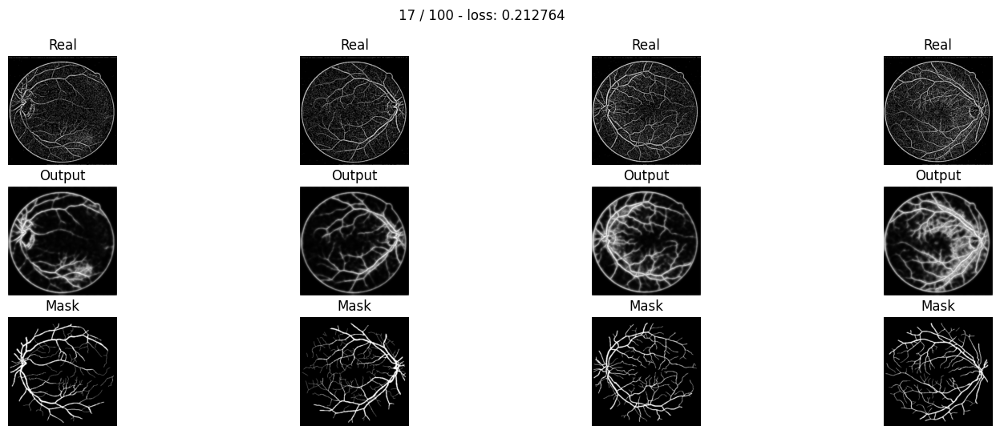

* Epoch 18/100
 - loss: 0.211073
tensor([[0.2696, 0.1547, 0.1272,  ..., 0.1376, 0.1620, 0.2739],
        [0.1693, 0.0605, 0.0433,  ..., 0.0505, 0.0668, 0.1802],
        [0.1471, 0.0468, 0.0319,  ..., 0.0385, 0.0530, 0.1596],
        ...,
        [0.1225, 0.0314, 0.0197,  ..., 0.0269, 0.0392, 0.1400],
        [0.1518, 0.0479, 0.0330,  ..., 0.0482, 0.0647, 0.1794],
        [0.2658, 0.1504, 0.1240,  ..., 0.1637, 0.1926, 0.2976]])
tensor([[0.2651, 0.1496, 0.1222,  ..., 0.1060, 0.1291, 0.2446],
        [0.1645, 0.0578, 0.0403,  ..., 0.0299, 0.0419, 0.1430],
        [0.1440, 0.0443, 0.0280,  ..., 0.0188, 0.0286, 0.1201],
        ...,
        [0.1225, 0.0314, 0.0197,  ..., 0.0282, 0.0411, 0.1436],
        [0.1518, 0.0479, 0.0330,  ..., 0.0518, 0.0678, 0.1832],
        [0.2658, 0.1504, 0.1240,  ..., 0.1730, 0.1979, 0.3008]])
tensor([[0.2608, 0.1432, 0.1150,  ..., 0.1372, 0.1617, 0.2737],
        [0.1592, 0.0530, 0.0358,  ..., 0.0503, 0.0665, 0.1799],
        [0.1384, 0.0399, 0.0240,  ..., 0.03

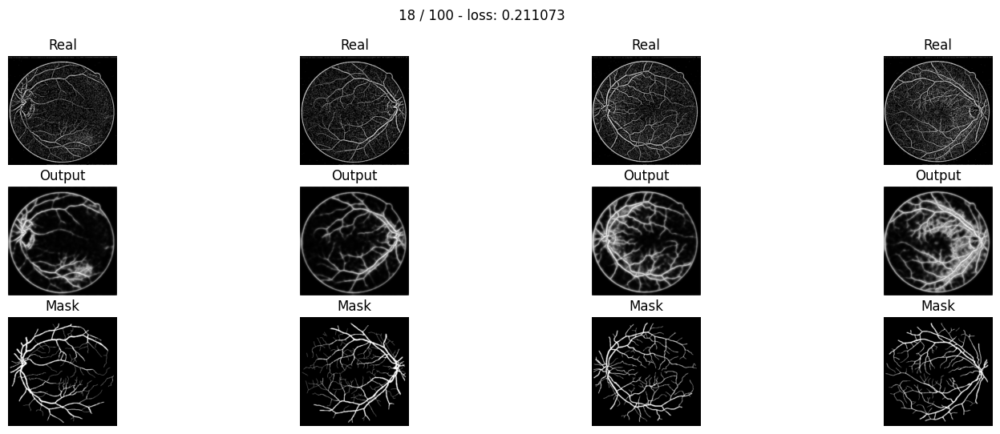

* Epoch 19/100
 - loss: 0.208894
tensor([[0.2643, 0.1486, 0.1212,  ..., 0.1334, 0.1575, 0.2696],
        [0.1632, 0.0564, 0.0398,  ..., 0.0479, 0.0636, 0.1752],
        [0.1413, 0.0434, 0.0292,  ..., 0.0366, 0.0506, 0.1551],
        ...,
        [0.1131, 0.0268, 0.0163,  ..., 0.0236, 0.0350, 0.1317],
        [0.1421, 0.0421, 0.0282,  ..., 0.0438, 0.0596, 0.1718],
        [0.2571, 0.1407, 0.1144,  ..., 0.1576, 0.1868, 0.2929]])
tensor([[0.2598, 0.1435, 0.1161,  ..., 0.0992, 0.1216, 0.2366],
        [0.1585, 0.0537, 0.0369,  ..., 0.0264, 0.0375, 0.1342],
        [0.1384, 0.0410, 0.0254,  ..., 0.0163, 0.0251, 0.1117],
        ...,
        [0.1131, 0.0269, 0.0163,  ..., 0.0248, 0.0366, 0.1351],
        [0.1421, 0.0421, 0.0282,  ..., 0.0472, 0.0625, 0.1755],
        [0.2571, 0.1407, 0.1144,  ..., 0.1671, 0.1921, 0.2961]])
tensor([[0.2551, 0.1367, 0.1085,  ..., 0.1331, 0.1572, 0.2693],
        [0.1529, 0.0488, 0.0323,  ..., 0.0477, 0.0634, 0.1749],
        [0.1324, 0.0365, 0.0214,  ..., 0.03

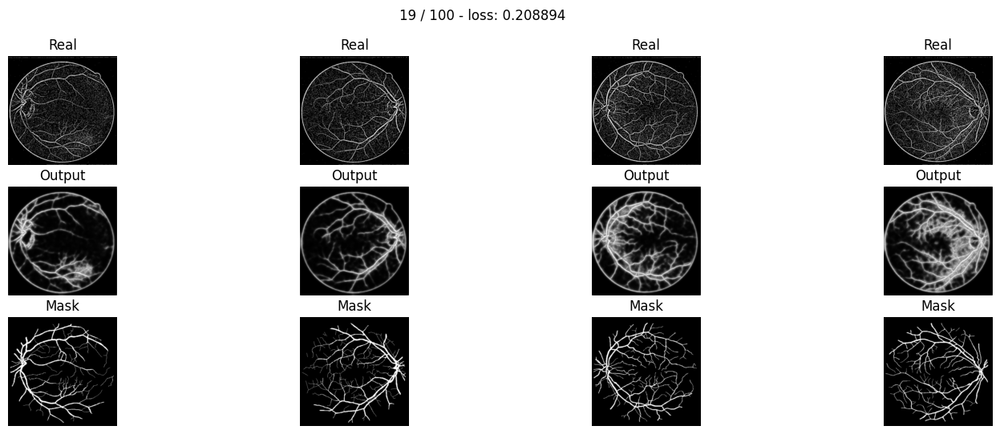

* Epoch 20/100
 - loss: 0.207004
tensor([[0.2549, 0.1381, 0.1109,  ..., 0.1245, 0.1485, 0.2614],
        [0.1524, 0.0492, 0.0339,  ..., 0.0422, 0.0571, 0.1655],
        [0.1305, 0.0373, 0.0244,  ..., 0.0319, 0.0449, 0.1458],
        ...,
        [0.1010, 0.0216, 0.0126,  ..., 0.0192, 0.0293, 0.1200],
        [0.1296, 0.0350, 0.0227,  ..., 0.0373, 0.0520, 0.1603],
        [0.2456, 0.1280, 0.1021,  ..., 0.1467, 0.1763, 0.2847]])
tensor([[0.2503, 0.1330, 0.1059,  ..., 0.0893, 0.1109, 0.2255],
        [0.1478, 0.0467, 0.0312,  ..., 0.0218, 0.0316, 0.1225],
        [0.1279, 0.0351, 0.0210,  ..., 0.0130, 0.0206, 0.1004],
        ...,
        [0.1011, 0.0216, 0.0126,  ..., 0.0202, 0.0307, 0.1232],
        [0.1296, 0.0350, 0.0227,  ..., 0.0404, 0.0547, 0.1640],
        [0.2456, 0.1281, 0.1021,  ..., 0.1563, 0.1816, 0.2880]])
tensor([[0.2454, 0.1262, 0.0982,  ..., 0.1241, 0.1482, 0.2611],
        [0.1420, 0.0421, 0.0270,  ..., 0.0420, 0.0569, 0.1653],
        [0.1217, 0.0309, 0.0174,  ..., 0.03

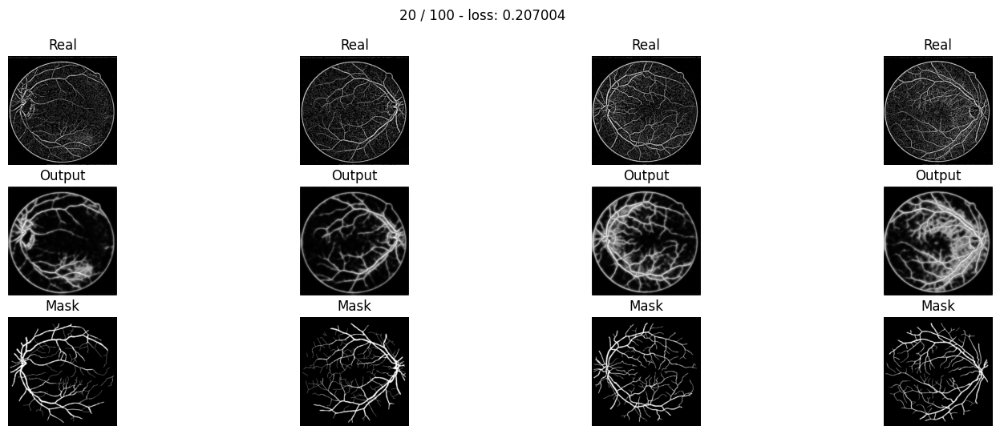

* Epoch 21/100
 - loss: 0.205137
tensor([[0.2486, 0.1313, 0.1042,  ..., 0.1196, 0.1434, 0.2564],
        [0.1455, 0.0450, 0.0304,  ..., 0.0394, 0.0537, 0.1599],
        [0.1240, 0.0338, 0.0217,  ..., 0.0297, 0.0422, 0.1407],
        ...,
        [0.0932, 0.0184, 0.0104,  ..., 0.0168, 0.0260, 0.1126],
        [0.1213, 0.0307, 0.0194,  ..., 0.0337, 0.0476, 0.1532],
        [0.2375, 0.1196, 0.0940,  ..., 0.1405, 0.1703, 0.2798]])
tensor([[0.2441, 0.1264, 0.0994,  ..., 0.0832, 0.1041, 0.2179],
        [0.1412, 0.0427, 0.0280,  ..., 0.0191, 0.0281, 0.1148],
        [0.1218, 0.0318, 0.0186,  ..., 0.0112, 0.0180, 0.0932],
        ...,
        [0.0932, 0.0184, 0.0104,  ..., 0.0176, 0.0272, 0.1155],
        [0.1213, 0.0307, 0.0194,  ..., 0.0365, 0.0501, 0.1567],
        [0.2375, 0.1196, 0.0940,  ..., 0.1501, 0.1755, 0.2830]])
tensor([[0.2389, 0.1194, 0.0917,  ..., 0.1192, 0.1430, 0.2561],
        [0.1352, 0.0381, 0.0239,  ..., 0.0392, 0.0535, 0.1597],
        [0.1154, 0.0277, 0.0152,  ..., 0.02

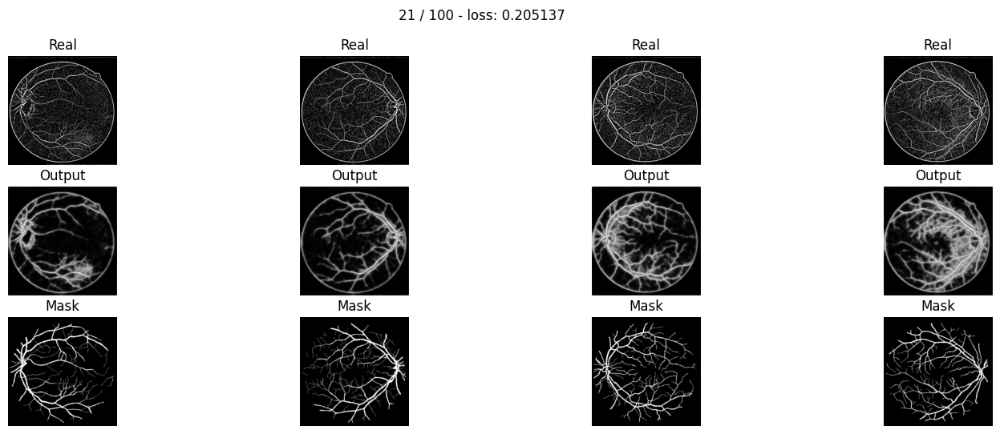

* Epoch 22/100
 - loss: 0.202752
tensor([[0.2411, 0.1231, 0.0962,  ..., 0.1136, 0.1373, 0.2506],
        [0.1373, 0.0401, 0.0264,  ..., 0.0360, 0.0498, 0.1536],
        [0.1161, 0.0297, 0.0186,  ..., 0.0270, 0.0390, 0.1348],
        ...,
        [0.0846, 0.0152, 0.0083,  ..., 0.0143, 0.0227, 0.1047],
        [0.1121, 0.0262, 0.0160,  ..., 0.0299, 0.0430, 0.1453],
        [0.2284, 0.1102, 0.0850,  ..., 0.1331, 0.1632, 0.2740]])
tensor([[0.2366, 0.1183, 0.0916,  ..., 0.0768, 0.0970, 0.2099],
        [0.1331, 0.0380, 0.0242,  ..., 0.0166, 0.0247, 0.1070],
        [0.1142, 0.0280, 0.0159,  ..., 0.0094, 0.0155, 0.0859],
        ...,
        [0.0846, 0.0152, 0.0083,  ..., 0.0149, 0.0237, 0.1074],
        [0.1121, 0.0262, 0.0160,  ..., 0.0324, 0.0452, 0.1486],
        [0.2285, 0.1102, 0.0850,  ..., 0.1427, 0.1684, 0.2772]])
tensor([[0.2312, 0.1113, 0.0840,  ..., 0.1132, 0.1369, 0.2503],
        [0.1271, 0.0336, 0.0205,  ..., 0.0358, 0.0496, 0.1533],
        [0.1078, 0.0241, 0.0128,  ..., 0.02

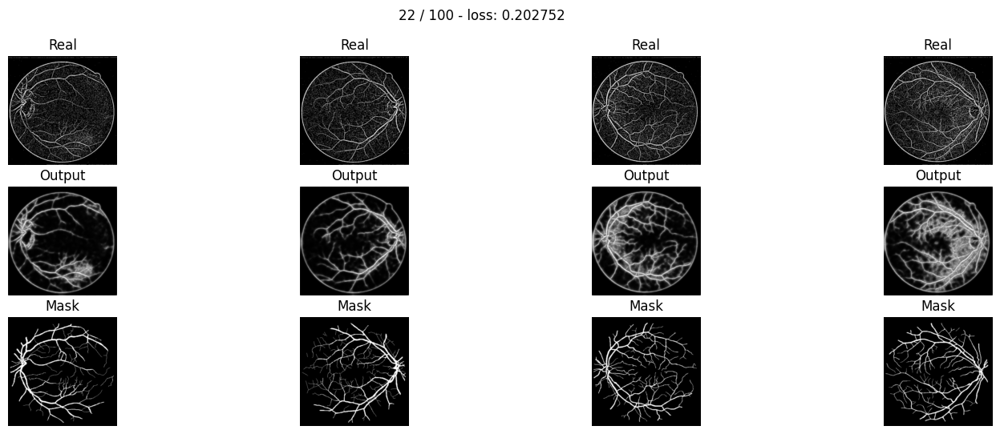

* Epoch 23/100
 - loss: 0.200761
tensor([[0.2399, 0.1219, 0.0951,  ..., 0.1150, 0.1384, 0.2511],
        [0.1364, 0.0397, 0.0261,  ..., 0.0371, 0.0509, 0.1547],
        [0.1157, 0.0296, 0.0185,  ..., 0.0284, 0.0405, 0.1368],
        ...,
        [0.0820, 0.0143, 0.0077,  ..., 0.0140, 0.0221, 0.1029],
        [0.1093, 0.0249, 0.0150,  ..., 0.0296, 0.0426, 0.1442],
        [0.2254, 0.1072, 0.0822,  ..., 0.1336, 0.1639, 0.2742]])
tensor([[0.2356, 0.1173, 0.0906,  ..., 0.0760, 0.0957, 0.2078],
        [0.1324, 0.0376, 0.0239,  ..., 0.0163, 0.0242, 0.1051],
        [0.1142, 0.0280, 0.0158,  ..., 0.0093, 0.0152, 0.0844],
        ...,
        [0.0821, 0.0143, 0.0077,  ..., 0.0145, 0.0230, 0.1054],
        [0.1093, 0.0249, 0.0150,  ..., 0.0321, 0.0448, 0.1473],
        [0.2255, 0.1072, 0.0822,  ..., 0.1434, 0.1690, 0.2773]])
tensor([[0.2300, 0.1100, 0.0827,  ..., 0.1146, 0.1381, 0.2508],
        [0.1261, 0.0331, 0.0201,  ..., 0.0369, 0.0507, 0.1544],
        [0.1074, 0.0239, 0.0126,  ..., 0.02

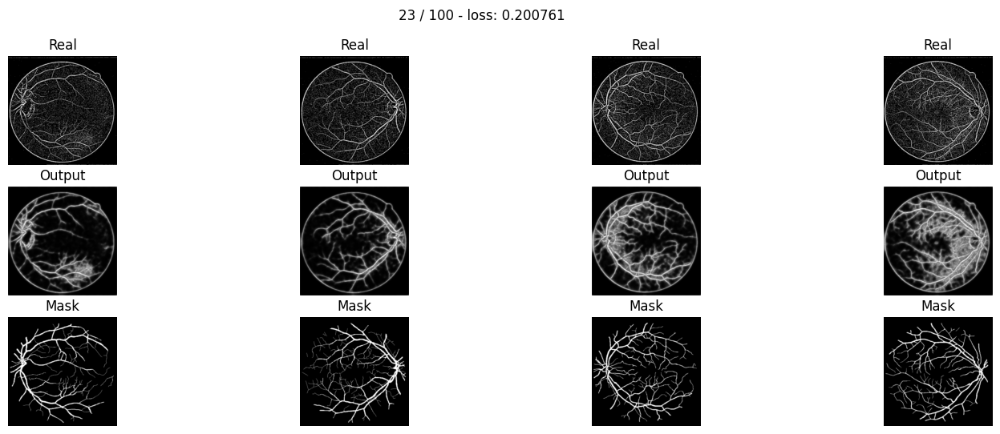

* Epoch 24/100
 - loss: 0.198586
tensor([[0.2378, 0.1194, 0.0925,  ..., 0.1161, 0.1394, 0.2516],
        [0.1342, 0.0384, 0.0250,  ..., 0.0380, 0.0520, 0.1559],
        [0.1139, 0.0287, 0.0178,  ..., 0.0296, 0.0420, 0.1389],
        ...,
        [0.0783, 0.0130, 0.0068,  ..., 0.0134, 0.0214, 0.1008],
        [0.1052, 0.0230, 0.0136,  ..., 0.0290, 0.0420, 0.1429],
        [0.2213, 0.1030, 0.0781,  ..., 0.1334, 0.1642, 0.2743]])
tensor([[0.2337, 0.1149, 0.0882,  ..., 0.0750, 0.0943, 0.2057],
        [0.1305, 0.0364, 0.0229,  ..., 0.0159, 0.0237, 0.1034],
        [0.1128, 0.0272, 0.0151,  ..., 0.0090, 0.0147, 0.0828],
        ...,
        [0.0783, 0.0130, 0.0068,  ..., 0.0138, 0.0221, 0.1030],
        [0.1053, 0.0231, 0.0136,  ..., 0.0314, 0.0440, 0.1458],
        [0.2213, 0.1030, 0.0781,  ..., 0.1434, 0.1691, 0.2772]])
tensor([[0.2279, 0.1074, 0.0802,  ..., 0.1157, 0.1391, 0.2514],
        [0.1239, 0.0318, 0.0190,  ..., 0.0378, 0.0518, 0.1556],
        [0.1057, 0.0230, 0.0119,  ..., 0.02

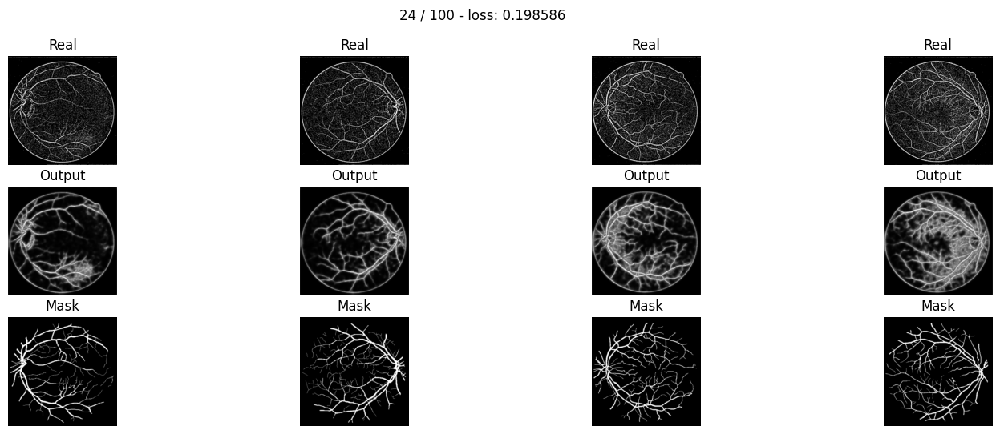

* Epoch 25/100
 - loss: 0.197503
tensor([[0.2369, 0.1183, 0.0914,  ..., 0.1187, 0.1417, 0.2531],
        [0.1335, 0.0380, 0.0246,  ..., 0.0399, 0.0541, 0.1584],
        [0.1136, 0.0286, 0.0177,  ..., 0.0318, 0.0446, 0.1426],
        ...,
        [0.0755, 0.0121, 0.0062,  ..., 0.0133, 0.0212, 0.0999],
        [0.1022, 0.0217, 0.0127,  ..., 0.0292, 0.0423, 0.1429],
        [0.2181, 0.0998, 0.0751,  ..., 0.1350, 0.1662, 0.2757]])
tensor([[0.2331, 0.1141, 0.0872,  ..., 0.0749, 0.0938, 0.2044],
        [0.1301, 0.0361, 0.0226,  ..., 0.0159, 0.0235, 0.1024],
        [0.1129, 0.0272, 0.0150,  ..., 0.0091, 0.0147, 0.0822],
        ...,
        [0.0755, 0.0121, 0.0062,  ..., 0.0136, 0.0218, 0.1019],
        [0.1022, 0.0217, 0.0127,  ..., 0.0315, 0.0441, 0.1455],
        [0.2181, 0.0998, 0.0751,  ..., 0.1454, 0.1710, 0.2784]])
tensor([[0.2270, 0.1063, 0.0789,  ..., 0.1184, 0.1414, 0.2529],
        [0.1231, 0.0314, 0.0186,  ..., 0.0397, 0.0539, 0.1581],
        [0.1053, 0.0228, 0.0116,  ..., 0.03

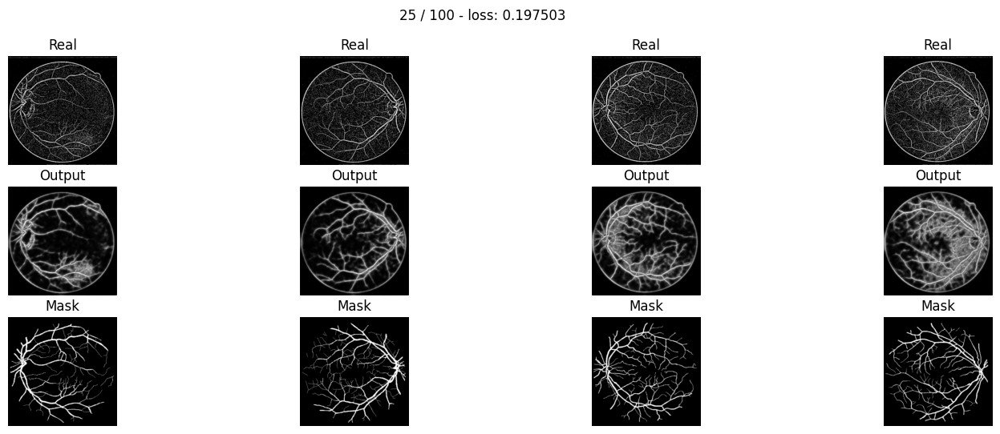

* Epoch 26/100
 - loss: 0.195222
tensor([[0.2306, 0.1116, 0.0849,  ..., 0.1140, 0.1368, 0.2485],
        [0.1268, 0.0342, 0.0216,  ..., 0.0373, 0.0510, 0.1535],
        [0.1070, 0.0254, 0.0153,  ..., 0.0297, 0.0420, 0.1383],
        ...,
        [0.0682, 0.0099, 0.0049,  ..., 0.0115, 0.0186, 0.0935],
        [0.0941, 0.0184, 0.0104,  ..., 0.0262, 0.0385, 0.1364],
        [0.2093, 0.0916, 0.0675,  ..., 0.1289, 0.1604, 0.2710]])
tensor([[0.2270, 0.1077, 0.0811,  ..., 0.0700, 0.0883, 0.1979],
        [0.1236, 0.0325, 0.0199,  ..., 0.0141, 0.0211, 0.0965],
        [0.1066, 0.0241, 0.0129,  ..., 0.0079, 0.0129, 0.0767],
        ...,
        [0.0682, 0.0099, 0.0049,  ..., 0.0117, 0.0191, 0.0953],
        [0.0941, 0.0184, 0.0104,  ..., 0.0283, 0.0403, 0.1389],
        [0.2093, 0.0916, 0.0675,  ..., 0.1394, 0.1652, 0.2738]])
tensor([[0.2205, 0.0996, 0.0727,  ..., 0.1137, 0.1365, 0.2482],
        [0.1164, 0.0279, 0.0161,  ..., 0.0371, 0.0508, 0.1532],
        [0.0988, 0.0199, 0.0098,  ..., 0.02

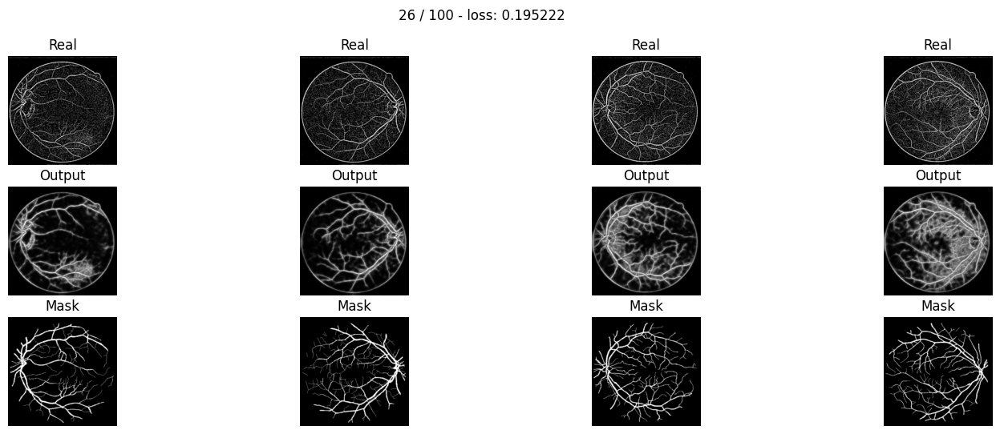

* Epoch 27/100
 - loss: 0.191871
tensor([[0.2099, 0.0913, 0.0661,  ..., 0.0953, 0.1181, 0.2313],
        [0.1053, 0.0235, 0.0137,  ..., 0.0268, 0.0388, 0.1341],
        [0.0853, 0.0162, 0.0089,  ..., 0.0202, 0.0305, 0.1180],
        ...,
        [0.0519, 0.0059, 0.0026,  ..., 0.0071, 0.0125, 0.0764],
        [0.0756, 0.0119, 0.0061,  ..., 0.0179, 0.0281, 0.1170],
        [0.1877, 0.0730, 0.0510,  ..., 0.1070, 0.1385, 0.2532]])
tensor([[0.2065, 0.0880, 0.0630,  ..., 0.0562, 0.0736, 0.1808],
        [0.1025, 0.0223, 0.0125,  ..., 0.0095, 0.0151, 0.0812],
        [0.0850, 0.0154, 0.0074,  ..., 0.0049, 0.0087, 0.0623],
        ...,
        [0.0520, 0.0059, 0.0026,  ..., 0.0073, 0.0129, 0.0781],
        [0.0756, 0.0119, 0.0061,  ..., 0.0195, 0.0295, 0.1194],
        [0.1878, 0.0731, 0.0510,  ..., 0.1166, 0.1432, 0.2560]])
tensor([[0.1996, 0.0805, 0.0556,  ..., 0.0949, 0.1177, 0.2310],
        [0.0956, 0.0188, 0.0099,  ..., 0.0266, 0.0386, 0.1337],
        [0.0779, 0.0124, 0.0055,  ..., 0.02

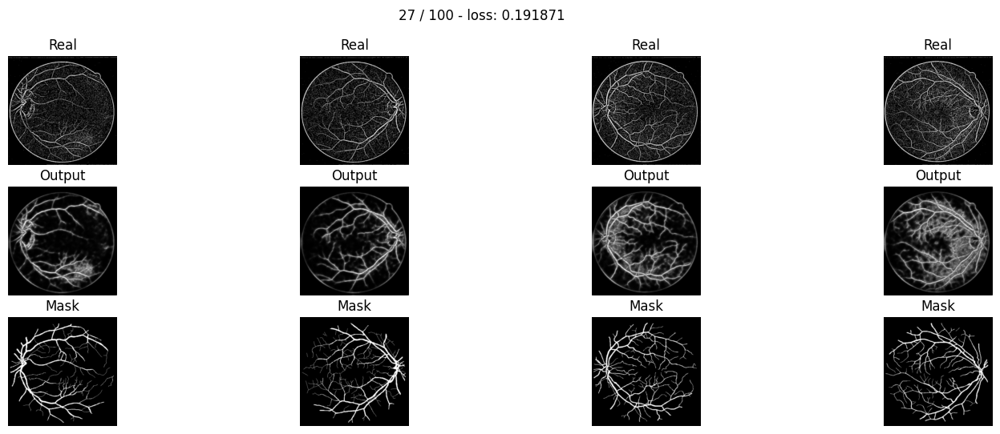

* Epoch 28/100
 - loss: 0.187679
tensor([[0.2056, 0.0875, 0.0626,  ..., 0.0951, 0.1174, 0.2301],
        [0.1015, 0.0219, 0.0125,  ..., 0.0270, 0.0388, 0.1335],
        [0.0818, 0.0150, 0.0081,  ..., 0.0208, 0.0310, 0.1184],
        ...,
        [0.0483, 0.0051, 0.0022,  ..., 0.0067, 0.0118, 0.0740],
        [0.0713, 0.0107, 0.0054,  ..., 0.0172, 0.0272, 0.1147],
        [0.1824, 0.0689, 0.0474,  ..., 0.1060, 0.1376, 0.2522]])
tensor([[0.2024, 0.0843, 0.0597,  ..., 0.0549, 0.0717, 0.1778],
        [0.0988, 0.0208, 0.0115,  ..., 0.0091, 0.0145, 0.0790],
        [0.0818, 0.0143, 0.0068,  ..., 0.0047, 0.0083, 0.0606],
        ...,
        [0.0483, 0.0051, 0.0022,  ..., 0.0068, 0.0121, 0.0754],
        [0.0713, 0.0107, 0.0054,  ..., 0.0187, 0.0285, 0.1169],
        [0.1824, 0.0689, 0.0475,  ..., 0.1158, 0.1422, 0.2550]])
tensor([[0.1955, 0.0770, 0.0525,  ..., 0.0947, 0.1171, 0.2298],
        [0.0920, 0.0174, 0.0090,  ..., 0.0268, 0.0386, 0.1331],
        [0.0746, 0.0114, 0.0049,  ..., 0.02

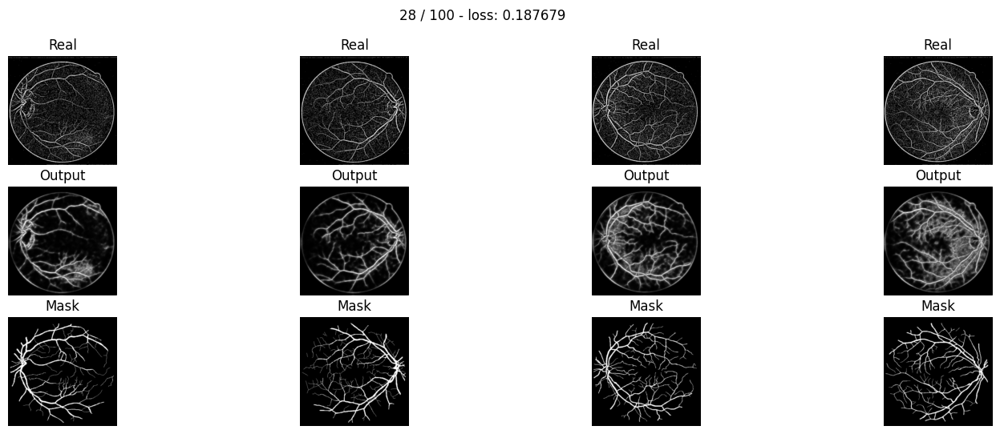

* Epoch 29/100
 - loss: 0.184638
tensor([[0.1877, 0.0719, 0.0489,  ..., 0.0797, 0.1019, 0.2150],
        [0.0845, 0.0152, 0.0080,  ..., 0.0196, 0.0299, 0.1177],
        [0.0652, 0.0097, 0.0047,  ..., 0.0141, 0.0228, 0.1020],
        ...,
        [0.0362, 0.0030, 0.0011,  ..., 0.0043, 0.0081, 0.0616],
        [0.0568, 0.0069, 0.0031,  ..., 0.0121, 0.0205, 0.1003],
        [0.1629, 0.0545, 0.0355,  ..., 0.0895, 0.1211, 0.2382]])
tensor([[0.1847, 0.0693, 0.0465,  ..., 0.0441, 0.0600, 0.1630],
        [0.0823, 0.0144, 0.0073,  ..., 0.0062, 0.0105, 0.0671],
        [0.0653, 0.0092, 0.0039,  ..., 0.0029, 0.0056, 0.0495],
        ...,
        [0.0363, 0.0030, 0.0011,  ..., 0.0043, 0.0084, 0.0628],
        [0.0568, 0.0069, 0.0031,  ..., 0.0132, 0.0215, 0.1022],
        [0.1629, 0.0546, 0.0355,  ..., 0.0983, 0.1253, 0.2407]])
tensor([[0.1771, 0.0622, 0.0401,  ..., 0.0793, 0.1015, 0.2147],
        [0.0755, 0.0117, 0.0055,  ..., 0.0194, 0.0297, 0.1173],
        [0.0586, 0.0071, 0.0027,  ..., 0.01

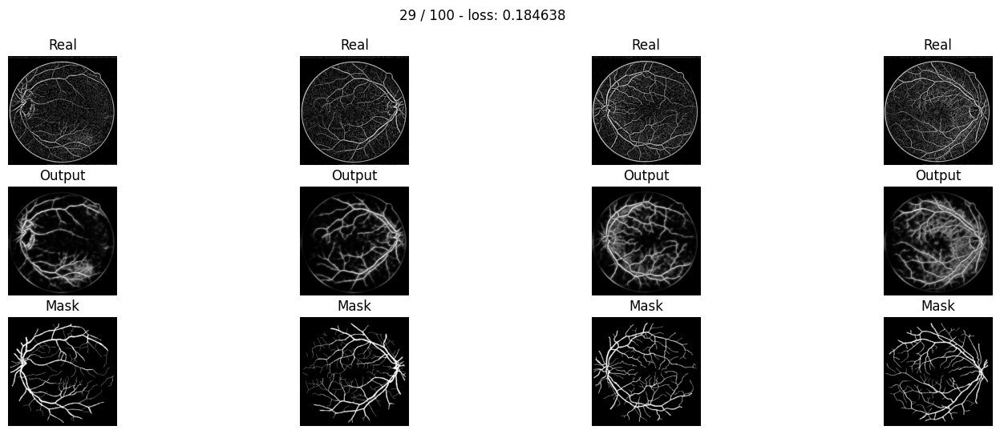

* Epoch 30/100
 - loss: 0.181224
tensor([[0.1933, 0.0765, 0.0528,  ..., 0.0891, 0.1112, 0.2237],
        [0.0901, 0.0173, 0.0093,  ..., 0.0245, 0.0358, 0.1279],
        [0.0707, 0.0114, 0.0057,  ..., 0.0189, 0.0289, 0.1141],
        ...,
        [0.0383, 0.0033, 0.0013,  ..., 0.0053, 0.0098, 0.0672],
        [0.0595, 0.0075, 0.0035,  ..., 0.0148, 0.0242, 0.1085],
        [0.1670, 0.0575, 0.0379,  ..., 0.1007, 0.1334, 0.2490]])
tensor([[0.1907, 0.0739, 0.0503,  ..., 0.0490, 0.0651, 0.1689],
        [0.0881, 0.0165, 0.0086,  ..., 0.0076, 0.0123, 0.0722],
        [0.0713, 0.0109, 0.0048,  ..., 0.0037, 0.0068, 0.0545],
        ...,
        [0.0383, 0.0033, 0.0013,  ..., 0.0054, 0.0099, 0.0682],
        [0.0595, 0.0075, 0.0035,  ..., 0.0161, 0.0253, 0.1103],
        [0.1670, 0.0575, 0.0379,  ..., 0.1106, 0.1378, 0.2514]])
tensor([[0.1829, 0.0664, 0.0433,  ..., 0.0889, 0.1109, 0.2234],
        [0.0808, 0.0134, 0.0064,  ..., 0.0244, 0.0356, 0.1277],
        [0.0640, 0.0084, 0.0033,  ..., 0.01

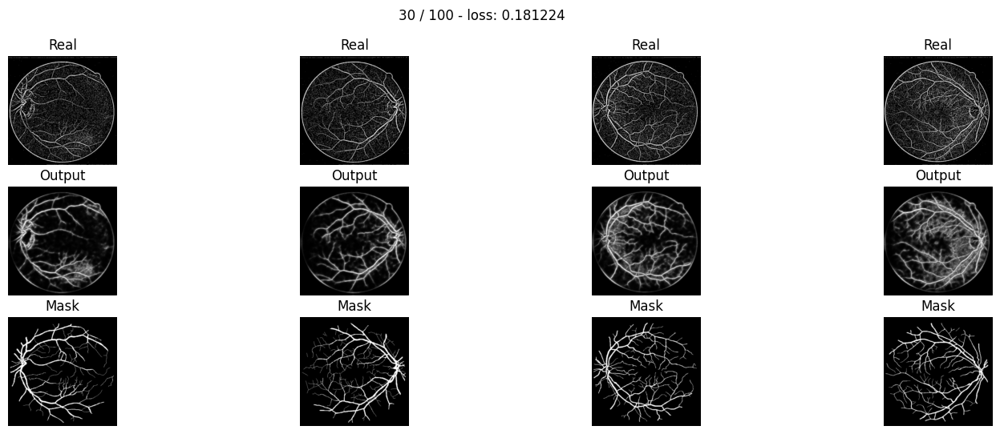

* Epoch 31/100
 - loss: 0.180219
tensor([[0.1756, 0.0623, 0.0406,  ..., 0.0717, 0.0936, 0.2063],
        [0.0745, 0.0119, 0.0059,  ..., 0.0166, 0.0261, 0.1099],
        [0.0558, 0.0072, 0.0033,  ..., 0.0118, 0.0198, 0.0952],
        ...,
        [0.0295, 0.0020, 0.0007,  ..., 0.0033, 0.0067, 0.0557],
        [0.0486, 0.0051, 0.0022,  ..., 0.0104, 0.0183, 0.0950],
        [0.1510, 0.0469, 0.0293,  ..., 0.0853, 0.1178, 0.2356]])
tensor([[0.1735, 0.0603, 0.0388,  ..., 0.0381, 0.0531, 0.1530],
        [0.0731, 0.0114, 0.0054,  ..., 0.0048, 0.0086, 0.0600],
        [0.0567, 0.0069, 0.0027,  ..., 0.0021, 0.0043, 0.0434],
        ...,
        [0.0295, 0.0020, 0.0007,  ..., 0.0034, 0.0068, 0.0566],
        [0.0485, 0.0051, 0.0022,  ..., 0.0114, 0.0191, 0.0966],
        [0.1510, 0.0468, 0.0293,  ..., 0.0941, 0.1218, 0.2380]])
tensor([[0.1650, 0.0533, 0.0327,  ..., 0.0715, 0.0934, 0.2061],
        [0.0660, 0.0089, 0.0039,  ..., 0.0165, 0.0260, 0.1097],
        [0.0498, 0.0052, 0.0018,  ..., 0.01

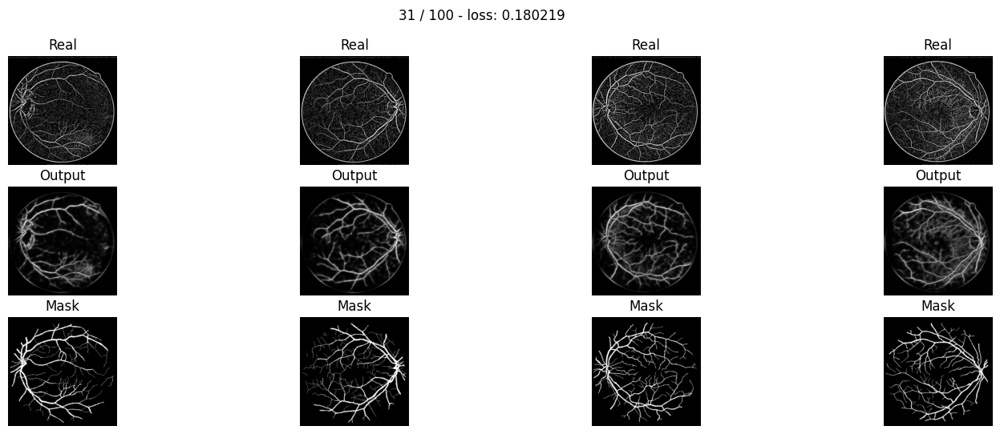

* Epoch 32/100
 - loss: 0.177024
tensor([[0.1807, 0.0663, 0.0438,  ..., 0.0746, 0.0967, 0.2092],
        [0.0795, 0.0135, 0.0068,  ..., 0.0181, 0.0282, 0.1138],
        [0.0607, 0.0085, 0.0040,  ..., 0.0134, 0.0221, 0.1002],
        ...,
        [0.0319, 0.0023, 0.0008,  ..., 0.0038, 0.0075, 0.0587],
        [0.0519, 0.0058, 0.0025,  ..., 0.0119, 0.0205, 0.1001],
        [0.1563, 0.0503, 0.0320,  ..., 0.0926, 0.1263, 0.2435]])
tensor([[0.1788, 0.0643, 0.0419,  ..., 0.0397, 0.0549, 0.1551],
        [0.0781, 0.0129, 0.0063,  ..., 0.0053, 0.0092, 0.0619],
        [0.0620, 0.0082, 0.0033,  ..., 0.0024, 0.0047, 0.0452],
        ...,
        [0.0319, 0.0023, 0.0008,  ..., 0.0038, 0.0076, 0.0595],
        [0.0519, 0.0058, 0.0025,  ..., 0.0129, 0.0213, 0.1016],
        [0.1562, 0.0503, 0.0319,  ..., 0.1022, 0.1304, 0.2457]])
tensor([[0.1700, 0.0567, 0.0352,  ..., 0.0745, 0.0965, 0.2090],
        [0.0705, 0.0101, 0.0045,  ..., 0.0181, 0.0281, 0.1136],
        [0.0544, 0.0061, 0.0022,  ..., 0.01

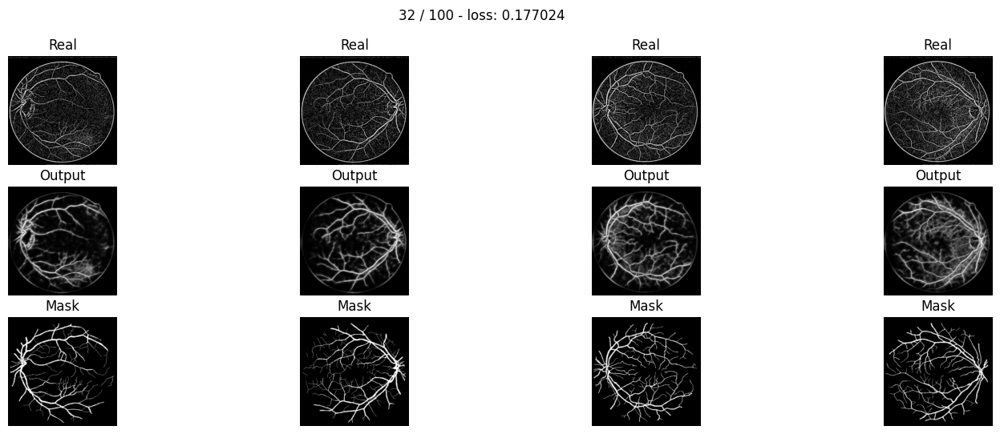

* Epoch 33/100
 - loss: 0.173455
tensor([[0.1698, 0.0583, 0.0371,  ..., 0.0645, 0.0860, 0.1976],
        [0.0706, 0.0108, 0.0051,  ..., 0.0141, 0.0229, 0.1026],
        [0.0526, 0.0065, 0.0029,  ..., 0.0100, 0.0174, 0.0891],
        ...,
        [0.0273, 0.0018, 0.0006,  ..., 0.0029, 0.0059, 0.0522],
        [0.0460, 0.0046, 0.0019,  ..., 0.0097, 0.0173, 0.0924],
        [0.1472, 0.0447, 0.0276,  ..., 0.0844, 0.1180, 0.2363]])
tensor([[0.1681, 0.0566, 0.0356,  ..., 0.0336, 0.0479, 0.1450],
        [0.0695, 0.0103, 0.0048,  ..., 0.0039, 0.0072, 0.0546],
        [0.0539, 0.0063, 0.0024,  ..., 0.0017, 0.0035, 0.0389],
        ...,
        [0.0273, 0.0018, 0.0006,  ..., 0.0029, 0.0060, 0.0528],
        [0.0460, 0.0046, 0.0019,  ..., 0.0105, 0.0180, 0.0937],
        [0.1472, 0.0447, 0.0276,  ..., 0.0936, 0.1220, 0.2384]])
tensor([[0.1589, 0.0494, 0.0295,  ..., 0.0644, 0.0859, 0.1975],
        [0.0621, 0.0080, 0.0033,  ..., 0.0140, 0.0229, 0.1025],
        [0.0467, 0.0046, 0.0015,  ..., 0.01

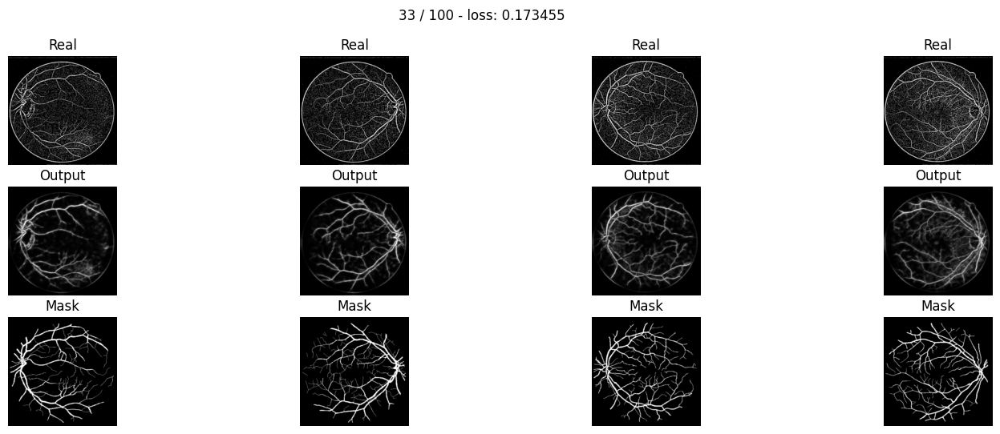

* Epoch 34/100
 - loss: 0.172931
tensor([[0.1631, 0.0538, 0.0335,  ..., 0.0584, 0.0797, 0.1904],
        [0.0657, 0.0094, 0.0043,  ..., 0.0120, 0.0202, 0.0963],
        [0.0482, 0.0056, 0.0024,  ..., 0.0084, 0.0152, 0.0832],
        ...,
        [0.0253, 0.0015, 0.0005,  ..., 0.0025, 0.0053, 0.0494],
        [0.0434, 0.0042, 0.0017,  ..., 0.0089, 0.0162, 0.0895],
        [0.1431, 0.0424, 0.0258,  ..., 0.0818, 0.1158, 0.2346]])
tensor([[0.1615, 0.0523, 0.0321,  ..., 0.0303, 0.0441, 0.1390],
        [0.0647, 0.0090, 0.0040,  ..., 0.0033, 0.0063, 0.0507],
        [0.0496, 0.0054, 0.0020,  ..., 0.0013, 0.0030, 0.0356],
        ...,
        [0.0253, 0.0015, 0.0005,  ..., 0.0025, 0.0053, 0.0499],
        [0.0434, 0.0042, 0.0017,  ..., 0.0096, 0.0168, 0.0907],
        [0.1430, 0.0423, 0.0258,  ..., 0.0911, 0.1197, 0.2367]])
tensor([[0.1523, 0.0453, 0.0264,  ..., 0.0585, 0.0797, 0.1905],
        [0.0574, 0.0069, 0.0028,  ..., 0.0120, 0.0202, 0.0963],
        [0.0427, 0.0039, 0.0012,  ..., 0.00

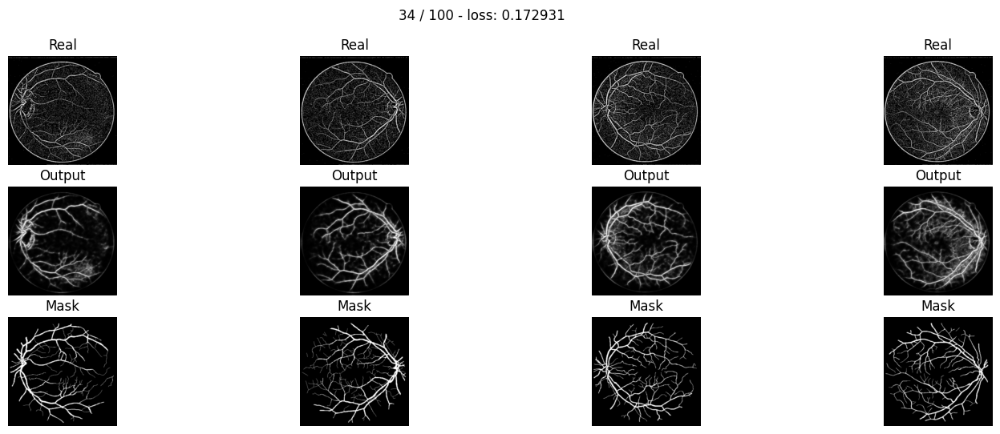

* Epoch 35/100
 - loss: 0.168932
tensor([[0.1610, 0.0526, 0.0325,  ..., 0.0588, 0.0797, 0.1899],
        [0.0645, 0.0091, 0.0042,  ..., 0.0122, 0.0204, 0.0964],
        [0.0473, 0.0054, 0.0023,  ..., 0.0089, 0.0158, 0.0846],
        ...,
        [0.0239, 0.0014, 0.0004,  ..., 0.0025, 0.0053, 0.0488],
        [0.0416, 0.0039, 0.0016,  ..., 0.0090, 0.0164, 0.0895],
        [0.1399, 0.0408, 0.0247,  ..., 0.0834, 0.1177, 0.2364]])
tensor([[0.1592, 0.0510, 0.0311,  ..., 0.0305, 0.0441, 0.1385],
        [0.0633, 0.0087, 0.0039,  ..., 0.0034, 0.0063, 0.0506],
        [0.0487, 0.0053, 0.0019,  ..., 0.0014, 0.0030, 0.0358],
        ...,
        [0.0239, 0.0014, 0.0004,  ..., 0.0025, 0.0053, 0.0492],
        [0.0416, 0.0039, 0.0016,  ..., 0.0097, 0.0169, 0.0905],
        [0.1398, 0.0407, 0.0246,  ..., 0.0931, 0.1217, 0.2384]])
tensor([[0.1501, 0.0442, 0.0256,  ..., 0.0590, 0.0800, 0.1902],
        [0.0562, 0.0067, 0.0027,  ..., 0.0123, 0.0206, 0.0967],
        [0.0419, 0.0038, 0.0012,  ..., 0.00

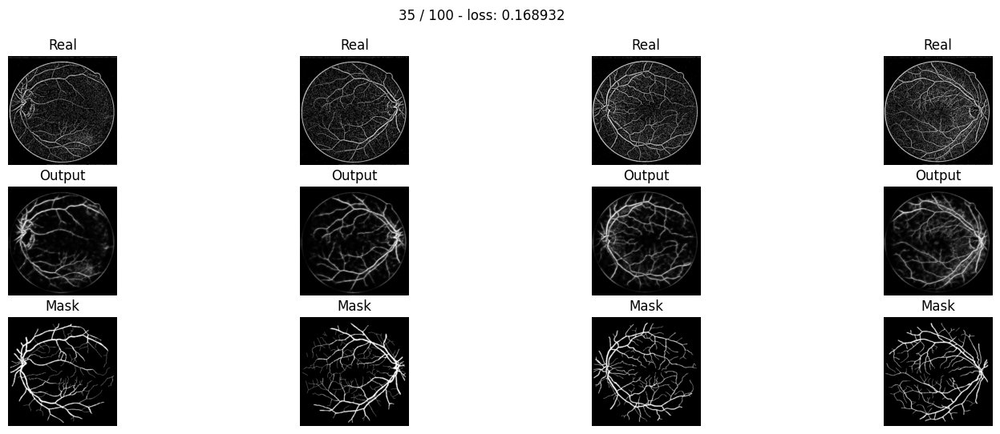

* Epoch 36/100
 - loss: 0.167882
tensor([[0.1439, 0.0421, 0.0246,  ..., 0.0483, 0.0684, 0.1765],
        [0.0520, 0.0061, 0.0026,  ..., 0.0087, 0.0156, 0.0843],
        [0.0363, 0.0034, 0.0013,  ..., 0.0059, 0.0116, 0.0725],
        ...,
        [0.0183, 0.0009, 0.0003,  ..., 0.0017, 0.0039, 0.0418],
        [0.0337, 0.0027, 0.0010,  ..., 0.0067, 0.0130, 0.0802],
        [0.1257, 0.0332, 0.0192,  ..., 0.0730, 0.1066, 0.2263]])
tensor([[0.1422, 0.0407, 0.0235,  ..., 0.0245, 0.0371, 0.1270],
        [0.0511, 0.0059, 0.0024,  ..., 0.0023, 0.0046, 0.0431],
        [0.0374, 0.0033, 0.0011,  ..., 0.0009, 0.0021, 0.0295],
        ...,
        [0.0183, 0.0009, 0.0002,  ..., 0.0017, 0.0039, 0.0421],
        [0.0337, 0.0027, 0.0010,  ..., 0.0073, 0.0135, 0.0812],
        [0.1256, 0.0331, 0.0191,  ..., 0.0820, 0.1105, 0.2284]])
tensor([[0.1332, 0.0349, 0.0191,  ..., 0.0484, 0.0685, 0.1766],
        [0.0448, 0.0044, 0.0016,  ..., 0.0088, 0.0157, 0.0845],
        [0.0317, 0.0023, 0.0006,  ..., 0.00

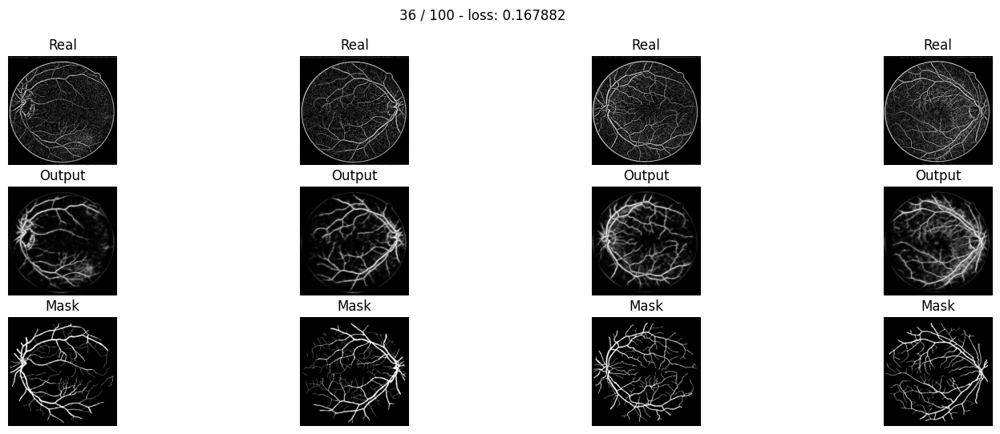

* Epoch 37/100
 - loss: 0.166814
tensor([[1.3400e-01, 3.6661e-02, 2.0699e-02,  ..., 4.3505e-02, 6.2987e-02,
         1.6938e-01],
        [4.5587e-02, 4.8234e-03, 1.9148e-03,  ..., 7.3116e-03, 1.3561e-02,
         7.8483e-02],
        [3.0835e-02, 2.5311e-03, 9.0616e-04,  ..., 4.8949e-03, 9.9470e-03,
         6.7140e-02],
        ...,
        [1.4856e-02, 6.0646e-04, 1.6037e-04,  ..., 1.3286e-03, 3.1432e-03,
         3.7388e-02],
        [2.8585e-02, 1.9844e-03, 6.9031e-04,  ..., 5.5516e-03, 1.1188e-02,
         7.4326e-02],
        [1.1524e-01, 2.8139e-02, 1.5680e-02,  ..., 6.6776e-02, 9.9943e-02,
         2.1998e-01]])
tensor([[1.3246e-01, 3.5486e-02, 1.9779e-02,  ..., 2.1849e-02, 3.3780e-02,
         1.2105e-01],
        [4.4670e-02, 4.5989e-03, 1.7607e-03,  ..., 1.8840e-03, 3.9375e-03,
         3.9477e-02],
        [3.1823e-02, 2.4574e-03, 7.3755e-04,  ..., 6.8470e-04, 1.7138e-03,
         2.6527e-02],
        ...,
        [1.4821e-02, 6.0417e-04, 1.5970e-04,  ..., 1.2848e-03, 3.11

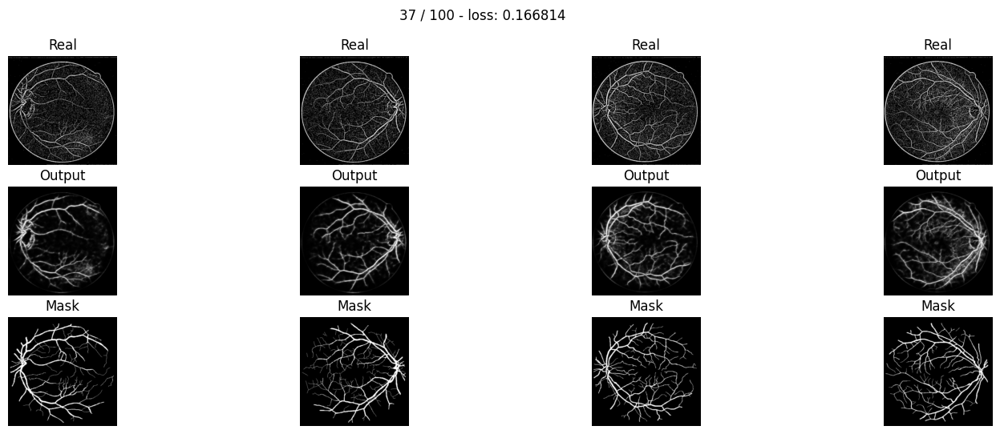

* Epoch 38/100
 - loss: 0.163734
tensor([[1.2923e-01, 3.4231e-02, 1.8975e-02,  ..., 4.1065e-02, 6.0094e-02,
         1.6525e-01],
        [4.2721e-02, 4.3027e-03, 1.6611e-03,  ..., 6.6727e-03, 1.2583e-02,
         7.5352e-02],
        [2.8543e-02, 2.2235e-03, 7.7355e-04,  ..., 4.4795e-03, 9.2756e-03,
         6.4669e-02],
        ...,
        [1.3041e-02, 4.8440e-04, 1.2201e-04,  ..., 1.1081e-03, 2.7063e-03,
         3.4513e-02],
        [2.5768e-02, 1.6546e-03, 5.5374e-04,  ..., 4.8748e-03, 1.0084e-02,
         7.0511e-02],
        [1.0896e-01, 2.5375e-02, 1.3818e-02,  ..., 6.2973e-02, 9.5867e-02,
         2.1611e-01]])
tensor([[1.2764e-01, 3.3059e-02, 1.8075e-02,  ..., 2.0573e-02, 3.2121e-02,
         1.1776e-01],
        [4.1756e-02, 4.0788e-03, 1.5169e-03,  ..., 1.7006e-03, 3.6129e-03,
         3.7592e-02],
        [2.9436e-02, 2.1456e-03, 6.2140e-04,  ..., 6.0619e-04, 1.5488e-03,
         2.5093e-02],
        ...,
        [1.3005e-02, 4.8226e-04, 1.2142e-04,  ..., 1.0654e-03, 2.67

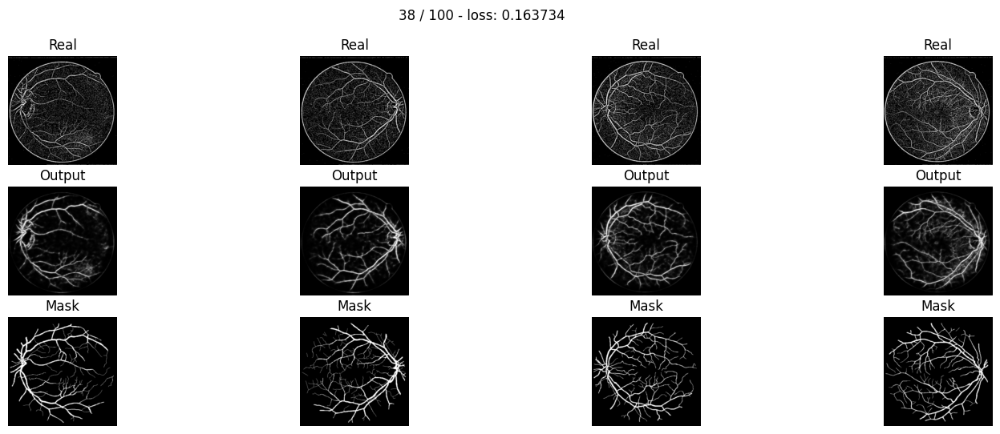

* Epoch 39/100
 - loss: 0.160917
tensor([[1.2493e-01, 3.2102e-02, 1.7478e-02,  ..., 3.8616e-02, 5.7372e-02,
         1.6154e-01],
        [4.0231e-02, 3.8739e-03, 1.4563e-03,  ..., 6.0632e-03, 1.1703e-02,
         7.2641e-02],
        [2.6579e-02, 1.9736e-03, 6.6779e-04,  ..., 4.0611e-03, 8.6420e-03,
         6.2479e-02],
        ...,
        [1.1724e-02, 4.0330e-04, 9.7431e-05,  ..., 9.4414e-04, 2.3833e-03,
         3.2326e-02],
        [2.3676e-02, 1.4275e-03, 4.6223e-04,  ..., 4.3596e-03, 9.2742e-03,
         6.7735e-02],
        [1.0404e-01, 2.3298e-02, 1.2432e-02,  ..., 6.0063e-02, 9.2965e-02,
         2.1343e-01]])
tensor([[1.2330e-01, 3.0936e-02, 1.6601e-02,  ..., 1.9326e-02, 3.0594e-02,
         1.1487e-01],
        [3.9245e-02, 3.6547e-03, 1.3216e-03,  ..., 1.5312e-03, 3.3265e-03,
         3.5974e-02],
        [2.7419e-02, 1.8957e-03, 5.3018e-04,  ..., 5.3250e-04, 1.3997e-03,
         2.3822e-02],
        ...,
        [1.1685e-02, 4.0107e-04, 9.6824e-05,  ..., 9.0347e-04, 2.34

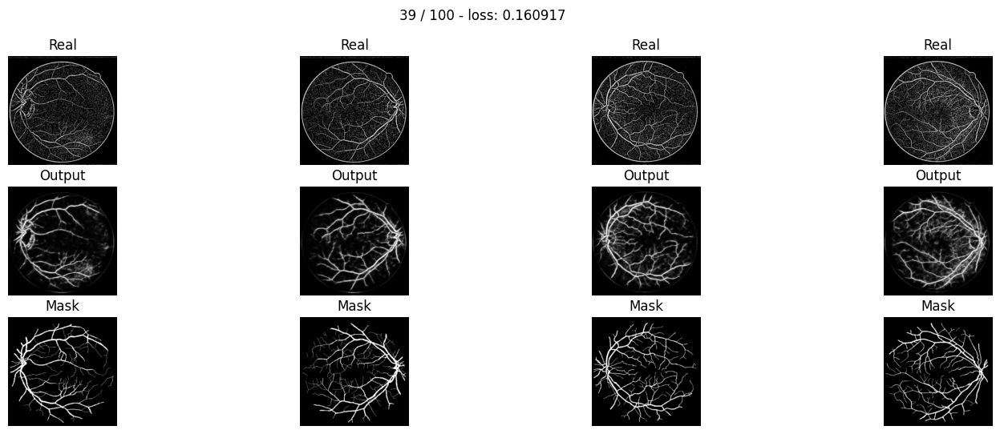

* Epoch 40/100
 - loss: 0.159727
tensor([[1.1797e-01, 2.8771e-02, 1.5220e-02,  ..., 3.5071e-02, 5.3081e-02,
         1.5524e-01],
        [3.6224e-02, 3.2088e-03, 1.1537e-03,  ..., 5.1734e-03, 1.0281e-02,
         6.7818e-02],
        [2.3404e-02, 1.5826e-03, 5.0960e-04,  ..., 3.4271e-03, 7.5475e-03,
         5.8199e-02],
        ...,
        [9.6539e-03, 2.8735e-04, 6.4500e-05,  ..., 7.0816e-04, 1.8835e-03,
         2.8532e-02],
        [2.0282e-02, 1.0853e-03, 3.3156e-04,  ..., 3.5193e-03, 7.8103e-03,
         6.2090e-02],
        [9.5722e-02, 1.9950e-02, 1.0280e-02,  ..., 5.4159e-02, 8.6175e-02,
         2.0639e-01]])
tensor([[1.1628e-01, 2.7639e-02, 1.4394e-02,  ..., 1.7358e-02, 2.8019e-02,
         1.0968e-01],
        [3.5236e-02, 3.0076e-03, 1.0383e-03,  ..., 1.2727e-03, 2.8543e-03,
         3.3081e-02],
        [2.4126e-02, 1.5102e-03, 3.9894e-04,  ..., 4.2637e-04, 1.1662e-03,
         2.1591e-02],
        ...,
        [9.6147e-03, 2.8547e-04, 6.4025e-05,  ..., 6.7325e-04, 1.84

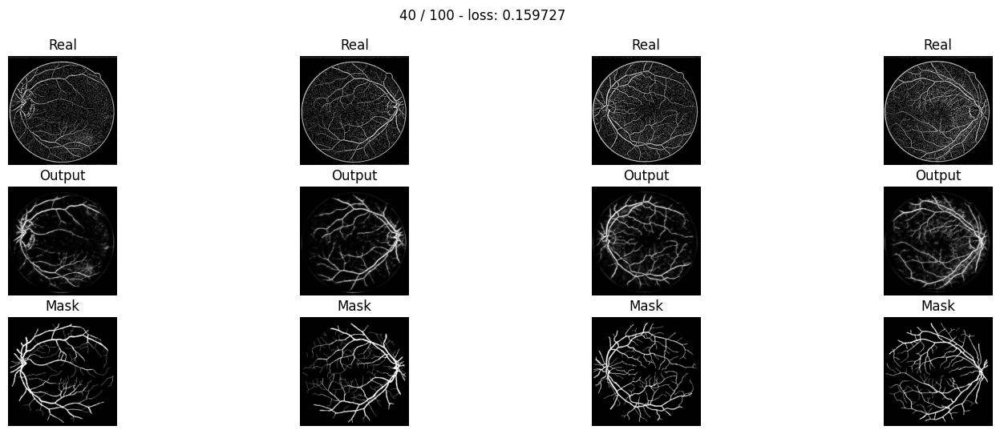

* Epoch 41/100
 - loss: 0.157917
tensor([[1.1888e-01, 2.9313e-02, 1.5544e-02,  ..., 3.6654e-02, 5.4886e-02,
         1.5742e-01],
        [3.6967e-02, 3.3555e-03, 1.2135e-03,  ..., 5.6914e-03, 1.1094e-02,
         7.0196e-02],
        [2.4127e-02, 1.6918e-03, 5.5236e-04,  ..., 3.9649e-03, 8.5007e-03,
         6.1629e-02],
        ...,
        [9.4347e-03, 2.7877e-04, 6.2010e-05,  ..., 7.3959e-04, 1.9490e-03,
         2.8918e-02],
        [1.9924e-02, 1.0604e-03, 3.2156e-04,  ..., 3.7045e-03, 8.1842e-03,
         6.3463e-02],
        [9.4667e-02, 1.9623e-02, 1.0066e-02,  ..., 5.6663e-02, 8.9617e-02,
         2.1009e-01]])
tensor([[1.1711e-01, 2.8100e-02, 1.4650e-02,  ..., 1.8232e-02, 2.9082e-02,
         1.1147e-01],
        [3.5915e-02, 3.1306e-03, 1.0849e-03,  ..., 1.3955e-03, 3.0683e-03,
         3.4194e-02],
        [2.4892e-02, 1.6078e-03, 4.2729e-04,  ..., 4.8031e-04, 1.2810e-03,
         2.2609e-02],
        ...,
        [9.3903e-03, 2.7665e-04, 6.1477e-05,  ..., 6.9695e-04, 1.90

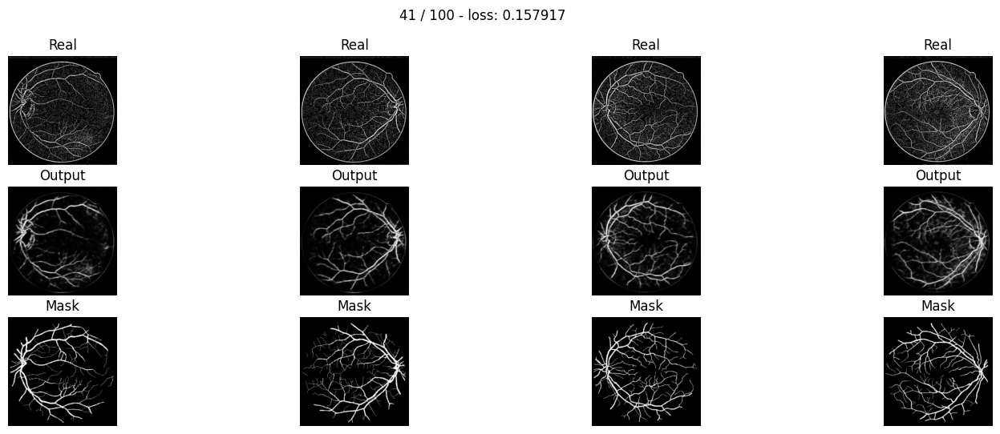

* Epoch 42/100
 - loss: 0.156014
tensor([[1.0633e-01, 2.3704e-02, 1.1912e-02,  ..., 3.0389e-02, 4.7662e-02,
         1.4719e-01],
        [3.0055e-02, 2.3194e-03, 7.7227e-04,  ..., 4.1548e-03, 8.7168e-03,
         6.2365e-02],
        [1.8637e-02, 1.0780e-03, 3.1849e-04,  ..., 2.7246e-03, 6.4098e-03,
         5.3709e-02],
        ...,
        [7.1001e-03, 1.6992e-04, 3.3966e-05,  ..., 4.8384e-04, 1.3957e-03,
         2.4396e-02],
        [1.5917e-02, 7.1370e-04, 1.9910e-04,  ..., 2.7015e-03, 6.4132e-03,
         5.6353e-02],
        [8.4316e-02, 1.5818e-02, 7.7137e-03,  ..., 4.8565e-02, 8.0259e-02,
         2.0012e-01]])
tensor([[1.0476e-01, 2.2704e-02, 1.1207e-02,  ..., 1.4916e-02, 2.4929e-02,
         1.0333e-01],
        [2.9202e-02, 2.1596e-03, 6.8775e-04,  ..., 9.8907e-04, 2.3438e-03,
         2.9792e-02],
        [1.9284e-02, 1.0237e-03, 2.4422e-04,  ..., 3.1124e-04, 9.1439e-04,
         1.9038e-02],
        ...,
        [7.0643e-03, 1.6854e-04, 3.3657e-05,  ..., 4.5291e-04, 1.35

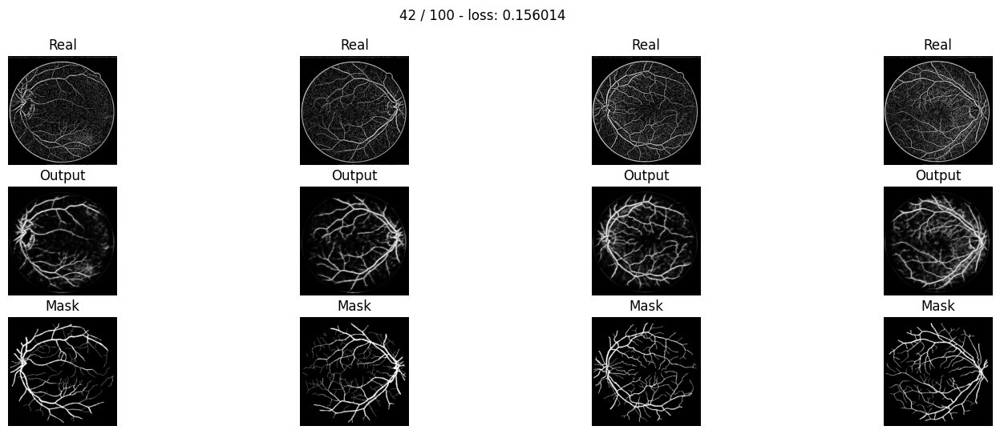

* Epoch 43/100
 - loss: 0.155422
tensor([[1.0345e-01, 2.2578e-02, 1.1194e-02,  ..., 2.9182e-02, 4.6005e-02,
         1.4424e-01],
        [2.8718e-02, 2.1484e-03, 7.0139e-04,  ..., 3.9278e-03, 8.2972e-03,
         6.0520e-02],
        [1.7708e-02, 9.9426e-04, 2.8845e-04,  ..., 2.6199e-03, 6.1988e-03,
         5.2567e-02],
        ...,
        [6.3297e-03, 1.3996e-04, 2.6799e-05,  ..., 4.0691e-04, 1.2088e-03,
         2.2529e-02],
        [1.4526e-02, 6.1024e-04, 1.6449e-04,  ..., 2.3878e-03, 5.8135e-03,
         5.3515e-02],
        [8.0130e-02, 1.4429e-02, 6.8914e-03,  ..., 4.6144e-02, 7.7398e-02,
         1.9690e-01]])
tensor([[1.0187e-01, 2.1574e-02, 1.0490e-02,  ..., 1.4266e-02, 2.3963e-02,
         1.0097e-01],
        [2.7858e-02, 1.9902e-03, 6.1998e-04,  ..., 9.1997e-04, 2.1964e-03,
         2.8627e-02],
        [1.8332e-02, 9.3982e-04, 2.1828e-04,  ..., 2.8691e-04, 8.5033e-04,
         1.8231e-02],
        ...,
        [6.2917e-03, 1.3861e-04, 2.6506e-05,  ..., 3.7849e-04, 1.16

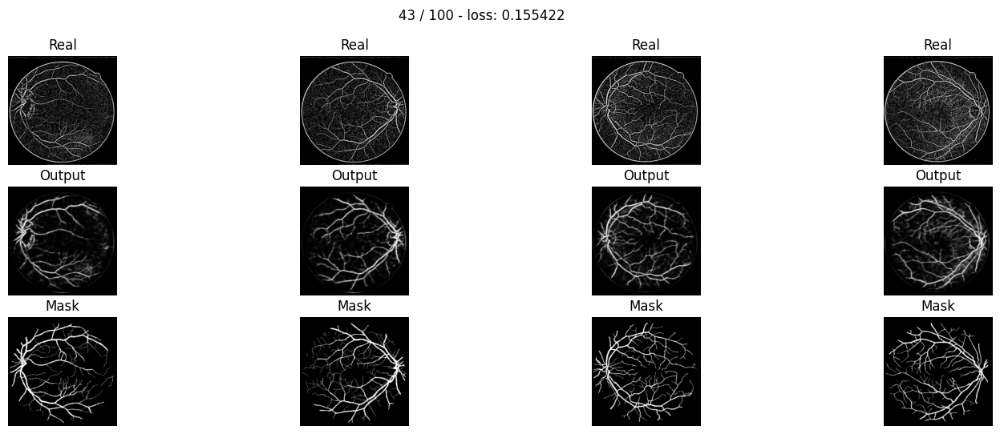

* Epoch 44/100
 - loss: 0.155546
tensor([[1.0313e-01, 2.2551e-02, 1.1173e-02,  ..., 2.9796e-02, 4.6637e-02,
         1.4481e-01],
        [2.8745e-02, 2.1697e-03, 7.0919e-04,  ..., 4.1349e-03, 8.6240e-03,
         6.1469e-02],
        [1.7851e-02, 1.0214e-03, 2.9868e-04,  ..., 2.8755e-03, 6.6789e-03,
         5.4403e-02],
        ...,
        [6.0516e-03, 1.3072e-04, 2.4654e-05,  ..., 4.0038e-04, 1.1856e-03,
         2.2133e-02],
        [1.4003e-02, 5.7694e-04, 1.5348e-04,  ..., 2.3950e-03, 5.8185e-03,
         5.3271e-02],
        [7.8650e-02, 1.4001e-02, 6.6407e-03,  ..., 4.6978e-02, 7.8743e-02,
         1.9849e-01]])
tensor([[1.0156e-01, 2.1524e-02, 1.0445e-02,  ..., 1.4602e-02, 2.4325e-02,
         1.0143e-01],
        [2.7880e-02, 2.0041e-03, 6.2377e-04,  ..., 9.6183e-04, 2.2652e-03,
         2.8945e-02],
        [1.8519e-02, 9.6373e-04, 2.2378e-04,  ..., 3.0532e-04, 8.8957e-04,
         1.8587e-02],
        ...,
        [6.0111e-03, 1.2931e-04, 2.4354e-05,  ..., 3.7007e-04, 1.14

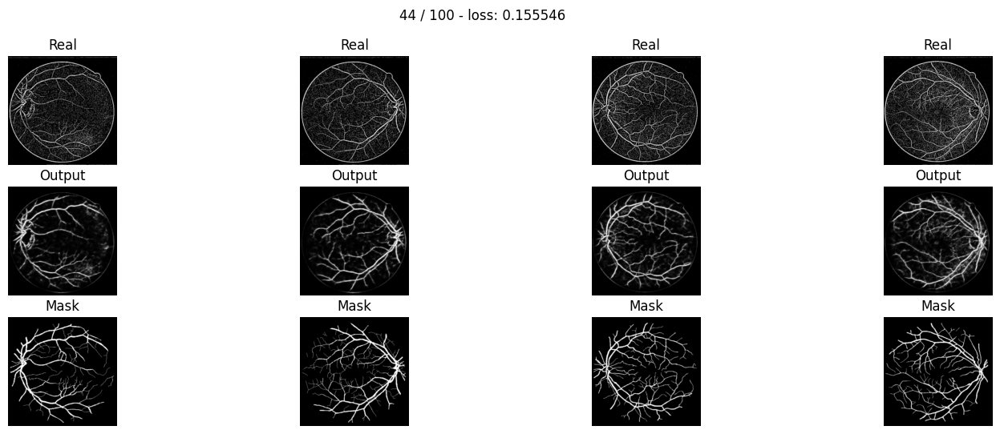

* Epoch 45/100
 - loss: 0.152593
tensor([[8.2908e-02, 1.4946e-02, 6.6971e-03,  ..., 1.9663e-02, 3.3820e-02,
         1.2388e-01],
        [1.9183e-02, 1.0522e-03, 2.9344e-04,  ..., 2.0250e-03, 4.9061e-03,
         4.6241e-02],
        [1.0740e-02, 4.1841e-04, 1.0047e-04,  ..., 1.2003e-03, 3.3672e-03,
         3.8493e-02],
        ...,
        [3.4401e-03, 4.8733e-05, 7.4550e-06,  ..., 1.5427e-04, 5.5540e-04,
         1.4999e-02],
        [8.9437e-03, 2.6095e-04, 5.8938e-05,  ..., 1.1382e-03, 3.2316e-03,
         3.9801e-02],
        [6.1384e-02, 8.8705e-03, 3.8040e-03,  ..., 3.1562e-02, 5.8368e-02,
         1.7350e-01]])
tensor([[8.1686e-02, 1.4269e-02, 6.2596e-03,  ..., 9.3757e-03, 1.7206e-02,
         8.5314e-02],
        [1.8627e-02, 9.7226e-04, 2.5796e-04,  ..., 4.4787e-04, 1.2320e-03,
         2.1092e-02],
        [1.1192e-02, 3.9570e-04, 7.4903e-05,  ..., 1.1734e-04, 4.1652e-04,
         1.2514e-02],
        ...,
        [3.4159e-03, 4.8191e-05, 7.3621e-06,  ..., 1.4213e-04, 5.33

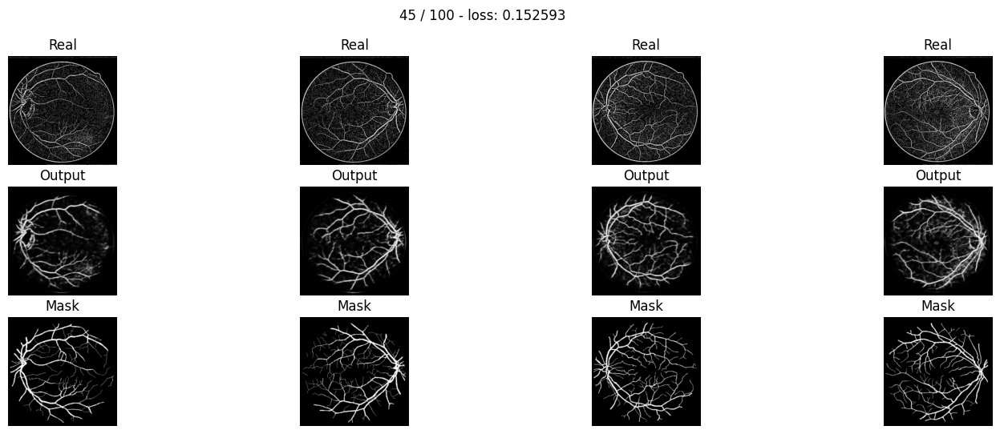

* Epoch 46/100
 - loss: 0.151513
tensor([[9.0316e-02, 1.7657e-02, 8.2380e-03,  ..., 2.3480e-02, 3.8513e-02,
         1.3129e-01],
        [2.2686e-02, 1.4326e-03, 4.2693e-04,  ..., 2.8051e-03, 6.2851e-03,
         5.1940e-02],
        [1.3401e-02, 6.2629e-04, 1.6485e-04,  ..., 1.8702e-03, 4.7324e-03,
         4.5342e-02],
        ...,
        [3.9083e-03, 6.1735e-05, 9.9447e-06,  ..., 1.9758e-04, 6.6823e-04,
         1.6319e-02],
        [9.8793e-03, 3.1453e-04, 7.3843e-05,  ..., 1.4001e-03, 3.7949e-03,
         4.2851e-02],
        [6.4585e-02, 9.7861e-03, 4.2954e-03,  ..., 3.5943e-02, 6.4443e-02,
         1.8127e-01]])
tensor([[8.8885e-02, 1.6796e-02, 7.6547e-03,  ..., 1.1249e-02, 1.9674e-02,
         9.0709e-02],
        [2.1977e-02, 1.3141e-03, 3.7147e-04,  ..., 6.1794e-04, 1.5703e-03,
         2.3663e-02],
        [1.3955e-02, 5.8818e-04, 1.2090e-04,  ..., 1.7811e-04, 5.7061e-04,
         1.4589e-02],
        ...,
        [3.8745e-03, 6.0876e-05, 9.7877e-06,  ..., 1.8033e-04, 6.38

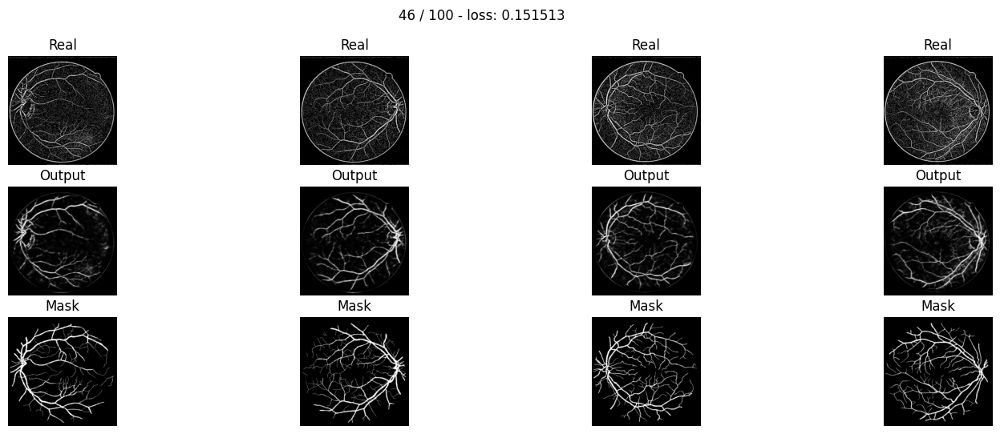

* Epoch 47/100
 - loss: 0.150961
tensor([[7.4446e-02, 1.2294e-02, 5.2495e-03,  ..., 1.6318e-02, 2.8995e-02,
         1.1411e-01],
        [1.5928e-02, 7.6145e-04, 1.9726e-04,  ..., 1.5075e-03, 3.8342e-03,
         4.0312e-02],
        [8.6074e-03, 2.8789e-04, 6.3706e-05,  ..., 8.7798e-04, 2.6055e-03,
         3.3379e-02],
        ...,
        [2.3390e-03, 2.5182e-05, 3.3468e-06,  ..., 8.3525e-05, 3.3525e-04,
         1.1385e-02],
        [6.5567e-03, 1.5251e-04, 3.0783e-05,  ..., 7.1376e-04, 2.2178e-03,
         3.2653e-02],
        [5.1343e-02, 6.4350e-03, 2.5744e-03,  ..., 2.4975e-02, 4.8846e-02,
         1.5975e-01]])
tensor([[7.3226e-02, 1.1675e-02, 4.8657e-03,  ..., 7.6783e-03, 1.4563e-02,
         7.7863e-02],
        [1.5419e-02, 6.9641e-04, 1.7090e-04,  ..., 3.2042e-04, 9.2750e-04,
         1.7936e-02],
        [8.9834e-03, 2.6995e-04, 4.6286e-05,  ..., 7.8386e-05, 2.9638e-04,
         1.0325e-02],
        ...,
        [2.3192e-03, 2.4845e-05, 3.2965e-06,  ..., 7.6136e-05, 3.20

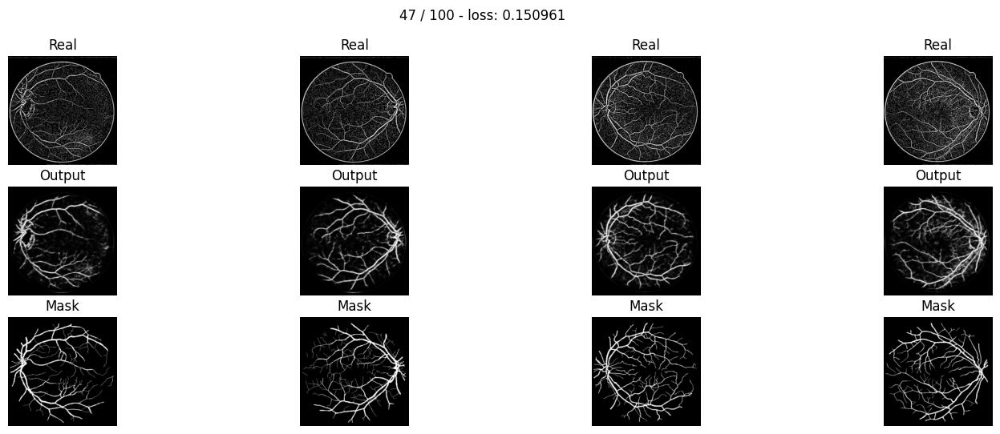

* Epoch 48/100
 - loss: 0.149200
tensor([[7.1370e-02, 1.1402e-02, 4.7764e-03,  ..., 1.5157e-02, 2.7254e-02,
         1.1028e-01],
        [1.4835e-02, 6.7391e-04, 1.6957e-04,  ..., 1.3467e-03, 3.4840e-03,
         3.8139e-02],
        [7.9102e-03, 2.5015e-04, 5.3620e-05,  ..., 7.8175e-04, 2.3654e-03,
         3.1562e-02],
        ...,
        [1.9643e-03, 1.8714e-05, 2.3317e-06,  ..., 6.4119e-05, 2.6956e-04,
         1.0087e-02],
        [5.6992e-03, 1.1993e-04, 2.2981e-05,  ..., 5.8562e-04, 1.8906e-03,
         2.9963e-02],
        [4.7239e-02, 5.5646e-03, 2.1603e-03,  ..., 2.2536e-02, 4.5193e-02,
         1.5399e-01]])
tensor([[7.0134e-02, 1.0797e-02, 4.4071e-03,  ..., 7.1116e-03, 1.3645e-02,
         7.5049e-02],
        [1.4336e-02, 6.1301e-04, 1.4577e-04,  ..., 2.8257e-04, 8.3216e-04,
         1.6821e-02],
        [8.2584e-03, 2.3344e-04, 3.8451e-05,  ..., 6.7364e-05, 2.6022e-04,
         9.5713e-03],
        ...,
        [1.9458e-03, 1.8435e-05, 2.2925e-06,  ..., 5.7887e-05, 2.55

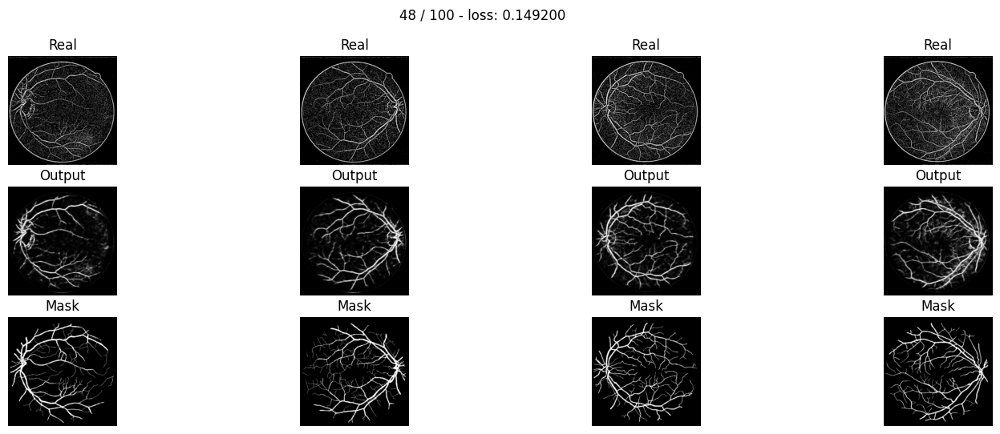

* Epoch 49/100
 - loss: 0.148286
tensor([[7.1232e-02, 1.1434e-02, 4.8010e-03,  ..., 1.6033e-02, 2.8331e-02,
         1.1197e-01],
        [1.4889e-02, 6.8516e-04, 1.7336e-04,  ..., 1.5077e-03, 3.7852e-03,
         3.9518e-02],
        [7.9958e-03, 2.5869e-04, 5.6152e-05,  ..., 9.2464e-04, 2.6867e-03,
         3.3467e-02],
        ...,
        [1.8345e-03, 1.6884e-05, 2.0695e-06,  ..., 6.6824e-05, 2.7615e-04,
         1.0120e-02],
        [5.3905e-03, 1.1021e-04, 2.0819e-05,  ..., 6.1269e-04, 1.9552e-03,
         3.0293e-02],
        [4.5605e-02, 5.2653e-03, 2.0281e-03,  ..., 2.3323e-02, 4.6446e-02,
         1.5576e-01]])
tensor([[6.9888e-02, 1.0783e-02, 4.4032e-03,  ..., 7.5293e-03, 1.4195e-02,
         7.6248e-02],
        [1.4347e-02, 6.1853e-04, 1.4750e-04,  ..., 3.1370e-04, 8.9682e-04,
         1.7357e-02],
        [8.3365e-03, 2.3959e-04, 3.9623e-05,  ..., 7.7387e-05, 2.8761e-04,
         1.0011e-02],
        ...,
        [1.8150e-03, 1.6599e-05, 2.0301e-06,  ..., 5.9642e-05, 2.59

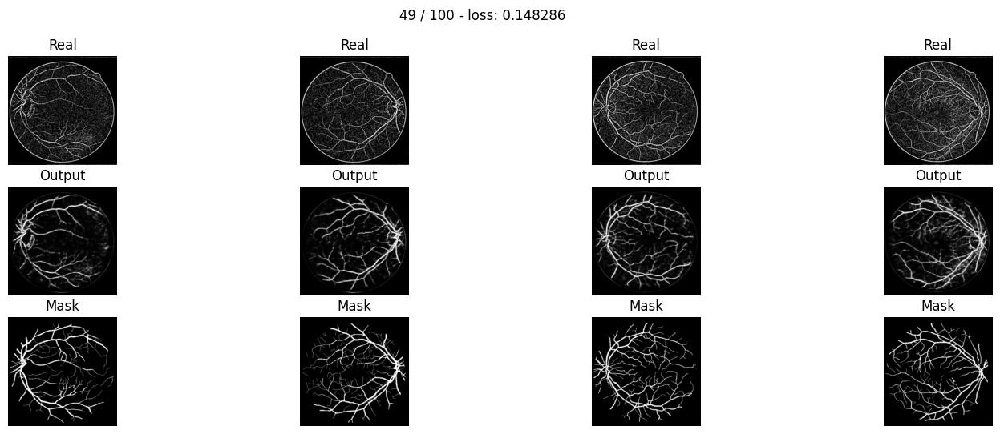

* Epoch 50/100
 - loss: 0.147546
tensor([[5.9825e-02, 8.3350e-03, 3.2478e-03,  ..., 1.2531e-02, 2.3415e-02,
         1.0179e-01],
        [1.0884e-02, 3.9670e-04, 8.9178e-05,  ..., 9.9830e-04, 2.7357e-03,
         3.3401e-02],
        [5.3918e-03, 1.3151e-04, 2.4648e-05,  ..., 5.6004e-04, 1.8176e-03,
         2.7330e-02],
        ...,
        [1.1635e-03, 7.7577e-06, 8.1080e-07,  ..., 3.8513e-05, 1.7814e-04,
         8.0288e-03],
        [3.7539e-03, 5.9063e-05, 9.8476e-06,  ..., 4.0205e-04, 1.4027e-03,
         2.5546e-02],
        [3.7135e-02, 3.6641e-03, 1.3082e-03,  ..., 1.8393e-02, 3.8852e-02,
         1.4347e-01]])
tensor([[5.8668e-02, 7.8474e-03, 2.9702e-03,  ..., 5.8001e-03, 1.1580e-02,
         6.8683e-02],
        [1.0482e-02, 3.5707e-04, 7.5509e-05,  ..., 2.0132e-04, 6.3063e-04,
         1.4402e-02],
        [5.6328e-03, 1.2157e-04, 1.7226e-05,  ..., 4.4310e-05, 1.8505e-04,
         7.9218e-03],
        ...,
        [1.1501e-03, 7.6162e-06, 7.9409e-07,  ..., 3.4084e-05, 1.66

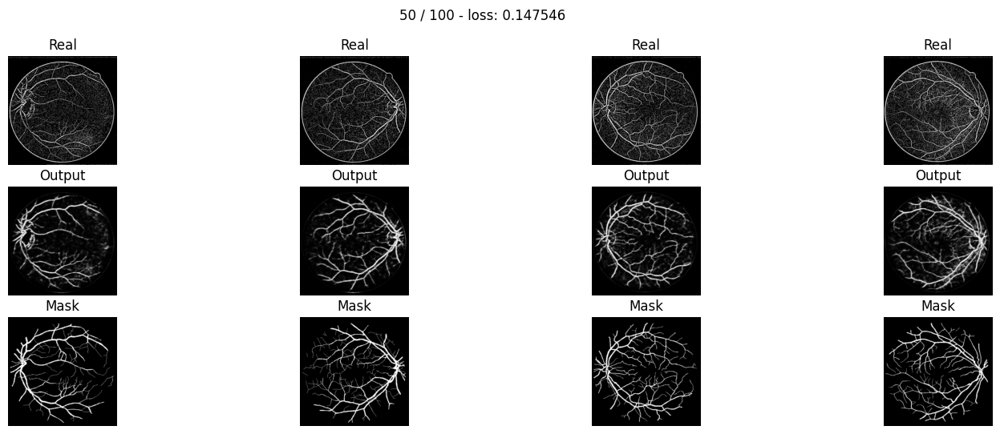

* Epoch 51/100
 - loss: 0.146883
tensor([[4.3611e-02, 4.7074e-03, 1.6027e-03,  ..., 7.3785e-03, 1.5487e-02,
         8.2663e-02],
        [6.1672e-03, 1.4643e-04, 2.6491e-05,  ..., 4.0429e-04, 1.3343e-03,
         2.2982e-02],
        [2.6323e-03, 3.8034e-05, 5.4244e-06,  ..., 1.8309e-04, 7.5256e-04,
         1.7239e-02],
        ...,
        [5.0829e-04, 1.8620e-06, 1.4460e-07,  ..., 1.1342e-05, 6.7220e-05,
         4.8014e-03],
        [1.9415e-03, 1.8771e-05, 2.4801e-06,  ..., 1.5421e-04, 6.5366e-04,
         1.7215e-02],
        [2.5520e-02, 1.8903e-03, 5.8690e-04,  ..., 1.0643e-02, 2.5619e-02,
         1.1829e-01]])
tensor([[4.2711e-02, 4.4193e-03, 1.4595e-03,  ..., 3.3079e-03, 7.4470e-03,
         5.4695e-02],
        [5.9278e-03, 1.3114e-04, 2.2273e-05,  ..., 7.6981e-05, 2.9279e-04,
         9.5881e-03],
        [2.7499e-03, 3.4990e-05, 3.7454e-06,  ..., 1.3291e-05, 7.1105e-05,
         4.7629e-03],
        ...,
        [5.0183e-04, 1.8245e-06, 1.4131e-07,  ..., 9.9559e-06, 6.24

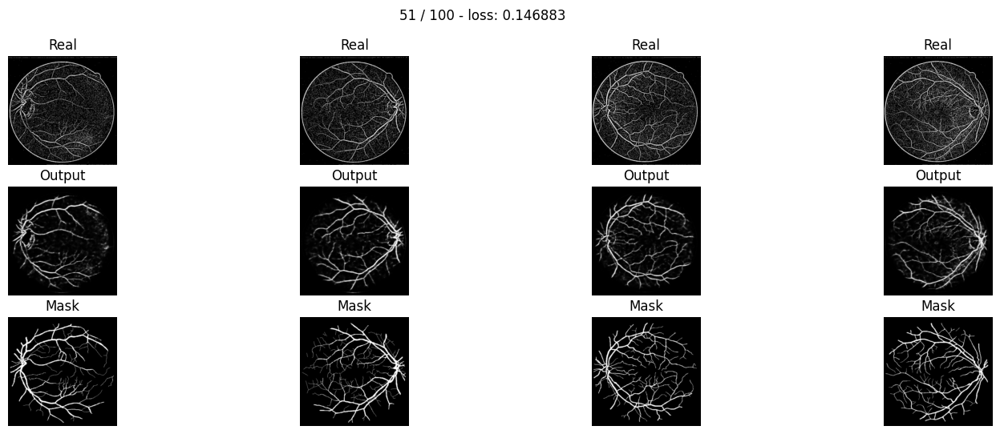

* Epoch 52/100
 - loss: 0.147777
tensor([[5.4963e-02, 7.2551e-03, 2.7507e-03,  ..., 1.2612e-02, 2.3424e-02,
         1.0123e-01],
        [9.4556e-03, 3.1790e-04, 6.8670e-05,  ..., 1.0392e-03, 2.8096e-03,
         3.3554e-02],
        [4.5481e-03, 1.0149e-04, 1.8251e-05,  ..., 6.1305e-04, 1.9491e-03,
         2.8072e-02],
        ...,
        [8.2309e-04, 4.4486e-06, 4.2215e-07,  ..., 3.4664e-05, 1.6211e-04,
         7.5284e-03],
        [2.8417e-03, 3.7637e-05, 5.8059e-06,  ..., 3.7880e-04, 1.3368e-03,
         2.4677e-02],
        [3.1478e-02, 2.7857e-03, 9.4817e-04,  ..., 1.7800e-02, 3.8181e-02,
         1.4234e-01]])
tensor([[5.3829e-02, 6.8012e-03, 2.4978e-03,  ..., 5.8094e-03, 1.1537e-02,
         6.8159e-02],
        [9.0857e-03, 2.8377e-04, 5.7432e-05,  ..., 2.0473e-04, 6.3416e-04,
         1.4294e-02],
        [4.7580e-03, 9.3128e-05, 1.2476e-05,  ..., 4.5600e-05, 1.8768e-04,
         7.8994e-03],
        ...,
        [8.1226e-04, 4.3552e-06, 4.1208e-07,  ..., 2.9959e-05, 1.48

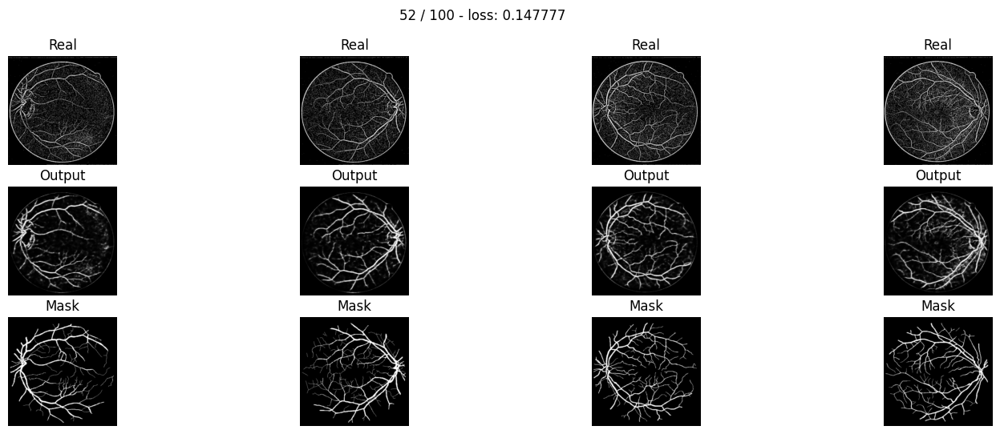

* Epoch 53/100
 - loss: 0.149123
tensor([[3.9009e-02, 3.8913e-03, 1.2691e-03,  ..., 6.6578e-03, 1.4209e-02,
         7.8640e-02],
        [5.1126e-03, 1.0717e-04, 1.8145e-05,  ..., 3.4752e-04, 1.1741e-03,
         2.1270e-02],
        [2.0927e-03, 2.6161e-05, 3.4599e-06,  ..., 1.5697e-04, 6.6252e-04,
         1.5937e-02],
        ...,
        [3.2861e-04, 9.0381e-07, 6.1008e-08,  ..., 7.9476e-06, 4.9960e-05,
         4.0399e-03],
        [1.3633e-03, 1.0413e-05, 1.2288e-06,  ..., 1.1816e-04, 5.2694e-04,
         1.5220e-02],
        [2.0648e-02, 1.3210e-03, 3.8256e-04,  ..., 9.2190e-03, 2.2973e-02,
         1.1196e-01]])
tensor([[3.8155e-02, 3.6386e-03, 1.1484e-03,  ..., 2.9661e-03, 6.7958e-03,
         5.1829e-02],
        [4.9032e-03, 9.5235e-05, 1.5087e-05,  ..., 6.4721e-05, 2.5265e-04,
         8.7653e-03],
        [2.1885e-03, 2.3911e-05, 2.3413e-06,  ..., 1.0762e-05, 5.9486e-05,
         4.2792e-03],
        ...,
        [3.2380e-04, 8.8278e-07, 5.9395e-08,  ..., 6.8285e-06, 4.56

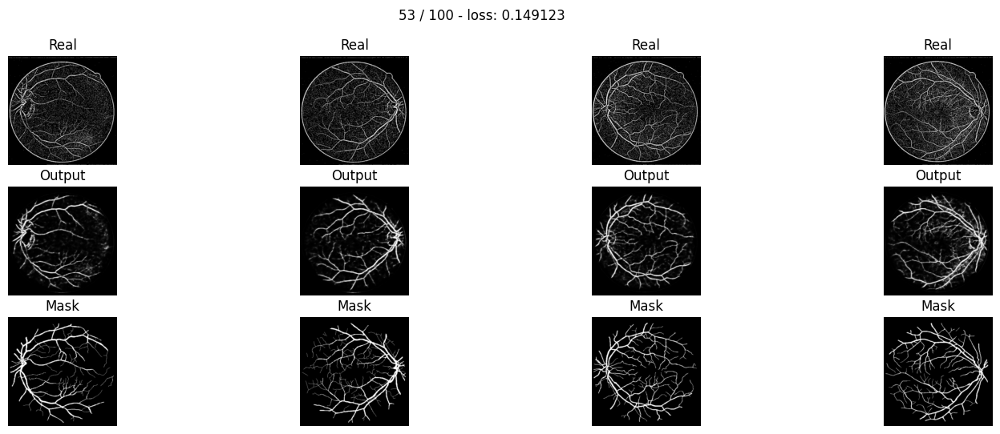

* Epoch 54/100
 - loss: 0.150655
tensor([[3.3820e-02, 3.0114e-03, 9.1966e-04,  ..., 4.9620e-03, 1.1285e-02,
         6.9780e-02],
        [3.9862e-03, 6.9135e-05, 1.0538e-05,  ..., 2.1224e-04, 7.9290e-04,
         1.7245e-02],
        [1.5304e-03, 1.5169e-05, 1.7604e-06,  ..., 8.5410e-05, 4.0936e-04,
         1.2311e-02],
        ...,
        [2.1606e-04, 4.3660e-07, 2.5009e-08,  ..., 4.0393e-06, 2.9066e-05,
         3.0188e-03],
        [9.7468e-04, 5.7934e-06, 6.0054e-07,  ..., 6.9511e-05, 3.4538e-04,
         1.2168e-02],
        [1.6947e-02, 9.3274e-04, 2.4955e-04,  ..., 6.8131e-03, 1.8199e-02,
         9.9985e-02]])
tensor([[3.3082e-02, 2.8139e-03, 8.3079e-04,  ..., 2.1885e-03, 5.3496e-03,
         4.5659e-02],
        [3.8235e-03, 6.1354e-05, 8.7385e-06,  ..., 3.8780e-05, 1.6787e-04,
         7.0253e-03],
        [1.6032e-03, 1.3863e-05, 1.1842e-06,  ..., 5.6515e-06, 3.5637e-05,
         3.2420e-03],
        ...,
        [2.1289e-04, 4.2637e-07, 2.4342e-08,  ..., 3.4351e-06, 2.63

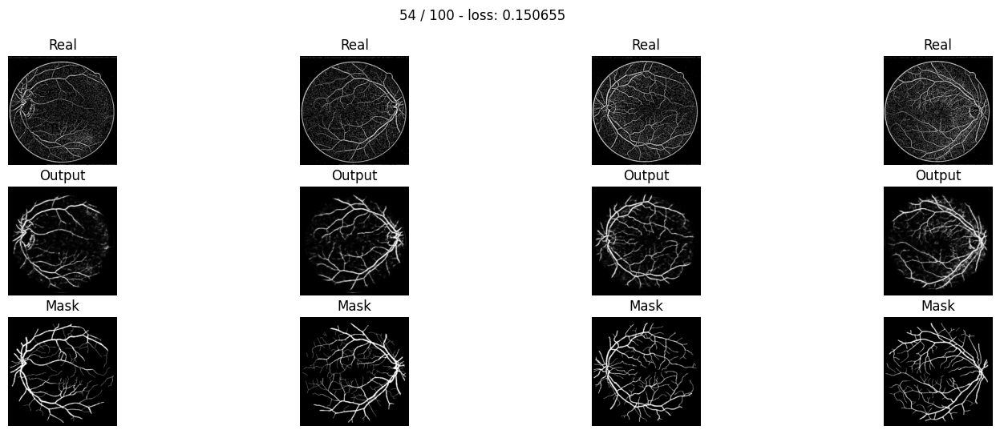

* Epoch 55/100
 - loss: 0.147645
tensor([[4.6768e-02, 5.4158e-03, 1.8896e-03,  ..., 8.7666e-03, 1.7549e-02,
         8.6849e-02],
        [7.1887e-03, 1.9592e-04, 3.7169e-05,  ..., 5.7336e-04, 1.7399e-03,
         2.5782e-02],
        [3.2369e-03, 5.6188e-05, 8.6582e-06,  ..., 3.0116e-04, 1.1061e-03,
         2.0546e-02],
        ...,
        [4.3528e-04, 1.4797e-06, 1.0871e-07,  ..., 1.3251e-05, 7.4206e-05,
         4.8791e-03],
        [1.7032e-03, 1.5451e-05, 1.9442e-06,  ..., 1.8113e-04, 7.4056e-04,
         1.7896e-02],
        [2.3173e-02, 1.6211e-03, 4.8635e-04,  ..., 1.1753e-02, 2.7850e-02,
         1.2204e-01]])
tensor([[4.5732e-02, 5.0500e-03, 1.7004e-03,  ..., 3.9971e-03, 8.5572e-03,
         5.7934e-02],
        [6.8876e-03, 1.7317e-04, 3.0632e-05,  ..., 1.1004e-04, 3.8328e-04,
         1.0778e-02],
        [3.3916e-03, 5.1198e-05, 5.7666e-06,  ..., 2.0887e-05, 9.9906e-05,
         5.5545e-03],
        ...,
        [4.2784e-04, 1.4389e-06, 1.0527e-07,  ..., 1.1053e-05, 6.63

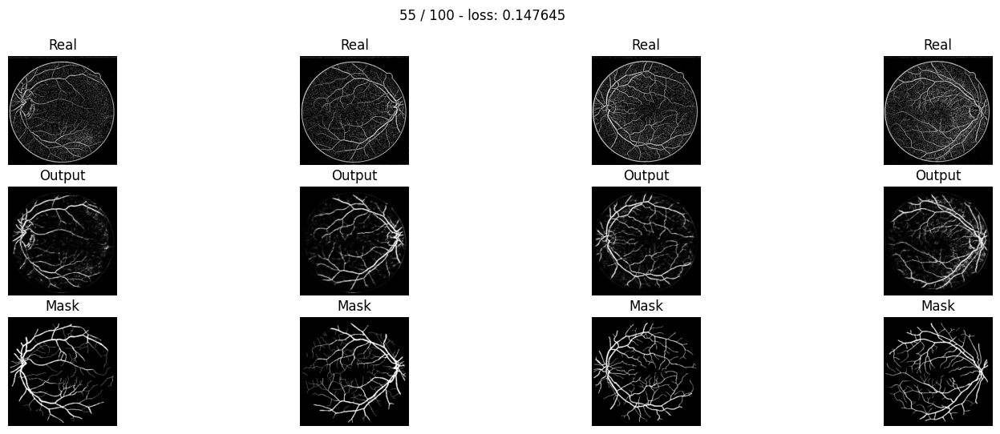

* Epoch 56/100
 - loss: 0.145401
tensor([[4.0224e-02, 4.1267e-03, 1.3425e-03,  ..., 6.2955e-03, 1.3578e-02,
         7.6177e-02],
        [5.5163e-03, 1.2293e-04, 2.0864e-05,  ..., 3.2856e-04, 1.1213e-03,
         2.0451e-02],
        [2.3147e-03, 3.1359e-05, 4.2002e-06,  ..., 1.5043e-04, 6.4148e-04,
         1.5400e-02],
        ...,
        [2.8360e-04, 7.0576e-07, 4.3898e-08,  ..., 6.2303e-06, 4.0767e-05,
         3.5473e-03],
        [1.2099e-03, 8.5221e-06, 9.4063e-07,  ..., 1.0005e-04, 4.6307e-04,
         1.3994e-02],
        [1.8949e-02, 1.1381e-03, 3.1500e-04,  ..., 8.3497e-03, 2.1438e-02,
         1.0764e-01]])
tensor([[3.9326e-02, 3.8452e-03, 1.2064e-03,  ..., 2.8283e-03, 6.5353e-03,
         5.0320e-02],
        [5.2838e-03, 1.0853e-04, 1.7159e-05,  ..., 6.1506e-05, 2.4186e-04,
         8.4252e-03],
        [2.4280e-03, 2.8567e-05, 2.7837e-06,  ..., 1.0017e-05, 5.5951e-05,
         4.0704e-03],
        ...,
        [2.7877e-04, 6.8647e-07, 4.2522e-08,  ..., 5.1426e-06, 3.61

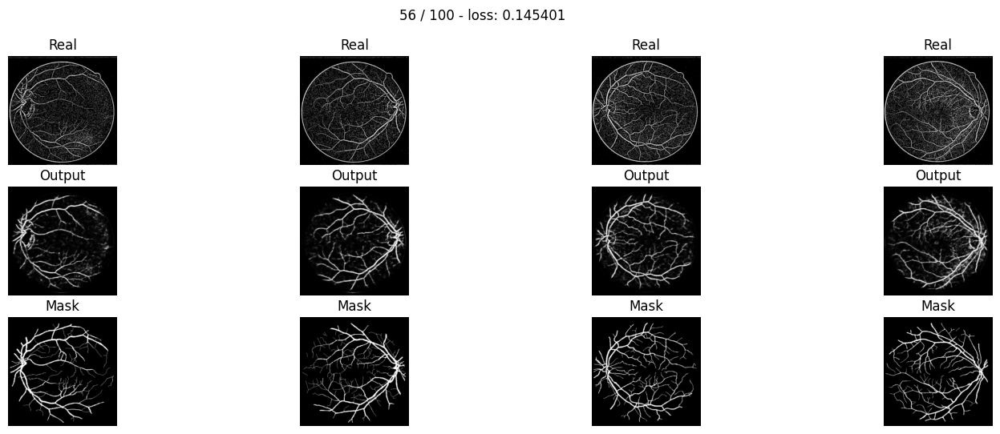

* Epoch 57/100
 - loss: 0.145255
tensor([[4.0637e-02, 4.2280e-03, 1.3836e-03,  ..., 6.5813e-03, 1.4029e-02,
         7.7209e-02],
        [5.6504e-03, 1.2947e-04, 2.2218e-05,  ..., 3.5797e-04, 1.1971e-03,
         2.1050e-02],
        [2.3905e-03, 3.3589e-05, 4.5767e-06,  ..., 1.6916e-04, 7.0248e-04,
         1.6059e-02],
        ...,
        [2.7048e-04, 6.6099e-07, 4.0671e-08,  ..., 6.2707e-06, 4.0839e-05,
         3.5265e-03],
        [1.1635e-03, 8.0725e-06, 8.8269e-07,  ..., 1.0109e-04, 4.6707e-04,
         1.3984e-02],
        [1.8433e-02, 1.0925e-03, 3.0036e-04,  ..., 8.3874e-03, 2.1550e-02,
         1.0770e-01]])
tensor([[3.9698e-02, 3.9315e-03, 1.2394e-03,  ..., 2.9571e-03, 6.7546e-03,
         5.1025e-02],
        [5.4034e-03, 1.1388e-04, 1.8182e-05,  ..., 6.6892e-05, 2.5782e-04,
         8.6682e-03],
        [2.5056e-03, 3.0498e-05, 3.0082e-06,  ..., 1.1132e-05, 6.0635e-05,
         4.2253e-03],
        ...,
        [2.6566e-04, 6.4205e-07, 3.9332e-08,  ..., 5.1141e-06, 3.59

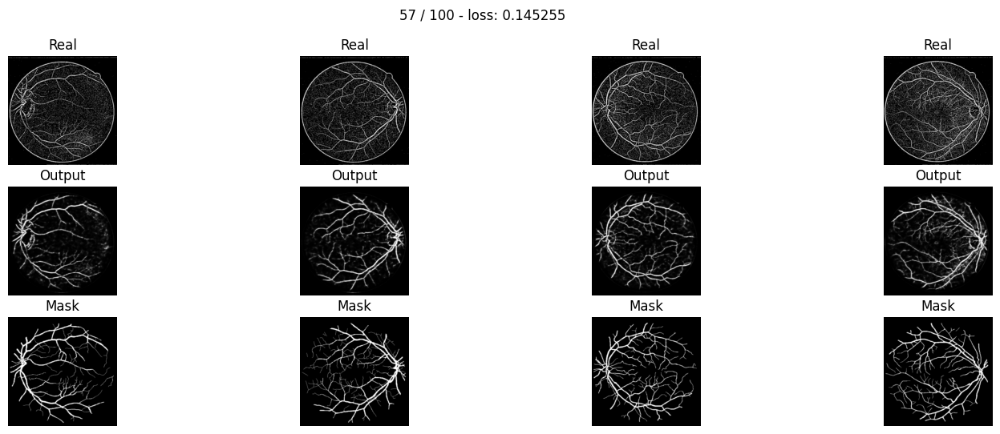

* Epoch 58/100
 - loss: 0.144374
tensor([[4.7578e-02, 5.6648e-03, 1.9933e-03,  ..., 9.1301e-03, 1.8066e-02,
         8.7475e-02],
        [7.5365e-03, 2.1781e-04, 4.2100e-05,  ..., 6.3391e-04, 1.8784e-03,
         2.6495e-02],
        [3.4479e-03, 6.4651e-05, 1.0279e-05,  ..., 3.5016e-04, 1.2454e-03,
         2.1559e-02],
        ...,
        [3.6383e-04, 1.1306e-06, 7.8624e-08,  ..., 1.1673e-05, 6.6742e-05,
         4.5383e-03],
        [1.4710e-03, 1.2399e-05, 1.4909e-06,  ..., 1.6663e-04, 6.9651e-04,
         1.7123e-02],
        [2.0970e-02, 1.3857e-03, 4.0288e-04,  ..., 1.1140e-02, 2.6921e-02,
         1.1957e-01]])
tensor([[4.6470e-02, 5.2607e-03, 1.7810e-03,  ..., 4.1897e-03, 8.8592e-03,
         5.8541e-02],
        [7.2017e-03, 1.9112e-04, 3.4324e-05,  ..., 1.2220e-04, 4.1527e-04,
         1.1104e-02],
        [3.6142e-03, 5.8601e-05, 6.7117e-06,  ..., 2.3696e-05, 1.0999e-04,
         5.7729e-03],
        ...,
        [3.5692e-04, 1.0960e-06, 7.5854e-08,  ..., 9.3932e-06, 5.81

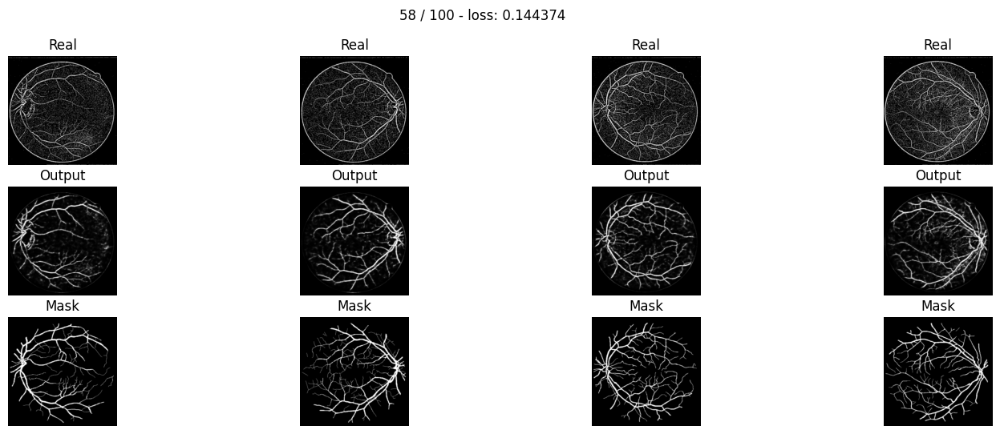

* Epoch 59/100
 - loss: 0.143394
tensor([[3.4669e-02, 3.2151e-03, 9.8864e-04,  ..., 4.9530e-03, 1.1226e-02,
         6.8662e-02],
        [4.2915e-03, 8.1433e-05, 1.2666e-05,  ..., 2.2378e-04, 8.2376e-04,
         1.7198e-02],
        [1.6874e-03, 1.8823e-05, 2.2713e-06,  ..., 9.5032e-05, 4.4554e-04,
         1.2544e-02],
        ...,
        [1.4504e-04, 2.3426e-07, 1.1714e-08,  ..., 2.7240e-06, 2.1074e-05,
         2.4694e-03],
        [7.0389e-04, 3.4818e-06, 3.2284e-07,  ..., 5.2385e-05, 2.7827e-04,
         1.0622e-02],
        [1.3632e-02, 6.5709e-04, 1.6314e-04,  ..., 5.7176e-03, 1.6087e-02,
         9.3409e-02]])
tensor([[3.3808e-02, 2.9782e-03, 8.8066e-04,  ..., 2.1877e-03, 5.3293e-03,
         4.4937e-02],
        [4.0911e-03, 7.1157e-05, 1.0275e-05,  ..., 4.0555e-05, 1.7306e-04,
         6.9726e-03],
        [1.7661e-03, 1.6995e-05, 1.4708e-06,  ..., 5.9161e-06, 3.6704e-05,
         3.2136e-03],
        ...,
        [1.4217e-04, 2.2683e-07, 1.1288e-08,  ..., 2.1811e-06, 1.82

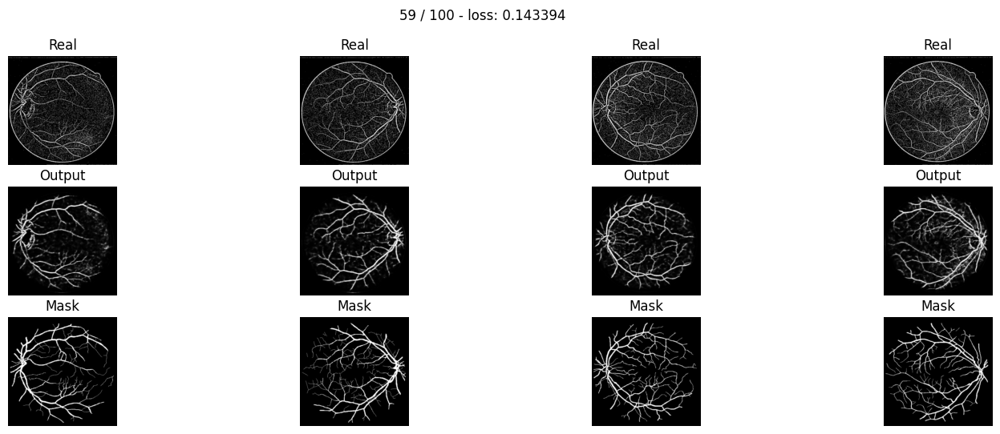

* Epoch 60/100
 - loss: 0.143219
tensor([[4.9387e-02, 6.1442e-03, 2.2168e-03,  ..., 1.0140e-02, 1.9491e-02,
         9.0393e-02],
        [8.1014e-03, 2.5283e-04, 5.0919e-05,  ..., 7.6792e-04, 2.1720e-03,
         2.8327e-02],
        [3.7830e-03, 7.8222e-05, 1.3165e-05,  ..., 4.5504e-04, 1.5238e-03,
         2.3734e-02],
        ...,
        [3.1023e-04, 8.9361e-07, 6.0132e-08,  ..., 1.1651e-05, 6.6185e-05,
         4.4668e-03],
        [1.2867e-03, 1.0165e-05, 1.1875e-06,  ..., 1.6738e-04, 6.9908e-04,
         1.7004e-02],
        [1.9204e-02, 1.2108e-03, 3.4531e-04,  ..., 1.1149e-02, 2.7011e-02,
         1.1938e-01]])
tensor([[4.8170e-02, 5.6841e-03, 1.9684e-03,  ..., 4.6708e-03, 9.5943e-03,
         6.0662e-02],
        [7.7195e-03, 2.2036e-04, 4.1117e-05,  ..., 1.4826e-04, 4.8095e-04,
         1.1892e-02],
        [3.9594e-03, 7.0507e-05, 8.4648e-06,  ..., 3.0270e-05, 1.3257e-04,
         6.3201e-03],
        ...,
        [3.0340e-04, 8.6197e-07, 5.7681e-08,  ..., 9.1858e-06, 5.67

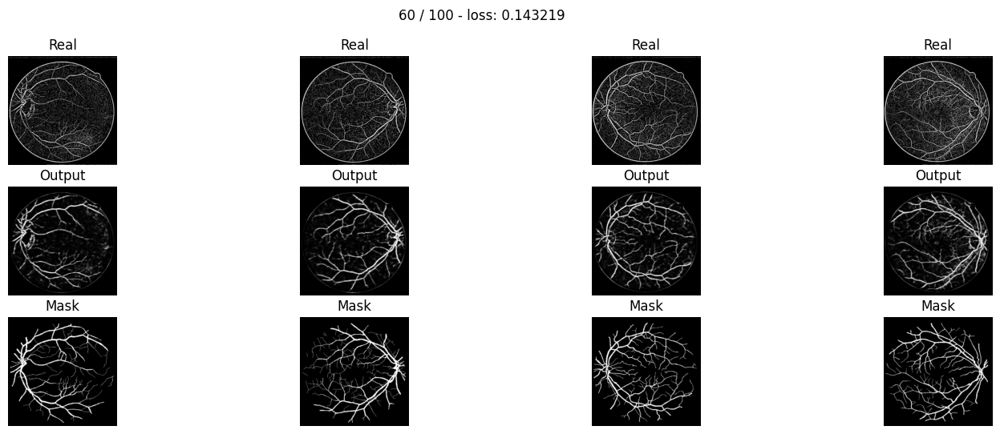

* Epoch 61/100
 - loss: 0.143038
tensor([[3.1446e-02, 2.7287e-03, 8.0791e-04,  ..., 4.1241e-03, 9.6692e-03,
         6.3219e-02],
        [3.6271e-03, 6.1536e-05, 9.0057e-06,  ..., 1.6544e-04, 6.4409e-04,
         1.4964e-02],
        [1.3643e-03, 1.3288e-05, 1.4902e-06,  ..., 6.6345e-05, 3.3392e-04,
         1.0655e-02],
        ...,
        [8.5910e-05, 9.7524e-08, 4.0731e-09,  ..., 1.4066e-06, 1.2385e-05,
         1.8417e-03],
        [4.5998e-04, 1.7025e-06, 1.3659e-07,  ..., 3.1088e-05, 1.8360e-04,
         8.4612e-03],
        [1.0532e-02, 4.2505e-04, 9.6562e-05,  ..., 4.2215e-03, 1.2723e-02,
         8.3005e-02]])
tensor([[3.0570e-02, 2.5117e-03, 7.1325e-04,  ..., 1.7949e-03, 4.5333e-03,
         4.1021e-02],
        [3.4384e-03, 5.3178e-05, 7.1995e-06,  ..., 2.9164e-05, 1.3224e-04,
         5.9786e-03],
        [1.4208e-03, 1.1864e-05, 9.4423e-07,  ..., 3.9245e-06, 2.6336e-05,
         2.6623e-03],
        ...,
        [8.3978e-05, 9.4019e-08, 3.9053e-09,  ..., 1.1024e-06, 1.05

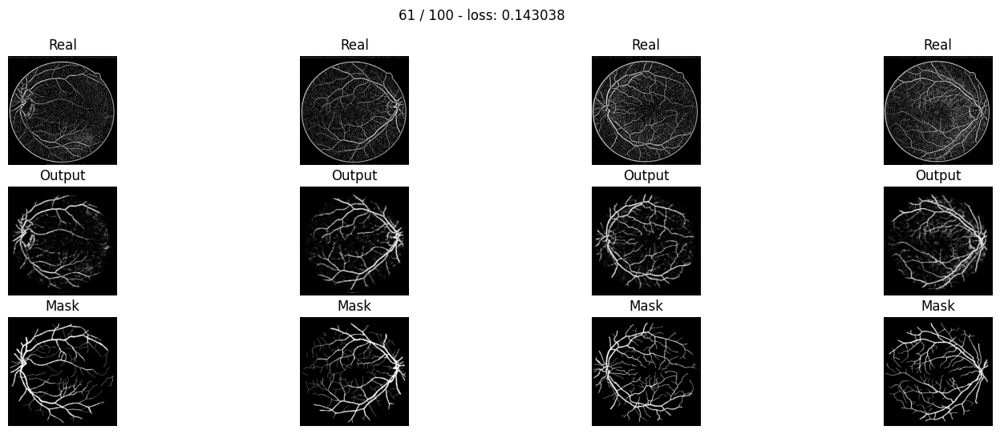

* Epoch 62/100
 - loss: 0.143143
tensor([[3.8975e-02, 4.0361e-03, 1.3143e-03,  ..., 6.3596e-03, 1.3505e-02,
         7.4710e-02],
        [5.3378e-03, 1.2253e-04, 2.0944e-05,  ..., 3.5025e-04, 1.1618e-03,
         2.0279e-02],
        [2.2294e-03, 3.1626e-05, 4.3367e-06,  ..., 1.7241e-04, 7.0682e-04,
         1.5720e-02],
        ...,
        [1.3382e-04, 2.1387e-07, 1.0622e-08,  ..., 3.5005e-06, 2.5417e-05,
         2.6707e-03],
        [6.5418e-04, 3.1951e-06, 2.9334e-07,  ..., 6.4778e-05, 3.2930e-04,
         1.1404e-02],
        [1.2858e-02, 6.0717e-04, 1.4950e-04,  ..., 6.4451e-03, 1.7713e-02,
         9.7216e-02]])
tensor([[3.7871e-02, 3.7068e-03, 1.1556e-03,  ..., 2.8240e-03, 6.4421e-03,
         4.9080e-02],
        [5.0546e-03, 1.0552e-04, 1.6646e-05,  ..., 6.3608e-05, 2.4445e-04,
         8.2354e-03],
        [2.3215e-03, 2.8168e-05, 2.7243e-06,  ..., 1.0487e-05, 5.6992e-05,
         3.9939e-03],
        ...,
        [1.3052e-04, 2.0542e-07, 1.0139e-08,  ..., 2.6966e-06, 2.14

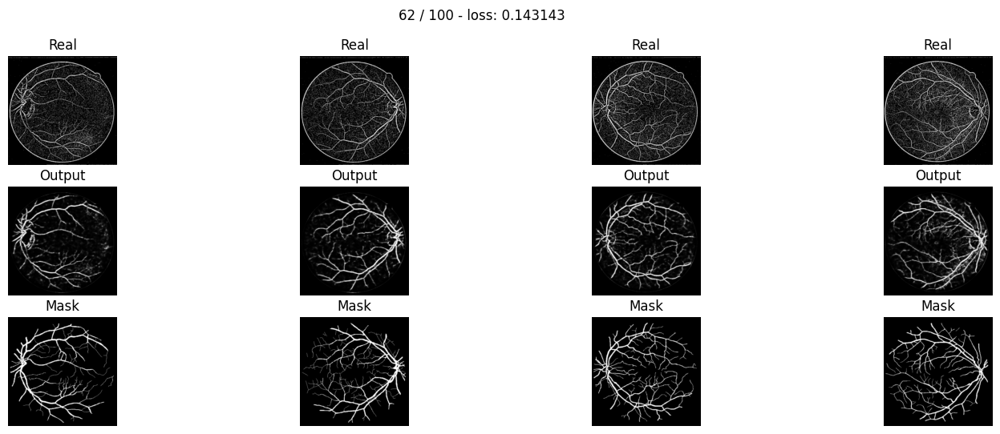

* Epoch 63/100
 - loss: 0.141784
tensor([[3.4780e-02, 3.3055e-03, 1.0251e-03,  ..., 5.1415e-03, 1.1431e-02,
         6.8448e-02],
        [4.3804e-03, 8.7166e-05, 1.3785e-05,  ..., 2.4599e-04, 8.7758e-04,
         1.7436e-02],
        [1.7364e-03, 2.0678e-05, 2.5749e-06,  ..., 1.1151e-04, 5.0122e-04,
         1.3055e-02],
        ...,
        [9.2870e-05, 1.1540e-07, 5.0271e-09,  ..., 2.1431e-06, 1.7215e-05,
         2.1627e-03],
        [4.8830e-04, 1.9442e-06, 1.6091e-07,  ..., 4.4120e-05, 2.4314e-04,
         9.6931e-03],
        [1.0804e-02, 4.5130e-04, 1.0434e-04,  ..., 5.1604e-03, 1.4929e-02,
         8.9325e-02]])
tensor([[3.3714e-02, 3.0217e-03, 8.9545e-04,  ..., 2.2471e-03, 5.3778e-03,
         4.4537e-02],
        [4.1322e-03, 7.4488e-05, 1.0842e-05,  ..., 4.3495e-05, 1.8049e-04,
         6.9772e-03],
        [1.8020e-03, 1.8269e-05, 1.5939e-06,  ..., 6.5210e-06, 3.9064e-05,
         3.2486e-03],
        ...,
        [9.0465e-05, 1.1062e-07, 4.7870e-09,  ..., 1.6336e-06, 1.43

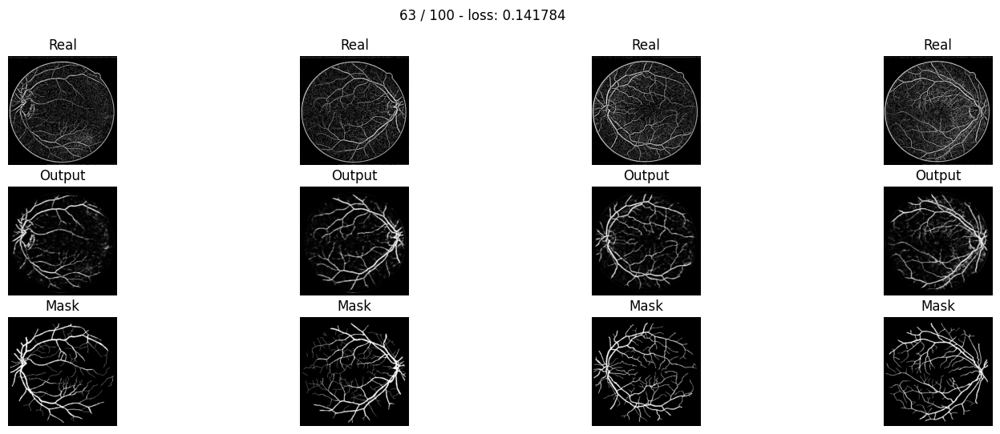

* Epoch 64/100
 - loss: 0.141764
tensor([[2.9778e-02, 2.5133e-03, 7.2858e-04,  ..., 3.7989e-03, 9.0307e-03,
         6.0543e-02],
        [3.3437e-03, 5.4512e-05, 7.7423e-06,  ..., 1.4834e-04, 5.8857e-04,
         1.4095e-02],
        [1.2335e-03, 1.1493e-05, 1.2505e-06,  ..., 5.9468e-05, 3.0579e-04,
         1.0020e-02],
        ...,
        [5.8900e-05, 5.3245e-08, 1.9639e-09,  ..., 1.1009e-06, 1.0158e-05,
         1.6295e-03],
        [3.3906e-04, 1.0427e-06, 7.5667e-08,  ..., 2.6075e-05, 1.6054e-04,
         7.7772e-03],
        [8.6966e-03, 3.1134e-04, 6.6450e-05,  ..., 3.7978e-03, 1.1788e-02,
         7.9517e-02]])
tensor([[2.8851e-02, 2.2949e-03, 6.3530e-04,  ..., 1.6421e-03, 4.2054e-03,
         3.9071e-02],
        [3.1523e-03, 4.6497e-05, 6.0709e-06,  ..., 2.5756e-05, 1.1914e-04,
         5.5763e-03],
        [1.2808e-03, 1.0142e-05, 7.6947e-07,  ..., 3.3797e-06, 2.3239e-05,
         2.4532e-03],
        ...,
        [5.7354e-05, 5.1009e-08, 1.8690e-09,  ..., 8.3385e-07, 8.45

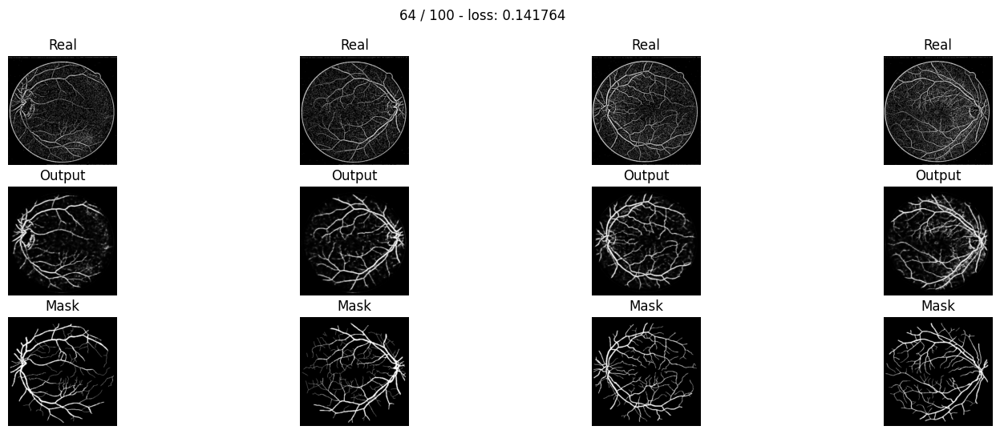

* Epoch 65/100
 - loss: 0.143535
tensor([[3.2996e-02, 3.0406e-03, 9.2530e-04,  ..., 4.8034e-03, 1.0797e-02,
         6.6111e-02],
        [4.0307e-03, 7.6544e-05, 1.1776e-05,  ..., 2.2284e-04, 8.0773e-04,
         1.6547e-02],
        [1.5669e-03, 1.7686e-05, 2.1378e-06,  ..., 1.0018e-04, 4.5886e-04,
         1.2332e-02],
        ...,
        [7.2627e-05, 7.7987e-08, 3.1434e-09,  ..., 1.7125e-06, 1.4322e-05,
         1.9370e-03],
        [4.0064e-04, 1.4175e-06, 1.1021e-07,  ..., 3.7207e-05, 2.1251e-04,
         8.9427e-03],
        [9.5531e-03, 3.6989e-04, 8.2298e-05,  ..., 4.6607e-03, 1.3821e-02,
         8.5684e-02]])
tensor([[3.1922e-02, 2.7669e-03, 8.0266e-04,  ..., 2.0913e-03, 5.0616e-03,
         4.2886e-02],
        [3.7907e-03, 6.4941e-05, 9.1658e-06,  ..., 3.9118e-05, 1.6507e-04,
         6.5906e-03],
        [1.6245e-03, 1.5527e-05, 1.3020e-06,  ..., 5.7345e-06, 3.5076e-05,
         3.0362e-03],
        ...,
        [7.0574e-05, 7.4452e-08, 2.9790e-09,  ..., 1.2814e-06, 1.18

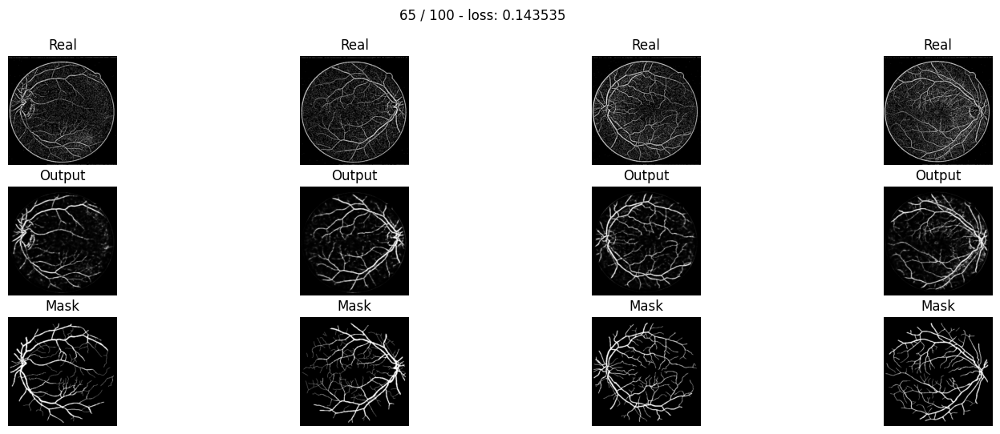

* Epoch 66/100
 - loss: 0.140513
tensor([[2.6987e-02, 2.1328e-03, 5.9593e-04,  ..., 3.2370e-03, 7.9132e-03,
         5.6179e-02],
        [2.8408e-03, 4.1668e-05, 5.5901e-06,  ..., 1.1450e-04, 4.7483e-04,
         1.2445e-02],
        [1.0082e-03, 8.2893e-06, 8.4374e-07,  ..., 4.3725e-05, 2.3758e-04,
         8.6517e-03],
        ...,
        [4.1718e-05, 3.0348e-08, 9.9944e-10,  ..., 6.4753e-07, 6.5881e-06,
         1.2752e-03],
        [2.5706e-04, 6.6315e-07, 4.3959e-08,  ..., 1.7124e-05, 1.1439e-04,
         6.4270e-03],
        [7.3507e-03, 2.3622e-04, 4.7746e-05,  ..., 2.9672e-03, 9.7041e-03,
         7.1859e-02]])
tensor([[2.6025e-02, 1.9306e-03, 5.1367e-04,  ..., 1.3811e-03, 3.6454e-03,
         3.5987e-02],
        [2.6574e-03, 3.5032e-05, 4.3048e-06,  ..., 1.9464e-05, 9.4491e-05,
         4.8708e-03],
        [1.0392e-03, 7.1983e-06, 5.0610e-07,  ..., 2.3947e-06, 1.7501e-05,
         2.0812e-03],
        ...,
        [4.0492e-05, 2.8917e-08, 9.4505e-10,  ..., 4.8215e-07, 5.41

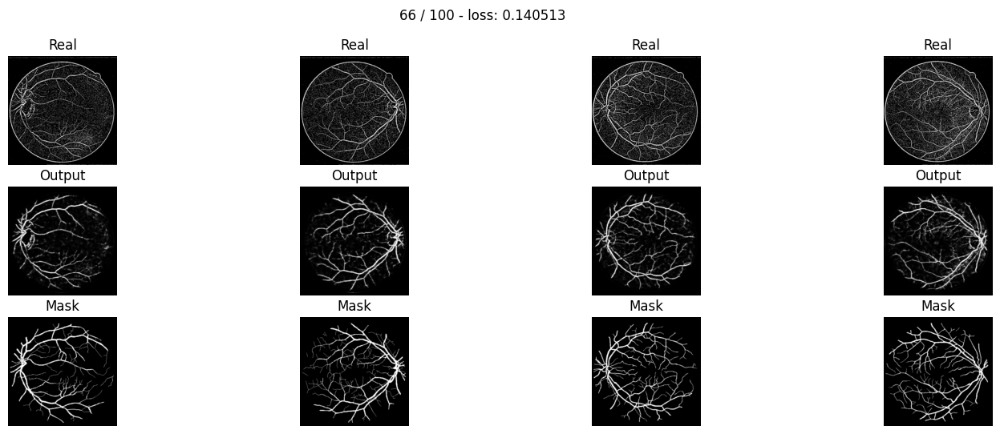

* Epoch 67/100
 - loss: 0.140749
tensor([[3.0535e-02, 2.6733e-03, 7.9042e-04,  ..., 4.2018e-03, 9.6897e-03,
         6.2248e-02],
        [3.5468e-03, 6.2079e-05, 9.1409e-06,  ..., 1.7983e-04, 6.7828e-04,
         1.4984e-02],
        [1.3350e-03, 1.3677e-05, 1.5703e-06,  ..., 7.7544e-05, 3.7325e-04,
         1.0960e-02],
        ...,
        [5.5556e-05, 5.0529e-08, 1.8592e-09,  ..., 1.0523e-06, 9.6669e-06,
         1.5540e-03],
        [3.2311e-04, 1.0001e-06, 7.2282e-08,  ..., 2.5249e-05, 1.5602e-04,
         7.5324e-03],
        [8.3659e-03, 2.9766e-04, 6.3321e-05,  ..., 3.6956e-03, 1.1536e-02,
         7.8136e-02]])
tensor([[2.9461e-02, 2.4206e-03, 6.8122e-04,  ..., 1.8259e-03, 4.5347e-03,
         4.0294e-02],
        [3.3204e-03, 5.2229e-05, 7.0427e-06,  ..., 3.1499e-05, 1.3844e-04,
         5.9567e-03],
        [1.3792e-03, 1.1899e-05, 9.4100e-07,  ..., 4.3777e-06, 2.8190e-05,
         2.6801e-03],
        ...,
        [5.3855e-05, 4.8050e-08, 1.7539e-09,  ..., 7.7786e-07, 7.90

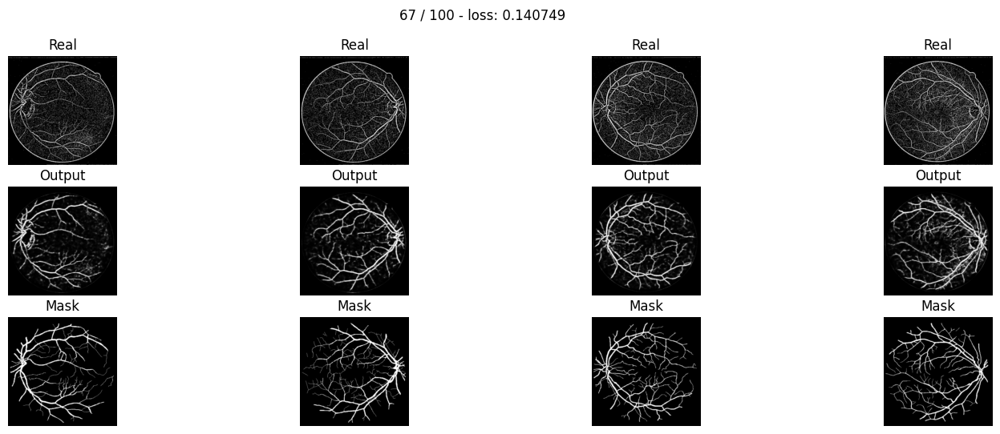

* Epoch 68/100
 - loss: 0.139471
tensor([[2.4325e-02, 1.8038e-03, 4.8790e-04,  ..., 2.7407e-03, 6.8947e-03,
         5.1952e-02],
        [2.3920e-03, 3.1661e-05, 4.0394e-06,  ..., 8.7512e-05, 3.7981e-04,
         1.0936e-02],
        [8.1371e-04, 5.9203e-06, 5.6804e-07,  ..., 3.1736e-05, 1.8248e-04,
         7.4212e-03],
        ...,
        [2.9480e-05, 1.7258e-08, 5.0647e-10,  ..., 3.5725e-07, 4.0773e-06,
         9.7503e-04],
        [1.9474e-04, 4.2154e-07, 2.5485e-08,  ..., 1.0681e-05, 7.8434e-05,
         5.2117e-03],
        [6.2073e-03, 1.7908e-04, 3.4241e-05,  ..., 2.2446e-03, 7.7969e-03,
         6.4161e-02]])
tensor([[2.3359e-02, 1.6205e-03, 4.1641e-04,  ..., 1.1595e-03, 3.1555e-03,
         3.3118e-02],
        [2.2219e-03, 2.6288e-05, 3.0640e-06,  ..., 1.4679e-05, 7.4823e-05,
         4.2515e-03],
        [8.3338e-04, 5.0717e-06, 3.3347e-07,  ..., 1.6906e-06, 1.3132e-05,
         1.7622e-03],
        ...,
        [2.8526e-05, 1.6364e-08, 4.7620e-10,  ..., 2.6246e-07, 3.32

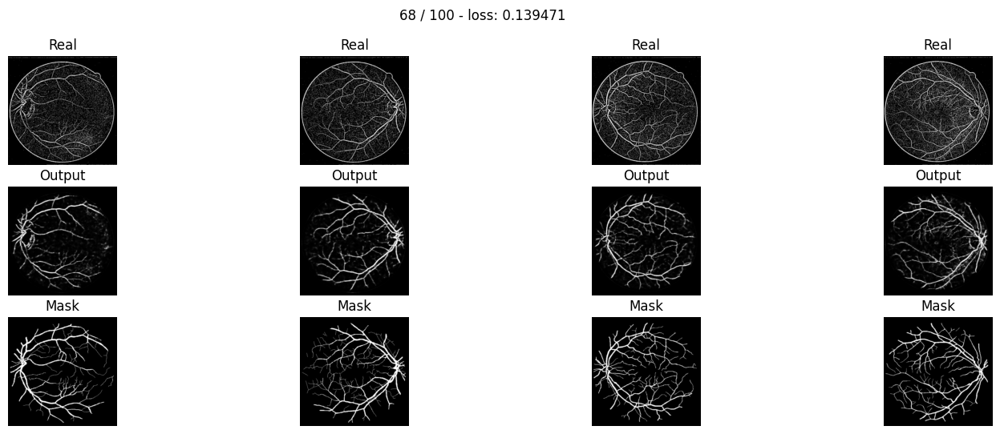

* Epoch 69/100
 - loss: 0.140701
tensor([[2.7335e-02, 2.2394e-03, 6.4073e-04,  ..., 3.7100e-03, 8.7762e-03,
         5.8925e-02],
        [2.9498e-03, 4.6432e-05, 6.5000e-06,  ..., 1.4783e-04, 5.8016e-04,
         1.3717e-02],
        [1.0592e-03, 9.5529e-06, 1.0334e-06,  ..., 6.1546e-05, 3.1119e-04,
         9.8828e-03],
        ...,
        [3.8546e-05, 2.8367e-08, 9.4108e-10,  ..., 6.8307e-07, 6.8681e-06,
         1.2852e-03],
        [2.4161e-04, 6.3110e-07, 4.2036e-08,  ..., 1.7994e-05, 1.1978e-04,
         6.5090e-03],
        [7.0125e-03, 2.2480e-04, 4.5511e-05,  ..., 3.0200e-03, 9.8908e-03,
         7.2200e-02]])
tensor([[2.6262e-02, 2.0123e-03, 5.4660e-04,  ..., 1.6008e-03, 4.0843e-03,
         3.7987e-02],
        [2.7423e-03, 3.8578e-05, 4.9317e-06,  ..., 2.5605e-05, 1.1739e-04,
         5.4206e-03],
        [1.0874e-03, 8.2011e-06, 6.0601e-07,  ..., 3.3878e-06, 2.2998e-05,
         2.3876e-03],
        ...,
        [3.7271e-05, 2.6871e-08, 8.8391e-10,  ..., 4.9860e-07, 5.57

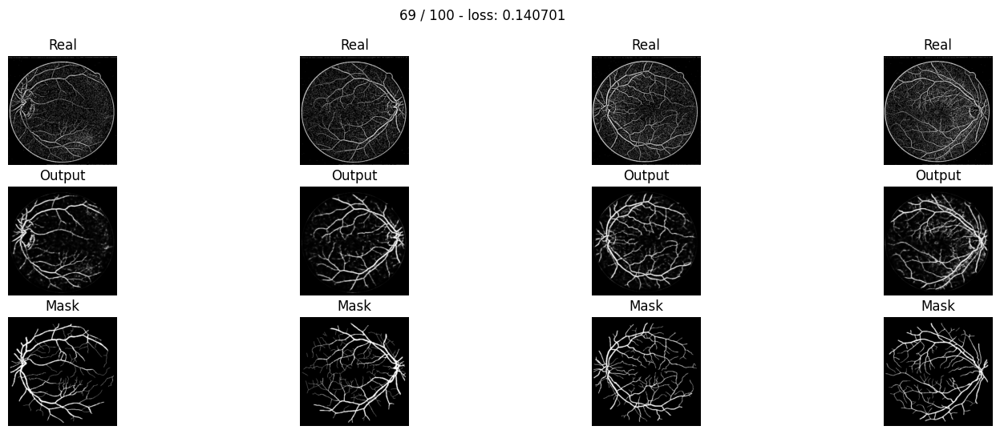

* Epoch 70/100
 - loss: 0.139176
tensor([[2.3929e-02, 1.7880e-03, 4.8622e-04,  ..., 3.0063e-03, 7.4753e-03,
         5.4217e-02],
        [2.3487e-03, 3.1710e-05, 4.0949e-06,  ..., 1.0459e-04, 4.4408e-04,
         1.1909e-02],
        [7.9277e-04, 5.9147e-06, 5.7824e-07,  ..., 4.0019e-05, 2.2360e-04,
         8.2896e-03],
        ...,
        [2.6091e-05, 1.4971e-08, 4.3810e-10,  ..., 4.0878e-07, 4.6013e-06,
         1.0368e-03],
        [1.7737e-04, 3.7956e-07, 2.2919e-08,  ..., 1.2032e-05, 8.7610e-05,
         5.5118e-03],
        [5.8294e-03, 1.6587e-04, 3.1635e-05,  ..., 2.3811e-03, 8.2526e-03,
         6.5943e-02]])
tensor([[2.2928e-02, 1.5991e-03, 4.1225e-04,  ..., 1.2864e-03, 3.4540e-03,
         3.4763e-02],
        [2.1735e-03, 2.6138e-05, 3.0767e-06,  ..., 1.7870e-05, 8.8860e-05,
         4.6707e-03],
        [8.1032e-04, 5.0324e-06, 3.3446e-07,  ..., 2.1541e-06, 1.6210e-05,
         1.9796e-03],
        ...,
        [2.5197e-05, 1.4154e-08, 4.1055e-10,  ..., 2.9660e-07, 3.71

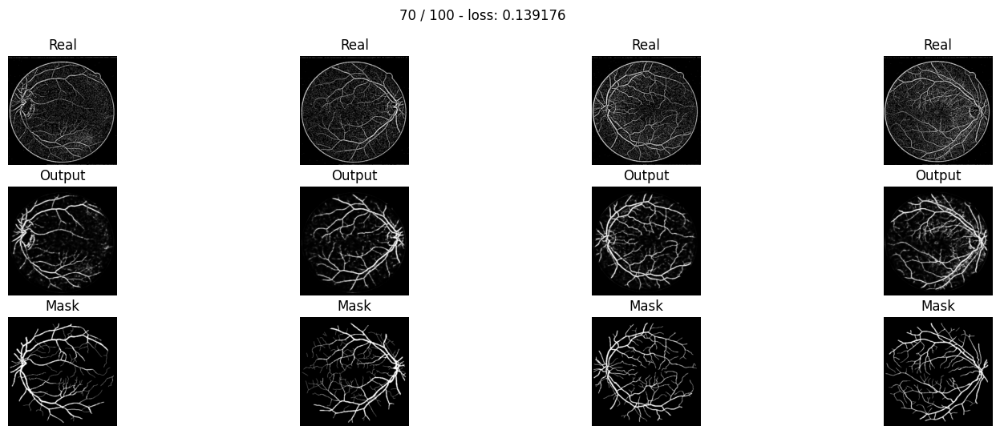

* Epoch 71/100
 - loss: 0.138746
tensor([[2.2266e-02, 1.5956e-03, 4.2460e-04,  ..., 2.8120e-03, 7.0934e-03,
         5.2627e-02],
        [2.0842e-03, 2.6296e-05, 3.2829e-06,  ..., 9.4241e-05, 4.0909e-04,
         1.1355e-02],
        [6.8182e-04, 4.6828e-06, 4.3952e-07,  ..., 3.5322e-05, 2.0292e-04,
         7.8330e-03],
        ...,
        [2.0631e-05, 1.0295e-08, 2.8080e-10,  ..., 3.2051e-07, 3.7976e-06,
         9.3031e-04],
        [1.4736e-04, 2.8207e-07, 1.6117e-08,  ..., 9.9768e-06, 7.5714e-05,
         5.0773e-03],
        [5.2084e-03, 1.3845e-04, 2.5535e-05,  ..., 2.1289e-03, 7.5782e-03,
         6.3027e-02]])
tensor([[2.1276e-02, 1.4195e-03, 3.5738e-04,  ..., 1.1980e-03, 3.2659e-03,
         3.3657e-02],
        [1.9200e-03, 2.1491e-05, 2.4396e-06,  ..., 1.5984e-05, 8.1378e-05,
         4.4360e-03],
        [6.9395e-04, 3.9478e-06, 2.5052e-07,  ..., 1.8728e-06, 1.4519e-05,
         1.8567e-03],
        ...,
        [1.9883e-05, 9.7006e-09, 2.6208e-10,  ..., 2.3056e-07, 3.04

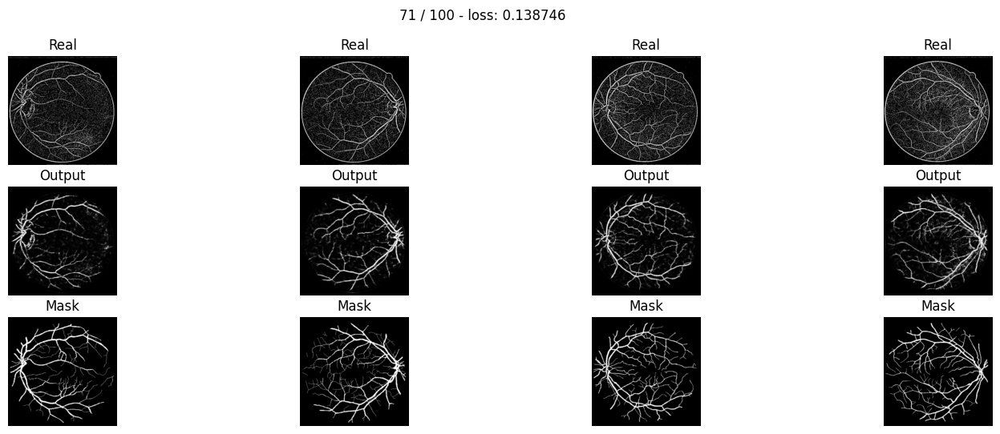

* Epoch 72/100
 - loss: 0.138065
tensor([[2.4372e-02, 1.8950e-03, 5.2801e-04,  ..., 3.5535e-03, 8.5379e-03,
         5.7881e-02],
        [2.4550e-03, 3.5714e-05, 4.8116e-06,  ..., 1.4161e-04, 5.6746e-04,
         1.3491e-02],
        [8.3687e-04, 6.8502e-06, 7.0931e-07,  ..., 5.8932e-05, 3.0591e-04,
         9.7310e-03],
        ...,
        [2.5040e-05, 1.4763e-08, 4.3759e-10,  ..., 4.9458e-07, 5.3908e-06,
         1.1175e-03],
        [1.7250e-04, 3.7898e-07, 2.3127e-08,  ..., 1.4219e-05, 1.0118e-04,
         5.9025e-03],
        [5.6861e-03, 1.6304e-04, 3.1244e-05,  ..., 2.5997e-03, 8.9113e-03,
         6.8251e-02]])
tensor([[2.3291e-02, 1.6849e-03, 4.4362e-04,  ..., 1.5402e-03, 3.9891e-03,
         3.7377e-02],
        [2.2616e-03, 2.9152e-05, 3.5659e-06,  ..., 2.4684e-05, 1.1550e-04,
         5.3454e-03],
        [8.5291e-04, 5.7720e-06, 4.0211e-07,  ..., 3.2088e-06, 2.2363e-05,
         2.3399e-03],
        ...,
        [2.4098e-05, 1.3879e-08, 4.0731e-10,  ..., 3.5255e-07, 4.30

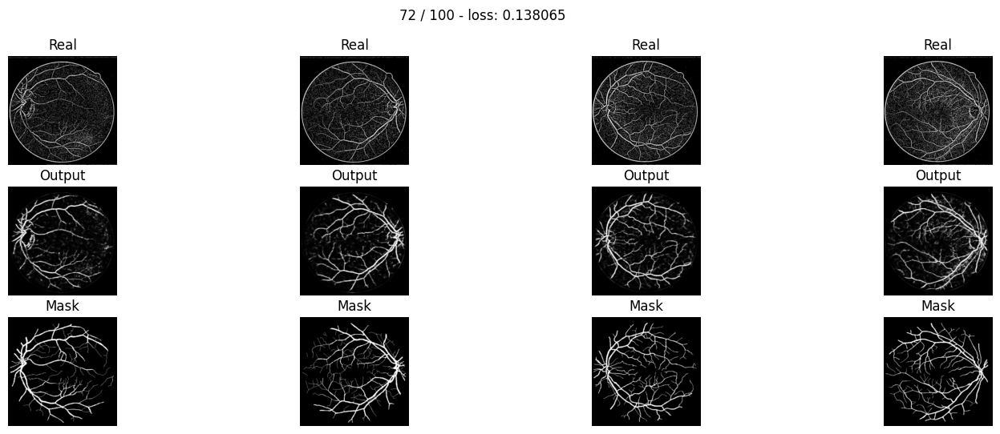

* Epoch 73/100
 - loss: 0.137868
tensor([[1.8146e-02, 1.1440e-03, 2.8382e-04,  ..., 2.1831e-03, 5.8486e-03,
         4.7461e-02],
        [1.4814e-03, 1.5149e-05, 1.6954e-06,  ..., 6.2820e-05, 2.9933e-04,
         9.5825e-03],
        [4.4238e-04, 2.3442e-06, 1.9214e-07,  ..., 2.1337e-05, 1.3795e-04,
         6.3422e-03],
        ...,
        [1.1880e-05, 4.2278e-09, 9.6376e-11,  ..., 1.5533e-07, 2.1626e-06,
         6.8432e-04],
        [9.5524e-05, 1.3983e-07, 6.9466e-09,  ..., 5.6977e-06, 4.9181e-05,
         4.0197e-03],
        [4.0066e-03, 9.0473e-05, 1.5317e-05,  ..., 1.5227e-03, 5.8823e-03,
         5.5366e-02]])
tensor([[1.7282e-02, 1.0116e-03, 2.3681e-04,  ..., 9.2658e-04, 2.6847e-03,
         3.0255e-02],
        [1.3571e-03, 1.2251e-05, 1.2423e-06,  ..., 1.0586e-05, 5.9259e-05,
         3.7302e-03],
        [4.4821e-04, 1.9535e-06, 1.0721e-07,  ..., 1.1088e-06, 9.7022e-06,
         1.4897e-03],
        ...,
        [1.1419e-05, 3.9672e-09, 8.9533e-11,  ..., 1.1007e-07, 1.71

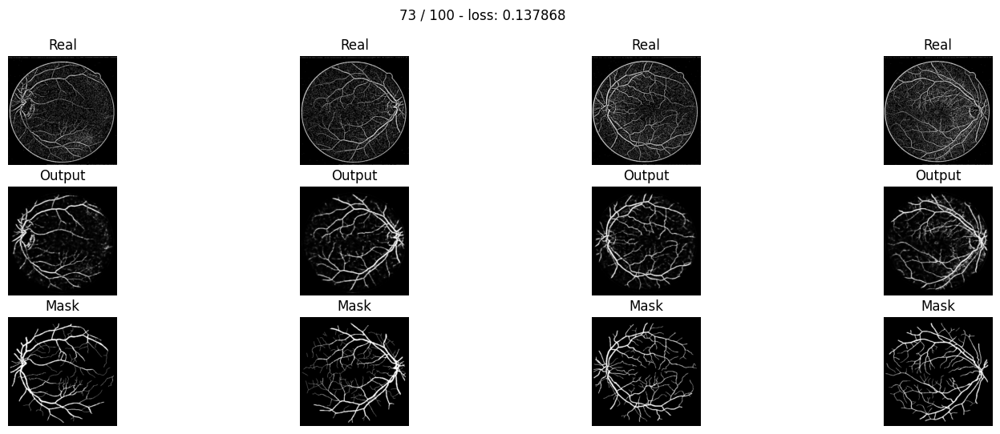

* Epoch 74/100
 - loss: 0.137506
tensor([[2.0159e-02, 1.3964e-03, 3.6704e-04,  ..., 3.0088e-03, 7.4923e-03,
         5.3867e-02],
        [1.7865e-03, 2.1515e-05, 2.6452e-06,  ..., 1.0856e-04, 4.5990e-04,
         1.1993e-02],
        [5.6111e-04, 3.6460e-06, 3.3757e-07,  ..., 4.2708e-05, 2.3767e-04,
         8.4403e-03],
        ...,
        [1.4497e-05, 6.1568e-09, 1.5481e-10,  ..., 2.7677e-07, 3.4130e-06,
         8.6806e-04],
        [1.1192e-04, 1.8919e-07, 1.0147e-08,  ..., 9.0499e-06, 7.1118e-05,
         4.8637e-03],
        [4.3798e-03, 1.0717e-04, 1.8991e-05,  ..., 1.9877e-03, 7.2563e-03,
         6.1388e-02]])
tensor([[1.9184e-02, 1.2322e-03, 3.0520e-04,  ..., 1.3012e-03, 3.4961e-03,
         3.4721e-02],
        [1.6343e-03, 1.7335e-05, 1.9284e-06,  ..., 1.8846e-05, 9.3373e-05,
         4.7430e-03],
        [5.6832e-04, 3.0287e-06, 1.8695e-07,  ..., 2.2860e-06, 1.7132e-05,
         2.0159e-03],
        ...,
        [1.3904e-05, 5.7568e-09, 1.4320e-10,  ..., 1.9380e-07, 2.68

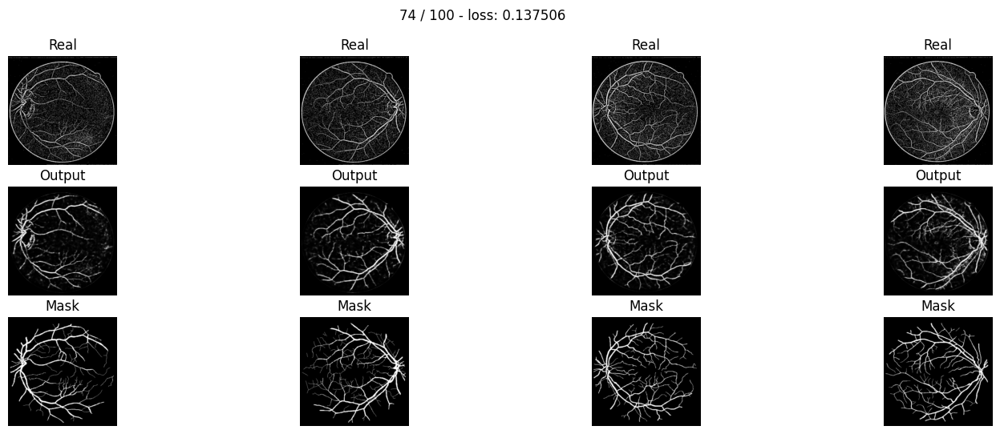

* Epoch 75/100
 - loss: 0.137149
tensor([[1.5605e-02, 9.0495e-04, 2.1602e-04,  ..., 2.0536e-03, 5.5689e-03,
         4.6105e-02],
        [1.1546e-03, 1.0314e-05, 1.0873e-06,  ..., 5.7549e-05, 2.7921e-04,
         9.1900e-03],
        [3.2387e-04, 1.4567e-06, 1.1116e-07,  ..., 1.9412e-05, 1.2819e-04,
         6.0623e-03],
        ...,
        [7.4377e-06, 2.0417e-09, 4.1204e-11,  ..., 1.1468e-07, 1.7075e-06,
         5.9913e-04],
        [6.5834e-05, 7.8319e-08, 3.5353e-09,  ..., 4.5072e-06, 4.1102e-05,
         3.6348e-03],
        [3.1940e-03, 6.3528e-05, 1.0146e-05,  ..., 1.3209e-03, 5.2852e-03,
         5.2342e-02]])
tensor([[1.4809e-02, 7.9507e-04, 1.7869e-04,  ..., 8.7646e-04, 2.5711e-03,
         2.9478e-02],
        [1.0514e-03, 8.2474e-06, 7.8580e-07,  ..., 9.7830e-06, 5.5779e-05,
         3.5971e-03],
        [3.2639e-04, 1.1991e-06, 6.0803e-08,  ..., 1.0077e-06, 9.0182e-06,
         1.4270e-03],
        ...,
        [7.1309e-06, 1.9086e-09, 3.8113e-11,  ..., 8.0121e-08, 1.34

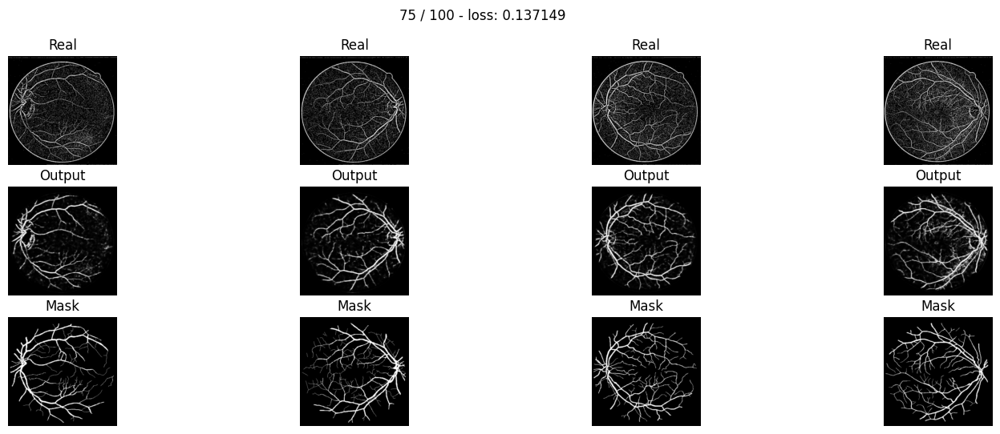

* Epoch 76/100
 - loss: 0.137284
tensor([[1.5085e-02, 8.6694e-04, 2.0725e-04,  ..., 2.2066e-03, 5.8739e-03,
         4.7309e-02],
        [1.0937e-03, 9.6506e-06, 1.0205e-06,  ..., 6.5180e-05, 3.0705e-04,
         9.6345e-03],
        [3.0295e-04, 1.3447e-06, 1.0323e-07,  ..., 2.2861e-05, 1.4532e-04,
         6.4573e-03],
        ...,
        [6.2610e-06, 1.5936e-09, 3.1338e-11,  ..., 1.1905e-07, 1.7563e-06,
         6.0557e-04],
        [5.7301e-05, 6.4139e-08, 2.8351e-09,  ..., 4.6394e-06, 4.2060e-05,
         3.6654e-03],
        [2.9306e-03, 5.6075e-05, 8.8417e-06,  ..., 1.3392e-03, 5.3423e-03,
         5.2540e-02]])
tensor([[1.4279e-02, 7.5840e-04, 1.7051e-04,  ..., 9.4435e-04, 2.7212e-03,
         3.0327e-02],
        [9.9177e-04, 7.6627e-06, 7.3150e-07,  ..., 1.1137e-05, 6.1706e-05,
         3.7874e-03],
        [3.0405e-04, 1.0981e-06, 5.5844e-08,  ..., 1.1884e-06, 1.0253e-05,
         1.5252e-03],
        ...,
        [5.9952e-06, 1.4868e-09, 2.8927e-11,  ..., 8.2670e-08, 1.37

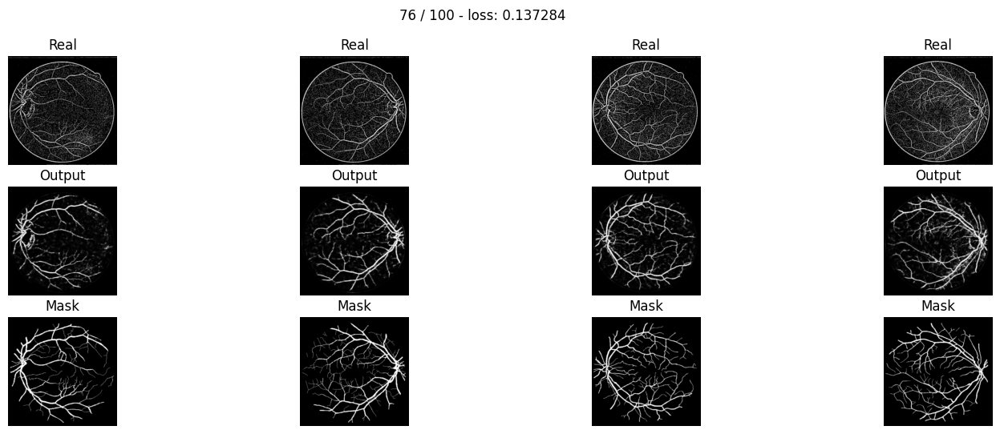

* Epoch 77/100
 - loss: 0.136648
tensor([[1.2407e-02, 6.2697e-04, 1.4000e-04,  ..., 1.7288e-03, 4.8534e-03,
         4.2720e-02],
        [7.8661e-04, 5.5950e-06, 5.3085e-07,  ..., 4.3512e-05, 2.2307e-04,
         8.0995e-03],
        [2.0029e-04, 6.8226e-07, 4.5732e-08,  ..., 1.3844e-05, 9.7919e-05,
         5.2066e-03],
        ...,
        [3.7742e-06, 6.9593e-10, 1.1632e-11,  ..., 6.1066e-08, 1.0351e-06,
         4.5399e-04],
        [3.8326e-05, 3.3101e-08, 1.2875e-09,  ..., 2.7330e-06, 2.7658e-05,
         2.9213e-03],
        [2.3029e-03, 3.7769e-05, 5.5124e-06,  ..., 9.7948e-04, 4.1821e-03,
         4.6324e-02]])
tensor([[1.1711e-02, 5.4602e-04, 1.1456e-04,  ..., 7.3337e-04, 2.2336e-03,
         2.7254e-02],
        [7.0990e-04, 4.4087e-06, 3.7725e-07,  ..., 7.3316e-06, 4.4378e-05,
         3.1646e-03],
        [1.9993e-04, 5.5196e-07, 2.4446e-08,  ..., 7.0400e-07, 6.7937e-06,
         1.2182e-03],
        ...,
        [3.6107e-06, 6.4842e-10, 1.0720e-11,  ..., 4.2232e-08, 8.09

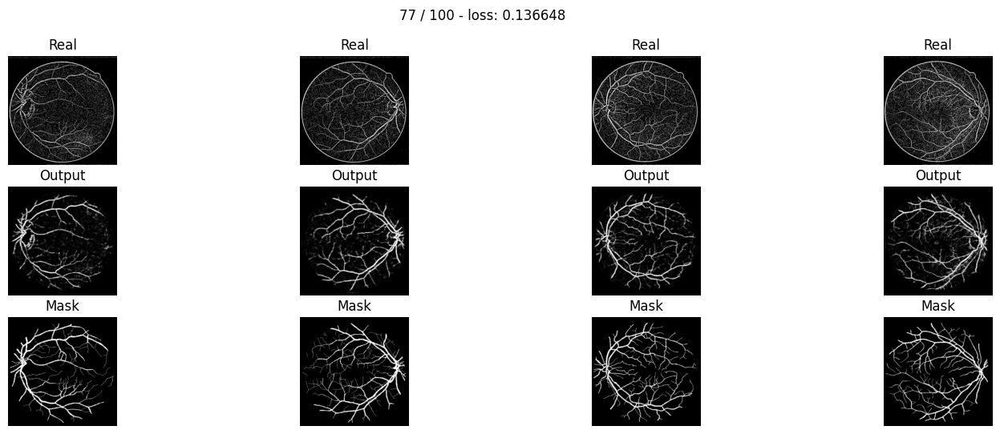

* Epoch 78/100
 - loss: 0.136488
tensor([[1.2673e-02, 6.5580e-04, 1.4837e-04,  ..., 1.8445e-03, 5.0993e-03,
         4.3749e-02],
        [8.2027e-04, 6.0954e-06, 5.9137e-07,  ..., 4.8791e-05, 2.4385e-04,
         8.4633e-03],
        [2.1138e-04, 7.6114e-07, 5.2586e-08,  ..., 1.6035e-05, 1.0977e-04,
         5.5096e-03],
        ...,
        [3.9181e-06, 7.5315e-10, 1.2756e-11,  ..., 6.0649e-08, 1.0271e-06,
         4.4896e-04],
        [3.9562e-05, 3.5406e-08, 1.3913e-09,  ..., 2.7252e-06, 2.7591e-05,
         2.9010e-03],
        [2.3378e-03, 3.9004e-05, 5.7240e-06,  ..., 9.7282e-04, 4.1603e-03,
         4.6075e-02]])
tensor([[1.1947e-02, 5.6978e-04, 1.2103e-04,  ..., 7.8728e-04, 2.3603e-03,
         2.8012e-02],
        [7.3843e-04, 4.7827e-06, 4.1827e-07,  ..., 8.3033e-06, 4.8965e-05,
         3.3257e-03],
        [2.1051e-04, 6.1289e-07, 2.7907e-08,  ..., 8.2034e-07, 7.6615e-06,
         1.2951e-03],
        ...,
        [3.7422e-06, 6.9988e-10, 1.1719e-11,  ..., 4.1736e-08, 8.00

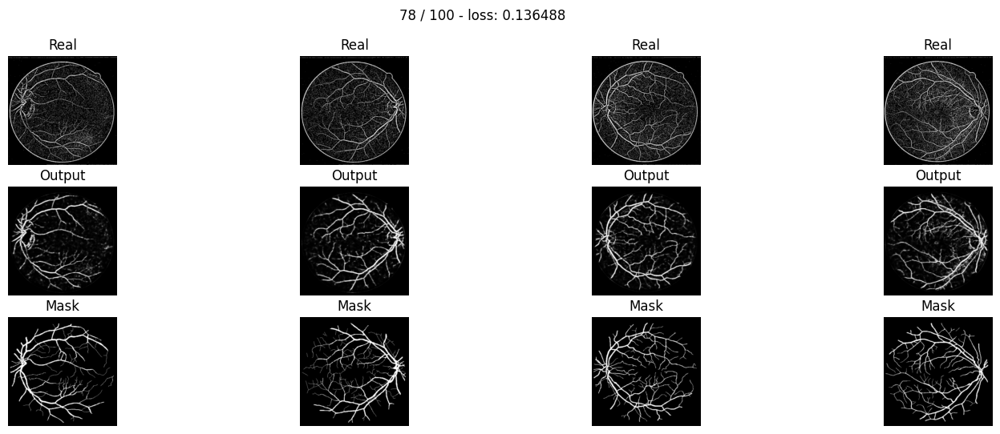

* Epoch 79/100
 - loss: 0.136344
tensor([[1.0549e-02, 4.8224e-04, 1.0172e-04,  ..., 1.3581e-03, 4.0129e-03,
         3.8476e-02],
        [6.0313e-04, 3.6411e-06, 3.1607e-07,  ..., 2.9382e-05, 1.6323e-04,
         6.8024e-03],
        [1.4370e-04, 4.0100e-07, 2.4119e-08,  ..., 8.5262e-06, 6.6712e-05,
         4.1965e-03],
        ...,
        [2.4421e-06, 3.4212e-10, 4.8792e-12,  ..., 2.5308e-08, 5.1357e-07,
         3.0777e-04],
        [2.7211e-05, 1.8892e-08, 6.4850e-10,  ..., 1.3650e-06, 1.5946e-05,
         2.1556e-03],
        [1.8690e-03, 2.6825e-05, 3.6286e-06,  ..., 6.4713e-04, 3.0227e-03,
         3.9046e-02]])
tensor([[9.9104e-03, 4.1669e-04, 8.2420e-05,  ..., 5.6889e-04, 1.8300e-03,
         2.4397e-02],
        [5.3998e-04, 2.8313e-06, 2.2121e-07,  ..., 4.8520e-06, 3.2012e-05,
         2.6362e-03],
        [1.4226e-04, 3.1949e-07, 1.2619e-08,  ..., 4.1839e-07, 4.5042e-06,
         9.6810e-04],
        ...,
        [2.3301e-06, 3.1750e-10, 4.4765e-12,  ..., 1.7343e-08, 3.99

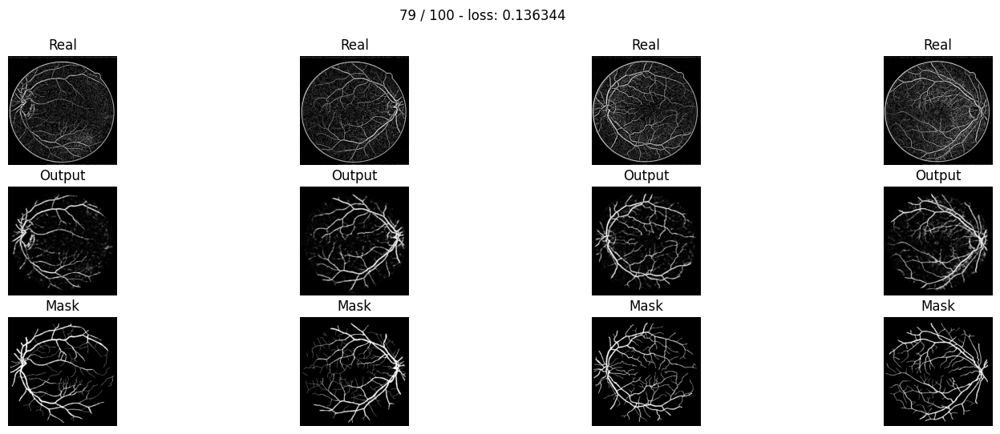

* Epoch 80/100
 - loss: 0.136347
tensor([[1.1437e-02, 5.6032e-04, 1.2313e-04,  ..., 1.6411e-03, 4.6458e-03,
         4.1481e-02],
        [6.9637e-04, 4.7495e-06, 4.4099e-07,  ..., 4.0611e-05, 2.1047e-04,
         7.7669e-03],
        [1.7256e-04, 5.6092e-07, 3.6820e-08,  ..., 1.2846e-05, 9.1992e-05,
         4.9655e-03],
        ...,
        [2.8303e-06, 4.5240e-10, 6.9091e-12,  ..., 3.5259e-08, 6.6668e-07,
         3.5181e-04],
        [3.0650e-05, 2.3720e-08, 8.5930e-10,  ..., 1.7870e-06, 1.9759e-05,
         2.4046e-03],
        [1.9979e-03, 3.0449e-05, 4.2523e-06,  ..., 7.5532e-04, 3.4152e-03,
         4.1464e-02]])
tensor([[1.0736e-02, 4.8341e-04, 9.9534e-05,  ..., 6.9607e-04, 2.1409e-03,
         2.6476e-02],
        [6.2256e-04, 3.6833e-06, 3.0757e-07,  ..., 6.8433e-06, 4.1976e-05,
         3.0400e-03],
        [1.7069e-04, 4.4568e-07, 1.9152e-08,  ..., 6.4223e-07, 6.3065e-06,
         1.1568e-03],
        ...,
        [2.6938e-06, 4.1801e-10, 6.3043e-12,  ..., 2.4008e-08, 5.16

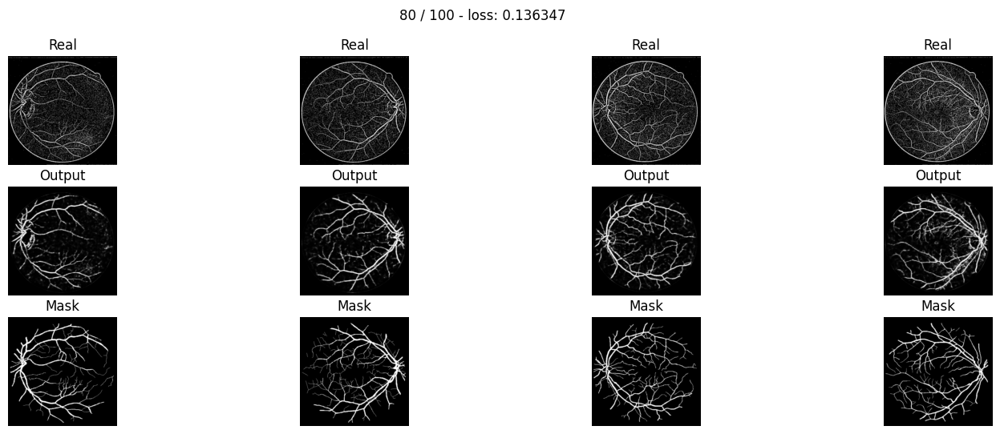

* Epoch 81/100
 - loss: 0.136131
tensor([[9.1386e-03, 3.8734e-04, 7.8620e-05,  ..., 1.2146e-03, 3.6895e-03,
         3.6718e-02],
        [4.7870e-04, 2.5642e-06, 2.1006e-07,  ..., 2.4820e-05, 1.4372e-04,
         6.3308e-03],
        [1.0767e-04, 2.5988e-07, 1.4585e-08,  ..., 6.9510e-06, 5.7250e-05,
         3.8460e-03],
        ...,
        [1.5961e-06, 1.7912e-10, 2.2888e-12,  ..., 1.7137e-08, 3.7982e-07,
         2.5971e-04],
        [1.9528e-05, 1.1403e-08, 3.5951e-10,  ..., 1.0169e-06, 1.2737e-05,
         1.9005e-03],
        [1.5261e-03, 1.9682e-05, 2.5276e-06,  ..., 5.4122e-04, 2.6424e-03,
         3.6338e-02]])
tensor([[8.5448e-03, 3.3214e-04, 6.3087e-05,  ..., 5.0725e-04, 1.6798e-03,
         2.3250e-02],
        [4.2521e-04, 1.9687e-06, 1.4482e-07,  ..., 4.0816e-06, 2.8129e-05,
         2.4510e-03],
        [1.0575e-04, 2.0406e-07, 7.4708e-09,  ..., 3.3585e-07, 3.8209e-06,
         8.8270e-04],
        ...,
        [1.5181e-06, 1.6537e-10, 2.0869e-12,  ..., 1.1589e-08, 2.92

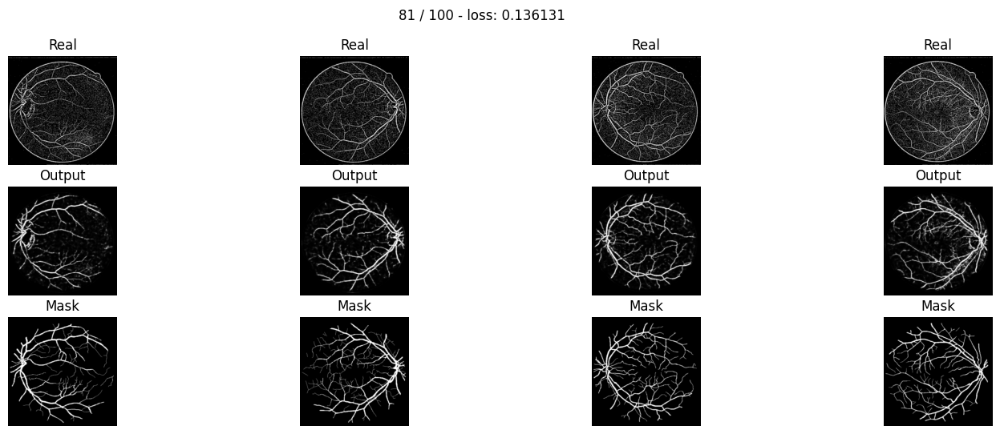

* Epoch 82/100
 - loss: 0.136408
tensor([[9.5689e-03, 4.2689e-04, 8.9628e-05,  ..., 1.4834e-03, 4.3164e-03,
         3.9847e-02],
        [5.2094e-04, 3.0584e-06, 2.6501e-07,  ..., 3.4892e-05, 1.8850e-04,
         7.3079e-03],
        [1.1977e-04, 3.2381e-07, 1.9527e-08,  ..., 1.0644e-05, 8.0342e-05,
         4.6042e-03],
        ...,
        [1.6306e-06, 1.9491e-10, 2.5924e-12,  ..., 2.3127e-08, 4.8383e-07,
         2.9484e-04],
        [1.9865e-05, 1.2226e-08, 3.9784e-10,  ..., 1.2955e-06, 1.5518e-05,
         2.1064e-03],
        [1.5329e-03, 2.0299e-05, 2.6539e-06,  ..., 6.1955e-04, 2.9476e-03,
         3.8390e-02]])
tensor([[8.9414e-03, 3.6570e-04, 7.1822e-05,  ..., 6.2508e-04, 1.9814e-03,
         2.5376e-02],
        [4.6208e-04, 2.3437e-06, 1.8230e-07,  ..., 5.8269e-06, 3.7405e-05,
         2.8542e-03],
        [1.1750e-04, 2.5366e-07, 9.9578e-09,  ..., 5.2164e-07, 5.4302e-06,
         1.0660e-03],
        ...,
        [1.5484e-06, 1.7946e-10, 2.3555e-12,  ..., 1.5540e-08, 3.71

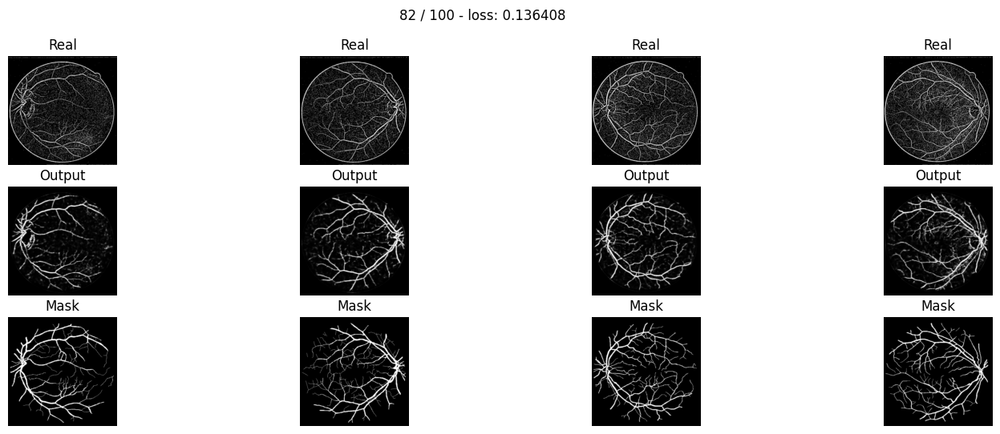

* Epoch 83/100
 - loss: 0.135586
tensor([[7.9717e-03, 3.1532e-04, 6.1771e-05,  ..., 1.0930e-03, 3.4031e-03,
         3.5063e-02],
        [3.8468e-04, 1.8468e-06, 1.4343e-07,  ..., 2.1111e-05, 1.2692e-04,
         5.8918e-03],
        [8.1787e-05, 1.7247e-07, 9.0622e-09,  ..., 5.6730e-06, 4.9017e-05,
         3.5132e-03],
        ...,
        [1.0387e-06, 9.2416e-11, 1.0426e-12,  ..., 9.7347e-09, 2.4456e-07,
         2.0332e-04],
        [1.3904e-05, 6.7578e-09, 1.9321e-10,  ..., 6.5278e-07, 9.0393e-06,
         1.5720e-03],
        [1.2359e-03, 1.4203e-05, 1.7163e-06,  ..., 4.1134e-04, 2.1405e-03,
         3.2501e-02]])
tensor([[7.4326e-03, 2.6934e-04, 4.9351e-05,  ..., 4.4875e-04, 1.5305e-03,
         2.2048e-02],
        [3.3989e-04, 1.4081e-06, 9.8202e-08,  ..., 3.3861e-06, 2.4408e-05,
         2.2603e-03],
        [7.9879e-05, 1.3426e-07, 4.5898e-09,  ..., 2.6391e-07, 3.1805e-06,
         7.9505e-04],
        ...,
        [9.8760e-07, 8.5285e-11, 9.5005e-13,  ..., 6.5247e-09, 1.87

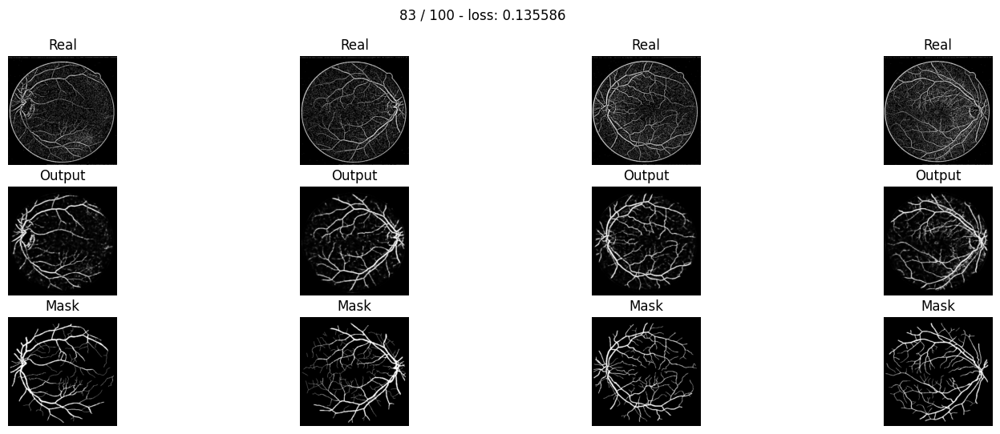

* Epoch 84/100
 - loss: 0.134714
tensor([[8.3918e-03, 3.4932e-04, 7.0730e-05,  ..., 1.2557e-03, 3.7654e-03,
         3.6809e-02],
        [4.2217e-04, 2.2200e-06, 1.8198e-07,  ..., 2.6707e-05, 1.5120e-04,
         6.4160e-03],
        [9.2303e-05, 2.1833e-07, 1.2312e-08,  ..., 7.6536e-06, 6.1270e-05,
         3.9203e-03],
        ...,
        [1.0877e-06, 1.0211e-10, 1.1812e-12,  ..., 1.0110e-08, 2.4926e-07,
         2.0308e-04],
        [1.4407e-05, 7.3111e-09, 2.1290e-10,  ..., 6.7205e-07, 9.1859e-06,
         1.5707e-03],
        [1.2570e-03, 1.4761e-05, 1.8026e-06,  ..., 4.1636e-04, 2.1525e-03,
         3.2433e-02]])
tensor([[7.8092e-03, 2.9734e-04, 5.6231e-05,  ..., 5.1720e-04, 1.6984e-03,
         2.3193e-02],
        [3.7189e-04, 1.6831e-06, 1.2371e-07,  ..., 4.3063e-06, 2.9210e-05,
         2.4679e-03],
        [8.9875e-05, 1.6885e-07, 6.1726e-09,  ..., 3.5642e-07, 3.9788e-06,
         8.8811e-04],
        ...,
        [1.0322e-06, 9.3925e-11, 1.0721e-12,  ..., 6.7202e-09, 1.89

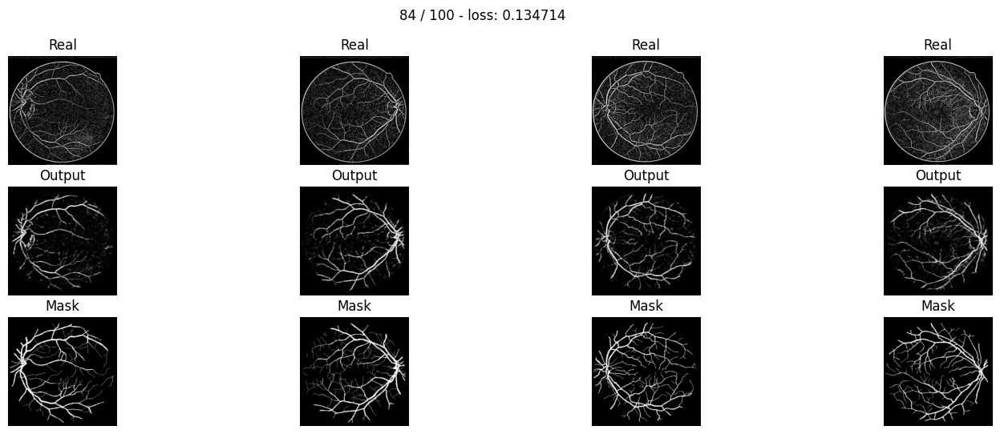

* Epoch 85/100
 - loss: 0.135602
tensor([[8.2126e-03, 3.3792e-04, 6.7754e-05,  ..., 1.1348e-03, 3.4842e-03,
         3.5293e-02],
        [4.0906e-04, 2.1148e-06, 1.7089e-07,  ..., 2.2790e-05, 1.3381e-04,
         6.0033e-03],
        [8.8567e-05, 2.0497e-07, 1.1352e-08,  ..., 6.2915e-06, 5.2696e-05,
         3.6090e-03],
        ...,
        [1.0105e-06, 9.1479e-11, 1.0255e-12,  ..., 7.7727e-09, 2.0325e-07,
         1.8131e-04],
        [1.3621e-05, 6.7321e-09, 1.9129e-10,  ..., 5.4769e-07, 7.8436e-06,
         1.4395e-03],
        [1.2105e-03, 1.3934e-05, 1.6743e-06,  ..., 3.6647e-04, 1.9515e-03,
         3.0800e-02]])
tensor([[7.6489e-03, 2.8828e-04, 5.4052e-05,  ..., 4.6714e-04, 1.5720e-03,
         2.2234e-02],
        [3.6074e-04, 1.6089e-06, 1.1682e-07,  ..., 3.6758e-06, 2.5900e-05,
         2.3114e-03],
        [8.6376e-05, 1.5913e-07, 5.7210e-09,  ..., 2.9173e-07, 3.4161e-06,
         8.1697e-04],
        ...,
        [9.5969e-07, 8.4273e-11, 9.3257e-13,  ..., 5.1570e-09, 1.54

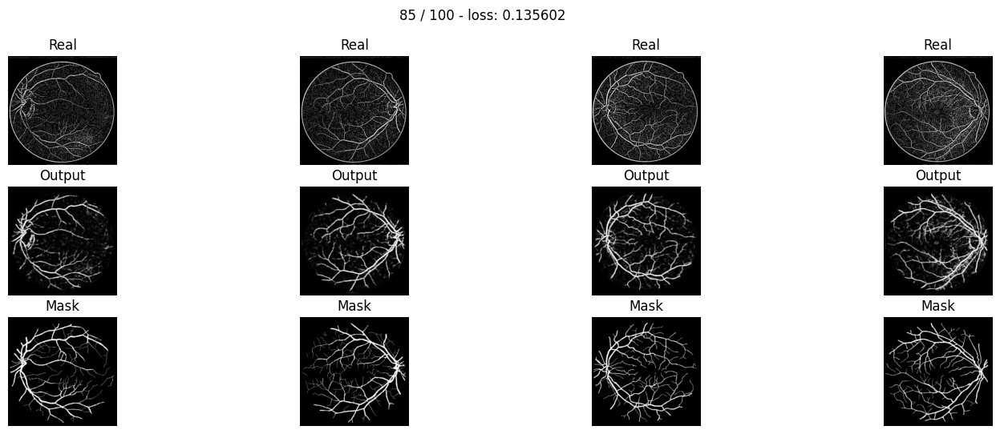

* Epoch 86/100
 - loss: 0.136105
tensor([[6.9410e-03, 2.5798e-04, 4.9140e-05,  ..., 9.1859e-04, 2.9380e-03,
         3.2105e-02],
        [3.0960e-04, 1.3520e-06, 1.0075e-07,  ..., 1.6137e-05, 1.0109e-04,
         5.1283e-03],
        [6.2647e-05, 1.1805e-07, 5.9156e-09,  ..., 4.1309e-06, 3.7484e-05,
         2.9790e-03],
        ...,
        [6.5556e-07, 4.5945e-11, 4.5599e-13,  ..., 4.9325e-09, 1.4126e-07,
         1.4814e-04],
        [9.6535e-06, 3.8839e-09, 1.0025e-10,  ..., 3.8167e-07, 5.8747e-06,
         1.2263e-03],
        [9.8425e-04, 1.0022e-05, 1.1370e-06,  ..., 2.9569e-04, 1.6454e-03,
         2.8110e-02]])
tensor([[6.4345e-03, 2.1851e-04, 3.8868e-05,  ..., 3.7313e-04, 1.3121e-03,
         2.0092e-02],
        [2.7101e-04, 1.0166e-06, 6.7975e-08,  ..., 2.5482e-06, 1.9250e-05,
         1.9553e-03],
        [6.0544e-05, 9.0284e-08, 2.9289e-09,  ..., 1.8572e-07, 2.3711e-06,
         6.6483e-04],
        ...,
        [6.2188e-07, 4.2250e-11, 4.1381e-13,  ..., 3.2516e-09, 1.07

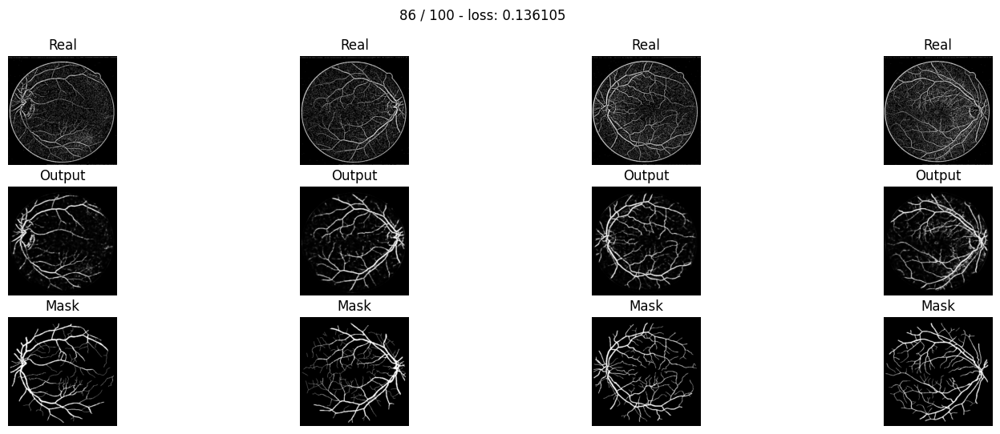

* Epoch 87/100
 - loss: 0.137275
tensor([[7.1022e-03, 2.7271e-04, 5.3149e-05,  ..., 1.0363e-03, 3.2319e-03,
         3.3755e-02],
        [3.2383e-04, 1.5010e-06, 1.1623e-07,  ..., 1.9891e-05, 1.1953e-04,
         5.6071e-03],
        [6.6321e-05, 1.3459e-07, 7.0866e-09,  ..., 5.3813e-06, 4.6305e-05,
         3.3347e-03],
        ...,
        [6.5336e-07, 4.7890e-11, 4.8991e-13,  ..., 6.2213e-09, 1.7080e-07,
         1.6377e-04],
        [9.6397e-06, 4.0298e-09, 1.0651e-10,  ..., 4.6146e-07, 6.8728e-06,
         1.3319e-03],
        [9.7876e-04, 1.0147e-05, 1.1663e-06,  ..., 3.2880e-04, 1.7949e-03,
         2.9390e-02]])
tensor([[6.5786e-03, 2.3080e-04, 4.2015e-05,  ..., 4.2520e-04, 1.4567e-03,
         2.1249e-02],
        [2.8302e-04, 1.1270e-06, 7.8372e-08,  ..., 3.1959e-06, 2.3135e-05,
         2.1592e-03],
        [6.3990e-05, 1.0273e-07, 3.5015e-09,  ..., 2.4607e-07, 2.9770e-06,
         7.5204e-04],
        ...,
        [6.1918e-07, 4.3962e-11, 4.4360e-13,  ..., 4.0873e-09, 1.29

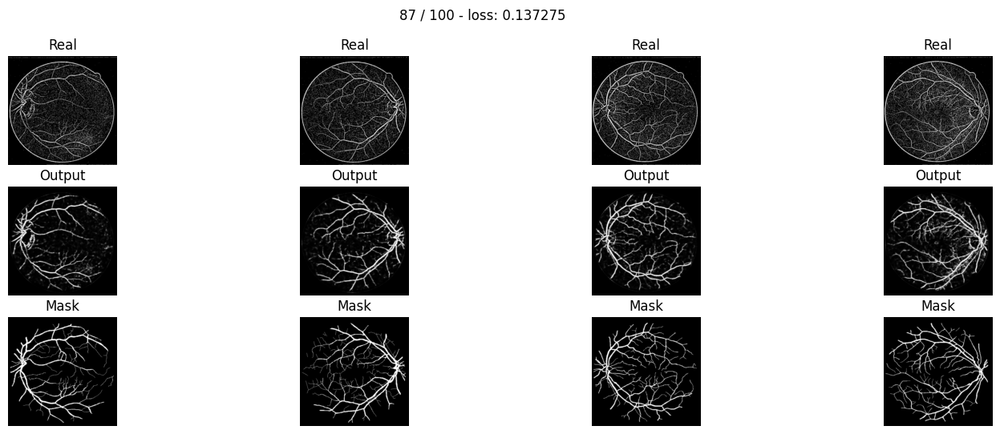

* Epoch 88/100
 - loss: 0.135572
tensor([[6.1285e-03, 2.1423e-04, 3.9439e-05,  ..., 7.8195e-04, 2.5984e-03,
         2.9990e-02],
        [2.5505e-04, 1.0138e-06, 7.1875e-08,  ..., 1.2655e-05, 8.3902e-05,
         4.6209e-03],
        [4.9197e-05, 8.2644e-08, 3.8980e-09,  ..., 3.0675e-06, 2.9843e-05,
         2.6190e-03],
        ...,
        [4.8411e-07, 2.9576e-11, 2.7172e-13,  ..., 3.5647e-09, 1.1052e-07,
         1.2894e-04],
        [7.6391e-06, 2.7696e-09, 6.7335e-11,  ..., 2.9978e-07, 4.9103e-06,
         1.1085e-03],
        [8.4972e-04, 8.0733e-06, 8.8150e-07,  ..., 2.5368e-04, 1.4685e-03,
         2.6434e-02]])
tensor([[5.6701e-03, 1.8107e-04, 3.1136e-05,  ..., 3.1860e-04, 1.1653e-03,
         1.8807e-02],
        [2.2238e-04, 7.5912e-07, 4.8353e-08,  ..., 2.0133e-06, 1.6135e-05,
         1.7724e-03],
        [4.7328e-05, 6.2824e-08, 1.9173e-09,  ..., 1.3806e-07, 1.8969e-06,
         5.8685e-04],
        ...,
        [4.5895e-07, 2.7175e-11, 2.4635e-13,  ..., 2.3380e-09, 8.35

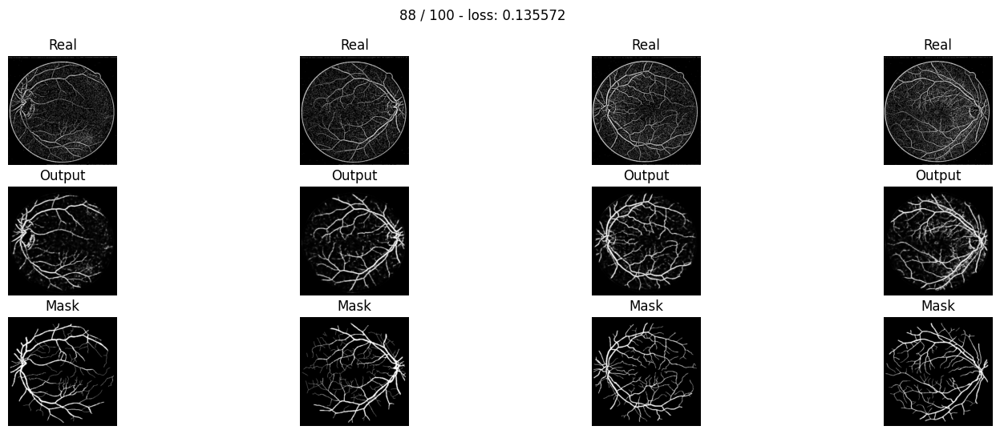

* Epoch 89/100
 - loss: 0.134751
tensor([[6.0782e-03, 2.1439e-04, 3.9892e-05,  ..., 7.9964e-04, 2.6123e-03,
         2.9861e-02],
        [2.5319e-04, 1.0261e-06, 7.4043e-08,  ..., 1.3139e-05, 8.4820e-05,
         4.5897e-03],
        [4.9144e-05, 8.4928e-08, 4.1099e-09,  ..., 3.2394e-06, 3.0447e-05,
         2.6078e-03],
        ...,
        [4.2609e-07, 2.4336e-11, 2.1592e-13,  ..., 2.7569e-09, 8.8390e-08,
         1.1252e-04],
        [6.8728e-06, 2.3547e-09, 5.5551e-11,  ..., 2.4407e-07, 4.1115e-06,
         9.9492e-04],
        [7.9511e-04, 7.2829e-06, 7.8074e-07,  ..., 2.2451e-04, 1.3225e-03,
         2.4856e-02]])
tensor([[5.6233e-03, 1.8116e-04, 3.1467e-05,  ..., 3.2538e-04, 1.1702e-03,
         1.8707e-02],
        [2.2090e-04, 7.6897e-07, 4.9846e-08,  ..., 2.0873e-06, 1.6293e-05,
         1.7585e-03],
        [4.7371e-05, 6.4697e-08, 2.0235e-09,  ..., 1.4500e-07, 1.9266e-06,
         5.8271e-04],
        ...,
        [4.0322e-07, 2.2289e-11, 1.9496e-13,  ..., 1.7930e-09, 6.64

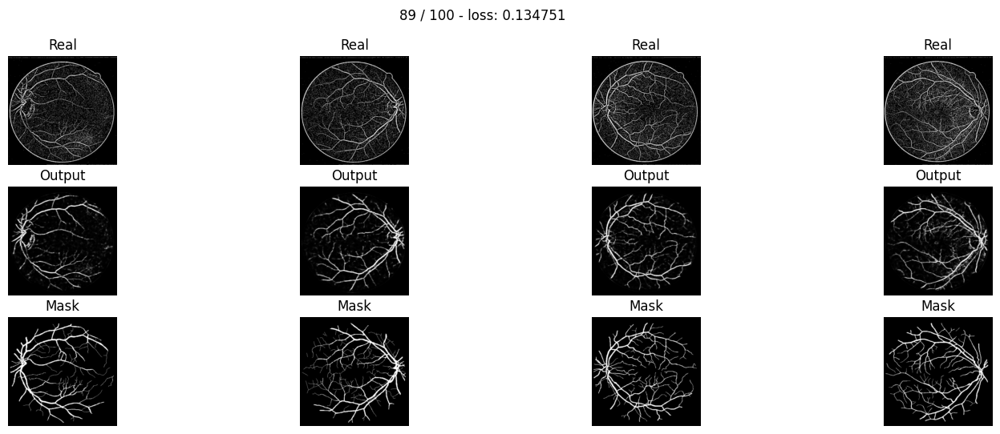

* Epoch 90/100
 - loss: 0.135407
tensor([[6.5214e-03, 2.4357e-04, 4.6626e-05,  ..., 8.6493e-04, 2.7899e-03,
         3.0922e-02],
        [2.8800e-04, 1.2946e-06, 9.8106e-08,  ..., 1.5234e-05, 9.6050e-05,
         4.9093e-03],
        [5.7826e-05, 1.1360e-07, 5.8540e-09,  ..., 3.9004e-06, 3.5558e-05,
         2.8355e-03],
        ...,
        [5.5755e-07, 3.8858e-11, 3.7534e-13,  ..., 3.5426e-09, 1.0861e-07,
         1.2527e-04],
        [8.5839e-06, 3.4750e-09, 8.7801e-11,  ..., 3.0213e-07, 4.9085e-06,
         1.0915e-03],
        [9.0499e-04, 9.1050e-06, 1.0160e-06,  ..., 2.5287e-04, 1.4588e-03,
         2.6132e-02]])
tensor([[6.0311e-03, 2.0572e-04, 3.6748e-05,  ..., 3.5654e-04, 1.2635e-03,
         1.9497e-02],
        [2.5096e-04, 9.6870e-07, 6.5911e-08,  ..., 2.4738e-06, 1.8802e-05,
         1.9013e-03],
        [5.5670e-05, 8.6329e-08, 2.8689e-09,  ..., 1.7852e-07, 2.2932e-06,
         6.4073e-04],
        ...,
        [5.2715e-07, 3.5537e-11, 3.3827e-13,  ..., 2.3050e-09, 8.16

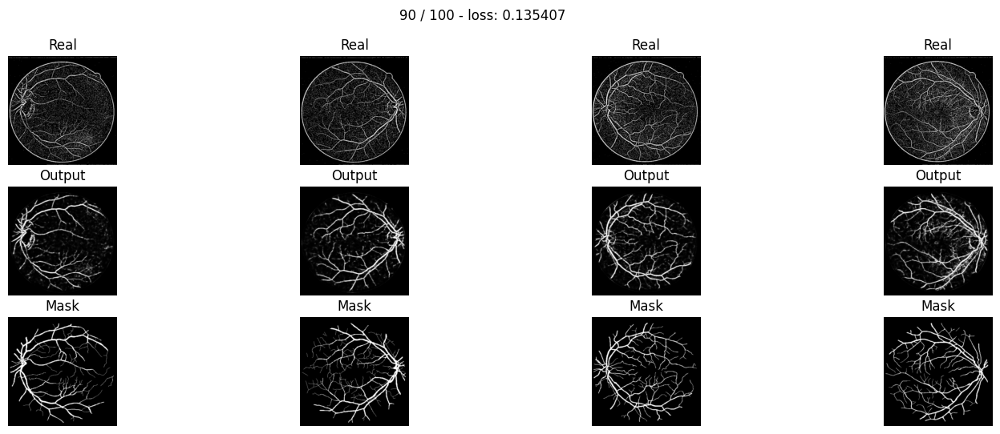

* Epoch 91/100
 - loss: 0.134227
tensor([[5.2938e-03, 1.7390e-04, 3.1026e-05,  ..., 6.2155e-04, 2.1470e-03,
         2.6761e-02],
        [2.0443e-04, 7.4245e-07, 5.0368e-08,  ..., 8.9208e-06, 6.2638e-05,
         3.8717e-03],
        [3.7690e-05, 5.6954e-08, 2.5547e-09,  ..., 2.0112e-06, 2.0978e-05,
         2.1132e-03],
        ...,
        [3.3920e-07, 1.7371e-11, 1.4234e-13,  ..., 1.6260e-09, 5.8579e-08,
         8.9119e-05],
        [5.7976e-06, 1.8351e-09, 4.0739e-11,  ..., 1.6390e-07, 3.0237e-06,
         8.3669e-04],
        [7.1452e-04, 6.2023e-06, 6.3990e-07,  ..., 1.7570e-04, 1.0956e-03,
         2.2439e-02]])
tensor([[4.8851e-03, 1.4646e-04, 2.4384e-05,  ..., 2.5332e-04, 9.6365e-04,
         1.6767e-02],
        [1.7748e-04, 5.5291e-07, 3.3690e-08,  ..., 1.4225e-06, 1.2091e-05,
         1.4867e-03],
        [3.6122e-05, 4.3010e-08, 1.2435e-09,  ..., 8.9665e-08, 1.3252e-06,
         4.7176e-04],
        ...,
        [3.2020e-07, 1.5846e-11, 1.2791e-13,  ..., 1.0518e-09, 4.38

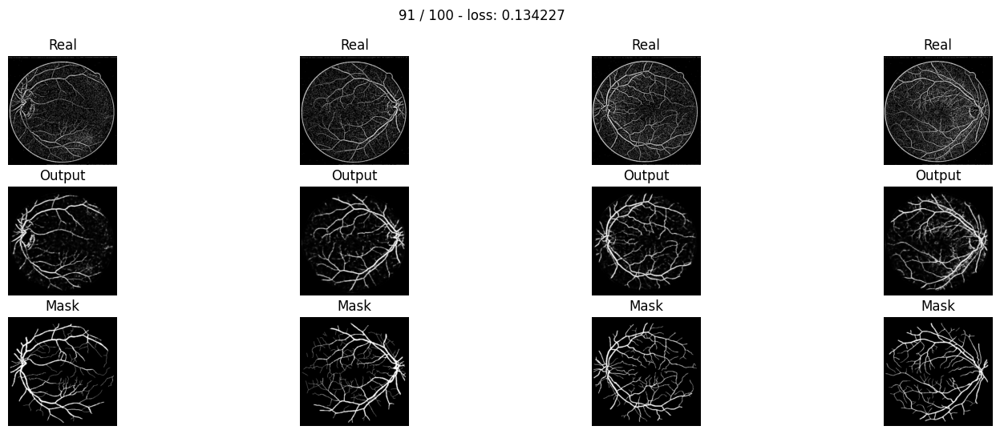

* Epoch 92/100
 - loss: 0.133943
tensor([[6.0858e-03, 2.2475e-04, 4.3245e-05,  ..., 9.1943e-04, 2.9103e-03,
         3.1450e-02],
        [2.6009e-04, 1.1579e-06, 8.8814e-08,  ..., 1.7148e-05, 1.0466e-04,
         5.0951e-03],
        [5.1201e-05, 9.9783e-08, 5.2400e-09,  ..., 4.5697e-06, 3.9919e-05,
         2.9850e-03],
        ...,
        [4.4884e-07, 2.9171e-11, 2.7435e-13,  ..., 3.3526e-09, 1.0333e-07,
         1.2022e-04],
        [7.2441e-06, 2.7825e-09, 6.8820e-11,  ..., 2.9137e-07, 4.7594e-06,
         1.0614e-03],
        [8.1258e-04, 7.8744e-06, 8.6661e-07,  ..., 2.4539e-04, 1.4225e-03,
         2.5639e-02]])
tensor([[5.6046e-03, 1.8861e-04, 3.3817e-05,  ..., 3.8139e-04, 1.3258e-03,
         1.9900e-02],
        [2.2505e-04, 8.5728e-07, 5.8945e-08,  ..., 2.8129e-06, 2.0691e-05,
         1.9843e-03],
        [4.8905e-05, 7.4809e-08, 2.5223e-09,  ..., 2.0980e-07, 2.5843e-06,
         6.7633e-04],
        ...,
        [4.2322e-07, 2.6558e-11, 2.4588e-13,  ..., 2.1605e-09, 7.72

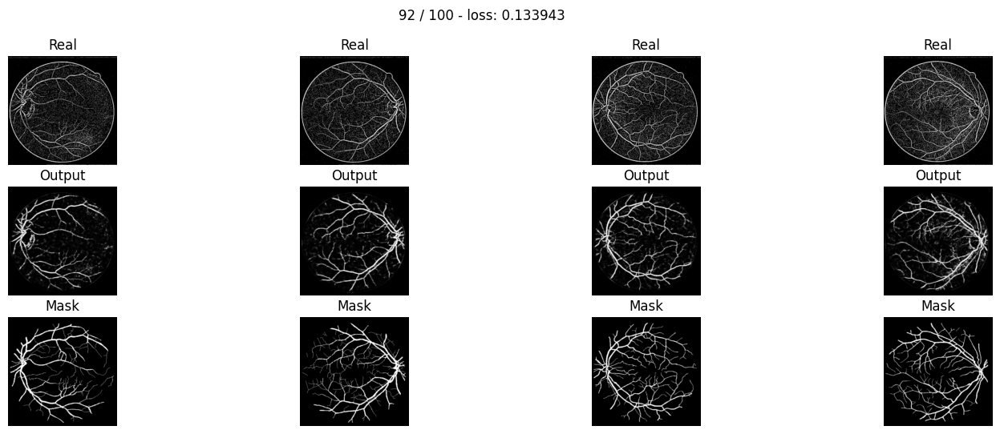

* Epoch 93/100
 - loss: 0.133424
tensor([[4.4060e-03, 1.3156e-04, 2.2352e-05,  ..., 5.1088e-04, 1.8394e-03,
         2.4513e-02],
        [1.5261e-04, 4.7614e-07, 3.0017e-08,  ..., 6.6080e-06, 4.9378e-05,
         3.3812e-03],
        [2.6194e-05, 3.2881e-08, 1.3485e-09,  ..., 1.3958e-06, 1.5713e-05,
         1.7907e-03],
        ...,
        [2.1205e-07, 8.5516e-12, 6.2120e-14,  ..., 9.9457e-10, 3.9723e-08,
         7.1368e-05],
        [4.0093e-06, 1.0526e-09, 2.1275e-11,  ..., 1.1227e-07, 2.2472e-06,
         7.0657e-04],
        [5.6919e-04, 4.3951e-06, 4.2798e-07,  ..., 1.3917e-04, 9.1316e-04,
         2.0303e-02]])
tensor([[4.0523e-03, 1.1026e-04, 1.7462e-05,  ..., 2.0858e-04, 8.2785e-04,
         1.5376e-02],
        [1.3169e-04, 3.5141e-07, 1.9873e-08,  ..., 1.0574e-06, 9.5836e-06,
         1.3026e-03],
        [2.4919e-05, 2.4519e-08, 6.4554e-10,  ..., 6.1959e-08, 9.9163e-07,
         3.9985e-04],
        ...,
        [1.9968e-07, 7.7693e-12, 5.5538e-14,  ..., 6.3984e-10, 2.96

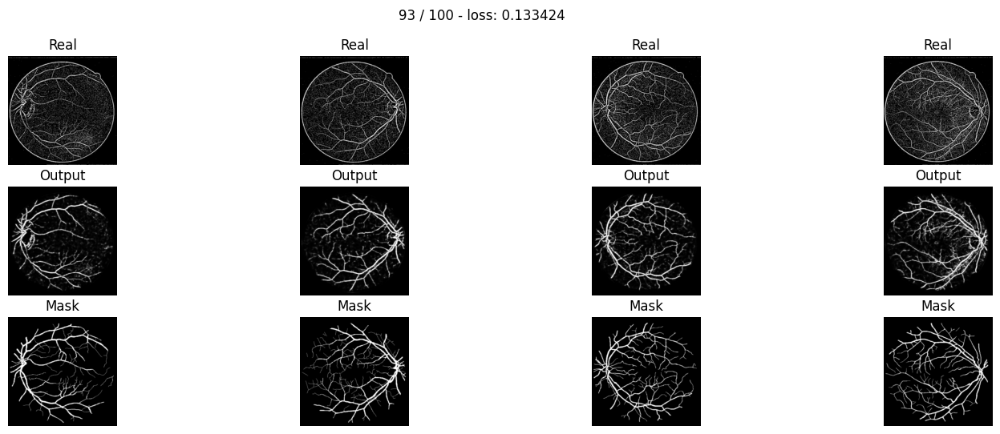

* Epoch 94/100
 - loss: 0.133885
tensor([[5.1899e-03, 1.7661e-04, 3.2581e-05,  ..., 8.2041e-04, 2.6532e-03,
         2.9782e-02],
        [2.0186e-04, 7.8948e-07, 5.6842e-08,  ..., 1.4476e-05, 9.1166e-05,
         4.6925e-03],
        [3.7363e-05, 6.2176e-08, 3.0239e-09,  ..., 3.7286e-06, 3.3834e-05,
         2.7025e-03],
        ...,
        [2.9570e-07, 1.5601e-11, 1.3213e-13,  ..., 2.3036e-09, 7.6512e-08,
         1.0085e-04],
        [5.2213e-06, 1.7041e-09, 3.8857e-11,  ..., 2.1862e-07, 3.7900e-06,
         9.2945e-04],
        [6.6418e-04, 5.8131e-06, 6.0867e-07,  ..., 2.0557e-04, 1.2372e-03,
         2.3714e-02]])
tensor([[4.7711e-03, 1.4787e-04, 2.5406e-05,  ..., 3.3935e-04, 1.2072e-03,
         1.8826e-02],
        [1.7413e-04, 5.8204e-07, 3.7560e-08,  ..., 2.3639e-06, 1.7995e-05,
         1.8259e-03],
        [3.5570e-05, 4.6335e-08, 1.4430e-09,  ..., 1.6879e-07, 2.1695e-06,
         6.0934e-04],
        ...,
        [2.7818e-07, 1.4152e-11, 1.1790e-13,  ..., 1.4704e-09, 5.68

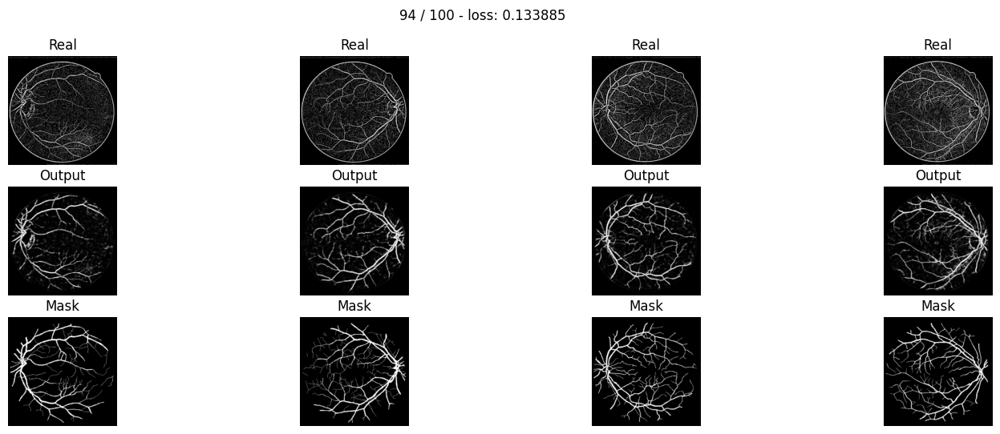

* Epoch 95/100
 - loss: 0.133906
tensor([[3.9381e-03, 1.1148e-04, 1.8432e-05,  ..., 4.9952e-04, 1.8012e-03,
         2.4128e-02],
        [1.2831e-04, 3.6926e-07, 2.2383e-08,  ..., 6.4780e-06, 4.8407e-05,
         3.3206e-03],
        [2.1220e-05, 2.4227e-08, 9.5029e-10,  ..., 1.3785e-06, 1.5485e-05,
         1.7608e-03],
        ...,
        [1.7593e-07, 6.6243e-12, 4.6405e-14,  ..., 8.9611e-10, 3.6329e-08,
         6.7025e-05],
        [3.4909e-06, 8.7448e-10, 1.7227e-11,  ..., 1.0473e-07, 2.1200e-06,
         6.7699e-04],
        [5.2322e-04, 3.9190e-06, 3.7611e-07,  ..., 1.3326e-04, 8.8073e-04,
         1.9806e-02]])
tensor([[3.6125e-03, 9.3068e-05, 1.4328e-05,  ..., 2.0309e-04, 8.0871e-04,
         1.5112e-02],
        [1.1028e-04, 2.7089e-07, 1.4716e-08,  ..., 1.0298e-06, 9.3610e-06,
         1.2764e-03],
        [2.0110e-05, 1.7930e-08, 4.4985e-10,  ..., 6.0214e-08, 9.6564e-07,
         3.9058e-04],
        ...,
        [1.6519e-07, 5.9910e-12, 4.1264e-14,  ..., 5.7139e-10, 2.69

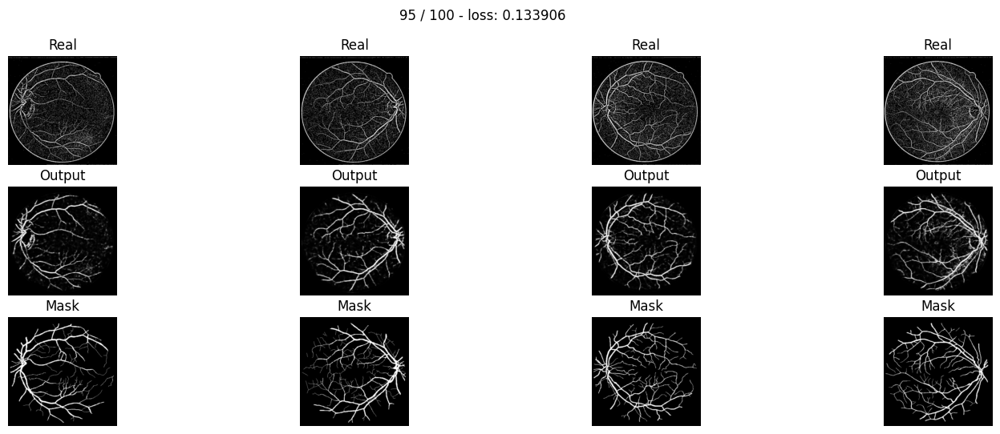

* Epoch 96/100
 - loss: 0.132829
tensor([[4.1267e-03, 1.2176e-04, 2.0660e-05,  ..., 5.5891e-04, 1.9663e-03,
         2.5274e-02],
        [1.3950e-04, 4.3218e-07, 2.7337e-08,  ..., 7.8605e-06, 5.6407e-05,
         3.6022e-03],
        [2.3625e-05, 2.9591e-08, 1.2272e-09,  ..., 1.7686e-06, 1.8851e-05,
         1.9560e-03],
        ...,
        [2.0168e-07, 8.4917e-12, 6.2939e-14,  ..., 1.1320e-09, 4.3656e-08,
         7.3643e-05],
        [3.9067e-06, 1.0747e-09, 2.2149e-11,  ..., 1.2650e-07, 2.4626e-06,
         7.3064e-04],
        [5.5898e-04, 4.4158e-06, 4.3560e-07,  ..., 1.4866e-04, 9.5967e-04,
         2.0677e-02]])
tensor([[3.7799e-03, 1.0143e-04, 1.6020e-05,  ..., 2.2842e-04, 8.8717e-04,
         1.5880e-02],
        [1.1964e-04, 3.1597e-07, 1.7906e-08,  ..., 1.2599e-06, 1.0993e-05,
         1.3908e-03],
        [2.2329e-05, 2.1797e-08, 5.7733e-10,  ..., 7.7664e-08, 1.1817e-06,
         4.3531e-04],
        ...,
        [1.8916e-07, 7.6641e-12, 5.5811e-14,  ..., 7.1973e-10, 3.23

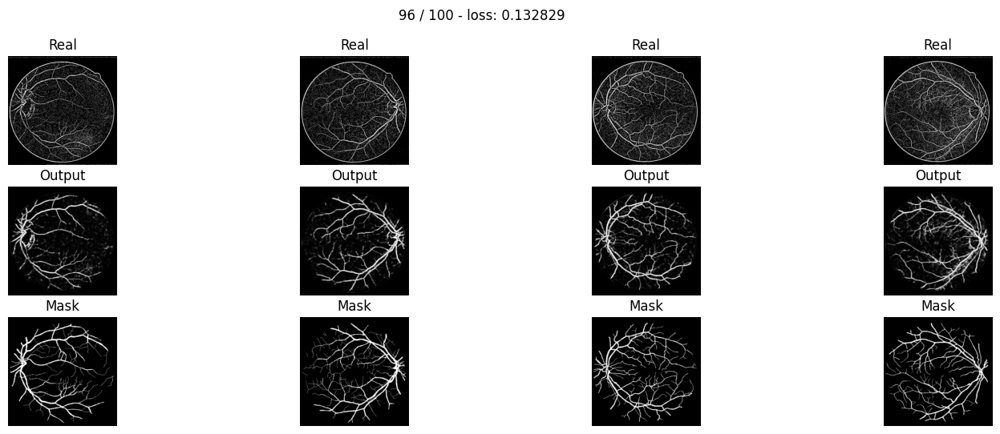

* Epoch 97/100
 - loss: 0.132701
tensor([[3.3988e-03, 8.8874e-05, 1.4086e-05,  ..., 4.1190e-04, 1.5426e-03,
         2.2077e-02],
        [1.0164e-04, 2.5777e-07, 1.4652e-08,  ..., 4.8011e-06, 3.8002e-05,
         2.8877e-03],
        [1.5932e-05, 1.5613e-08, 5.6686e-10,  ..., 9.6281e-07, 1.1595e-05,
         1.4890e-03],
        ...,
        [1.2430e-07, 3.8608e-12, 2.4280e-14,  ..., 5.2478e-10, 2.3628e-08,
         5.2293e-05],
        [2.6643e-06, 5.7473e-10, 1.0407e-11,  ..., 6.8921e-08, 1.5164e-06,
         5.5811e-04],
        [4.4376e-04, 3.0295e-06, 2.7636e-07,  ..., 1.0344e-04, 7.1974e-04,
         1.7700e-02]])
tensor([[3.1049e-03, 7.3754e-05, 1.0875e-05,  ..., 1.6555e-04, 6.8710e-04,
         1.3759e-02],
        [8.6808e-05, 1.8731e-07, 9.5316e-09,  ..., 7.4941e-07, 7.2565e-06,
         1.1018e-03],
        [1.4980e-05, 1.1407e-08, 2.6410e-10,  ..., 4.0803e-08, 7.0678e-07,
         3.2613e-04],
        ...,
        [1.1635e-07, 3.4732e-12, 2.1444e-14,  ..., 3.3199e-10, 1.74

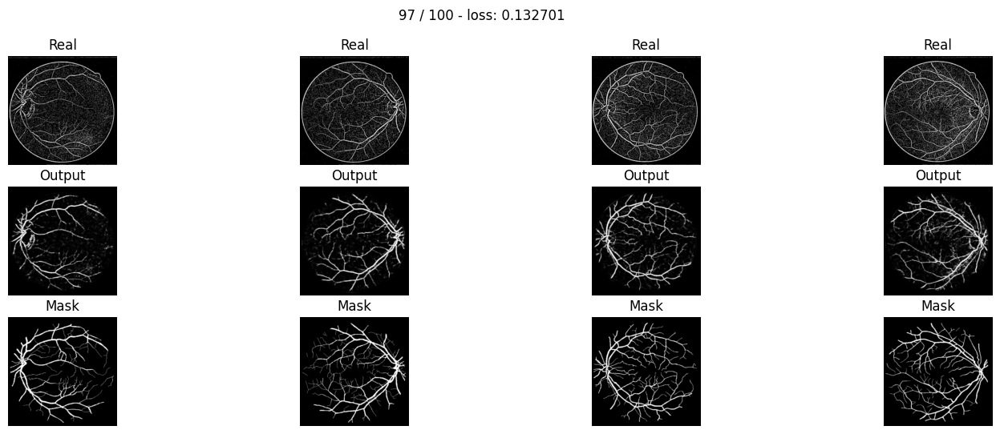

* Epoch 98/100
 - loss: 0.132706
tensor([[3.4806e-03, 9.3518e-05, 1.5055e-05,  ..., 4.4501e-04, 1.6389e-03,
         2.2768e-02],
        [1.0637e-04, 2.8350e-07, 1.6550e-08,  ..., 5.5087e-06, 4.2379e-05,
         3.0544e-03],
        [1.6838e-05, 1.7520e-08, 6.5792e-10,  ..., 1.1439e-06, 1.3281e-05,
         1.5966e-03],
        ...,
        [1.1621e-07, 3.5381e-12, 2.1855e-14,  ..., 5.0684e-10, 2.3006e-08,
         5.1187e-05],
        [2.5257e-06, 5.3679e-10, 9.5784e-12,  ..., 6.7219e-08, 1.4902e-06,
         5.4993e-04],
        [4.2730e-04, 2.8765e-06, 2.5969e-07,  ..., 1.0106e-04, 7.0761e-04,
         1.7497e-02]])
tensor([[3.1791e-03, 7.7605e-05, 1.1622e-05,  ..., 1.7981e-04, 7.3373e-04,
         1.4235e-02],
        [9.0844e-05, 2.0603e-07, 1.0768e-08,  ..., 8.6723e-07, 8.1592e-06,
         1.1711e-03],
        [1.5833e-05, 1.2799e-08, 3.0625e-10,  ..., 4.8751e-08, 8.1433e-07,
         3.5103e-04],
        ...,
        [1.0878e-07, 3.1830e-12, 1.9301e-14,  ..., 3.2052e-10, 1.69

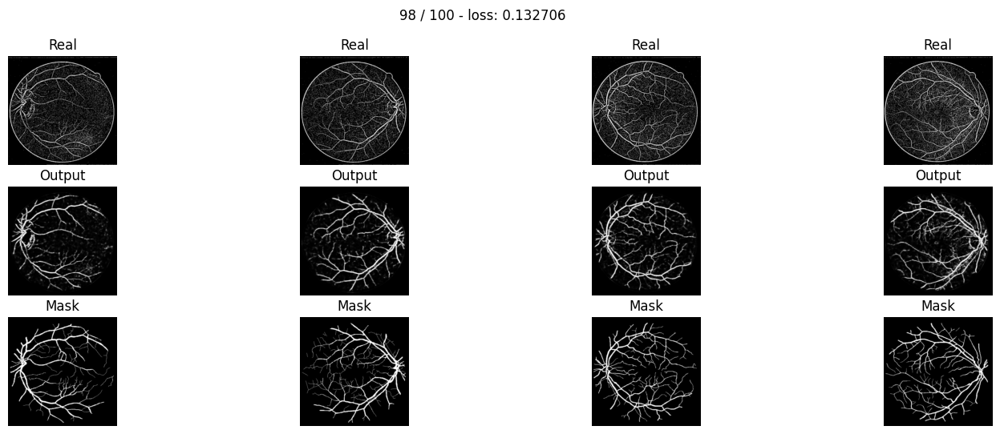

* Epoch 99/100
 - loss: 0.132873
tensor([[3.1774e-03, 8.1396e-05, 1.2765e-05,  ..., 4.1354e-04, 1.5459e-03,
         2.2000e-02],
        [9.1988e-05, 2.2716e-07, 1.2745e-08,  ..., 4.9347e-06, 3.8811e-05,
         2.8999e-03],
        [1.4032e-05, 1.3287e-08, 4.7514e-10,  ..., 1.0001e-06, 1.1933e-05,
         1.4984e-03],
        ...,
        [8.2904e-08, 2.0829e-12, 1.1609e-14,  ..., 3.5790e-10, 1.7495e-08,
         4.3848e-05],
        [1.9319e-06, 3.5214e-10, 5.7928e-12,  ..., 5.1253e-08, 1.2056e-06,
         4.8810e-04],
        [3.6237e-04, 2.2191e-06, 1.9056e-07,  ..., 8.5622e-05, 6.2227e-04,
         1.6310e-02]])
tensor([[2.8992e-03, 6.7435e-05, 9.8315e-06,  ..., 1.6674e-04, 6.9108e-04,
         1.3741e-02],
        [7.8446e-05, 1.6468e-07, 8.2644e-09,  ..., 7.7389e-07, 7.4524e-06,
         1.1100e-03],
        [1.3177e-05, 9.6771e-09, 2.2000e-10,  ..., 4.2237e-08, 7.2632e-07,
         3.2807e-04],
        ...,
        [7.7512e-08, 1.8704e-12, 1.0230e-14,  ..., 2.2492e-10, 1.28

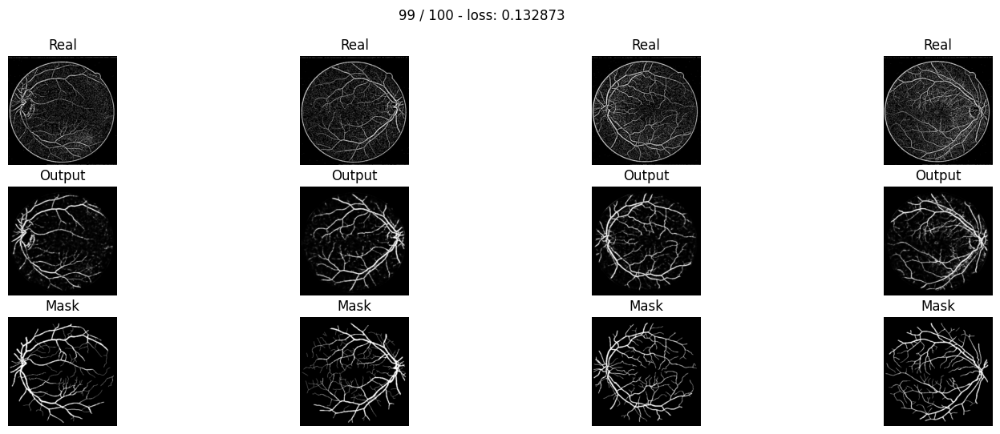

* Epoch 100/100
 - loss: 0.133441
tensor([[3.8331e-03, 1.1251e-04, 1.9094e-05,  ..., 5.8041e-04, 2.0156e-03,
         2.5379e-02],
        [1.2625e-04, 3.9359e-07, 2.5071e-08,  ..., 8.6786e-06, 6.0634e-05,
         3.6912e-03],
        [2.0867e-05, 2.6343e-08, 1.1063e-09,  ..., 2.0278e-06, 2.0828e-05,
         2.0264e-03],
        ...,
        [1.1854e-07, 3.8601e-12, 2.4499e-14,  ..., 6.6086e-10, 2.8483e-08,
         5.6920e-05],
        [2.5682e-06, 5.7769e-10, 1.0521e-11,  ..., 8.3791e-08, 1.7859e-06,
         6.0184e-04],
        [4.2800e-04, 2.9558e-06, 2.6968e-07,  ..., 1.1406e-04, 7.8159e-04,
         1.8372e-02]])
tensor([[3.4929e-03, 9.3009e-05, 1.4663e-05,  ..., 2.3777e-04, 9.1302e-04,
         1.5985e-02],
        [1.0747e-04, 2.8447e-07, 1.6193e-08,  ..., 1.3954e-06, 1.1886e-05,
         1.4295e-03],
        [1.9566e-05, 1.9121e-08, 5.0935e-10,  ..., 8.7801e-08, 1.2940e-06,
         4.4900e-04],
        ...,
        [1.1072e-07, 3.4602e-12, 2.1539e-14,  ..., 4.1349e-10, 2.0

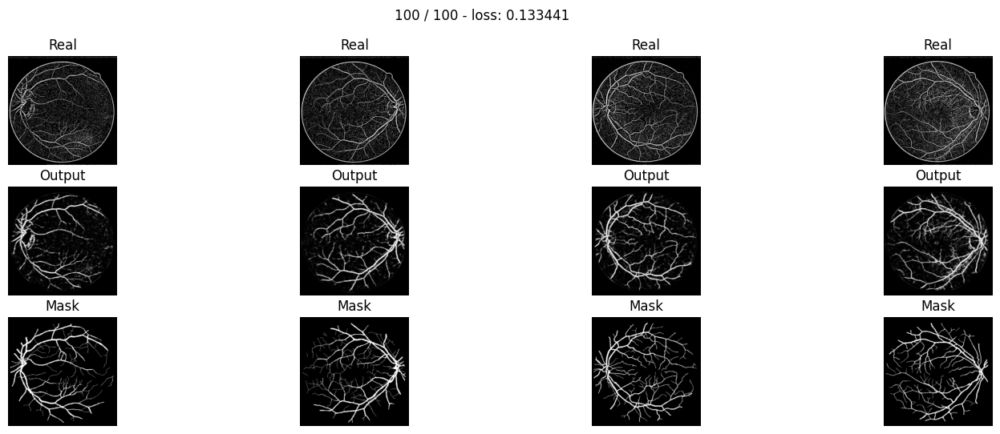

In [19]:
torch.cuda.empty_cache()
train(model, optim.Adam(model.parameters()), bce_loss, 100, train_loader, test_loader)

4
4
4
4
tensor([[2.9400e-03, 6.9353e-05, 1.0192e-05,  ..., 5.1861e-04, 1.8825e-03,
         2.4796e-02],
        [8.0013e-05, 1.6786e-07, 8.2949e-09,  ..., 6.8168e-06, 5.2109e-05,
         3.4955e-03],
        [1.2282e-05, 9.1905e-09, 2.3885e-10,  ..., 1.3627e-06, 1.6725e-05,
         1.8685e-03],
        ...,
        [1.0975e-07, 3.4047e-12, 2.1090e-14,  ..., 3.0873e-10, 1.6143e-08,
         4.2038e-05],
        [2.4176e-06, 5.2329e-10, 9.3529e-12,  ..., 4.4754e-08, 9.0568e-07,
         3.7830e-04],
        [4.1287e-04, 2.7879e-06, 2.5151e-07,  ..., 7.7762e-05, 4.3180e-04,
         1.1732e-02]])
tensor([[4.3477e-03, 1.3680e-04, 2.3464e-05,  ..., 6.0032e-04, 2.0659e-03,
         2.5699e-02],
        [1.6292e-04, 5.7633e-07, 3.7380e-08,  ..., 9.1631e-06, 6.3108e-05,
         3.7672e-03],
        [3.5793e-05, 5.6559e-08, 2.1105e-09,  ..., 2.1681e-06, 2.1874e-05,
         2.0778e-03],
        ...,
        [1.9753e-07, 8.8691e-12, 6.6112e-14,  ..., 5.0921e-10, 2.4571e-08,
         5.4633e-

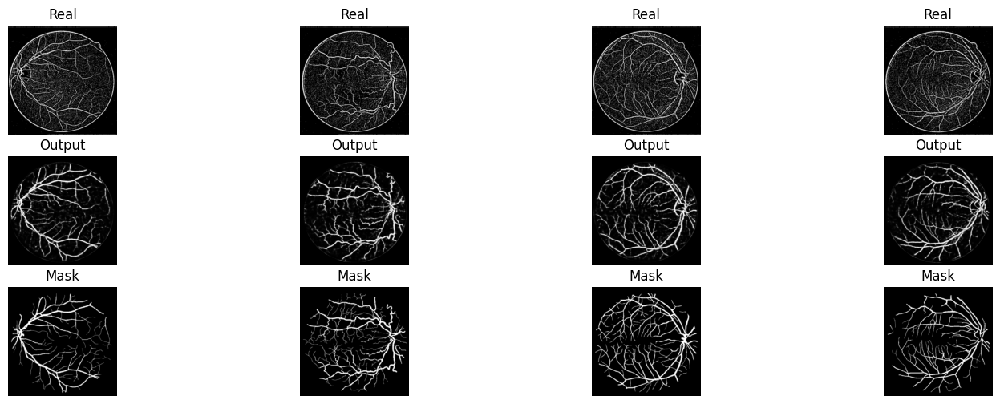

0.9986228942871094


In [45]:
from torchmetrics.classification import Dice
X_valid, Y_valid = next(iter(valid_loader))
preds = []
dice_score = 0
dice = Dice(average='micro')


# show intermediate results
model.eval()  # testing mode
Y_hat = F.sigmoid(model(X_valid.to(device))).detach().cpu()
for x,y in zip(Y_hat, X_valid):
    # y[y>=0.5]=1
    # y[y<0.5]=0
    print(len(Y_hat.shape))
    # print(dice(y, x).item())
    dice_score += dice(y.type(torch.int64), x.type(torch.int64)).item() / len(Y_hat.shape)

# clear_output(wait=True)
for k in range(4):
    plt.subplot(3, 4, k+1)
    plt.imshow(np.rollaxis(X_valid[k].numpy(), 0, 3), cmap='gray')
    plt.title('Real')
    plt.axis('off')

    plt.subplot(3, 4, k+5)
    # Y_hat[k, 0][Y_hat[k, 0]>=0.5] = 1
    # Y_hat[k, 0][Y_hat[k, 0]<0.5] = 0
    plt.imshow(Y_hat[k, 0], cmap='gray')
    plt.title('Output')
    plt.axis('off')
    print(Y_hat[k, 0])

    plt.subplot(3, 4, k+9)
    plt.imshow(Y_valid[k, 0], cmap='gray')
    plt.title('Mask')
    plt.axis('off')
plt.show()

    
print(dice_score)

---------------------------------------------------------------------------------------------------

So far, we have been using **Max-Pooling** for the downsampling and **nearest-neighbor Upsampling** for the upsampling.

Down-sampling:

        conv = nn.Conv2d(3, 64, 3, padding=1)
        pool = nn.MaxPool2d(3, 2, padding=1)

Up-Sampling

        upsample = nn.Upsample(32)
        conv = nn.Conv2d(64, 64, 3, padding=1)

As been discussed last week, downsample can also be done with stride=2, and upsample with stride=1/2. This generally works better than using max-pooling and upsample.

<div style="border-left: solid 6px #d6d6d6; padding: 10px; background-color: #eaeaea">
<b><i>Exercise:</i></b> Replace max-pooling by convolutions with stride=2, and replace upsampling by transpose-convolutions also with stride=2.
</div>

In [ ]:
class UNet2:
    ....
    ....

In [ ]:
model = UNet2().to(device)
summary(model, (3, 256, 256))

In [ ]:
train(model, optim.Adam(model.parameters()), bce_loss, 20, train_loader, test_loader)

# Dilated convolutions

We have been using encoder-decoder architectures, which are the most popular. But other architectures exist. For example, we could have used so-called **dilated convolutions** as an alternative to downsampling via pooling or striding

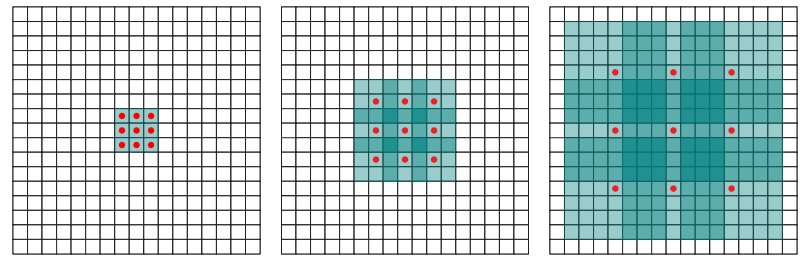

In the first layer, we use dilation=1, the second layer uses dilation=2, and so on, until a good part of the receptive field is reached.

* Yu, Fisher, and Vladlen Koltun. "[Multi-scale context aggregation by dilated convolutions.](https://arxiv.org/pdf/1511.07122.pdf)" arXiv preprint arXiv:1511.07122 (2015).

<div style="border-left: solid 6px #d6d6d6; padding: 10px; background-color: #eaeaea">
<b><i>Exercise:</i></b> Copy the encoder decoder network and implement a <tt>DilatedNet</tt> using dilated filters instead of down-sampling and up-sampling.
</div>

In [ ]:
class DilatedNet:
    ....
    ....

In [ ]:
model = DilatedNet().to(device)
summary(model, (3, 256, 256))

In [ ]:
train(model, optim.Adam(model.parameters()), bce_loss, 20, train_loader, test_loader)

---------------------------------------------------------------------------------------------------------

# Multi-class Segmentation

1. Use the [CMP-Facade dataset](http://cmp.felk.cvut.cz/~tylecr1/facade/) that you find at 

    /dtu/datasets1/02516/CMP_facade_DB_base

2. Load the dataset. There are 12 classes, therefore, each segmentation will have the shape $12\times H\times W$. 
3. Copy over one of the previous models and adapt for multi-class segmentation. The most important change is the to *loss function.* Feel free to use [this pytorch loss](https://pytorch.org/docs/stable/generated/torch.nn.CrossEntropyLoss.html#torch.nn.CrossEntropyLoss) which implements softmax-crossentropy.

Load:

Model:

Training:

-----------------------------------------------------------------------------------------

# Further Thoughts

1. Especially when there is little data, **transfer-learning** can also be used for segmentation. A popular approach is to replace the encoder part of the U-Net by the convolutional part of VGG-16.
2. **Data augmentation** can also be used to improve segmentation quality. Special care must be taken because (i) some augmentation is symmetric and must be applied in pairs like rotation, and (ii) some augmentation is asymmetric like brightness.
3. We have covered here *semantic* segmentation. What could we have done differently for *instance* segmentation?